# Background

# Imports

In [494]:
import os
from copy import deepcopy
import numpy as np
import pandas as pd
import lmfit as lm
from dateutil import parser
from collections.abc import Iterable
from scipy.spatial.transform import Rotation
#from scipy.special import sph_harm # deprecated
from scipy.special import sph_harm_y
#import pickle as pkl
import dill as pkl # better for pickling complex classes
from scipy.interpolate import interp1d

from plotly import graph_objects as go
from plotly.offline import plot, iplot
import plotly.express as px
import matplotlib.pyplot as plt
%matplotlib inline

from plotting import config_plots, ticks_in, get_label
config_plots()

In [2]:
from process_funcs import load_data, get_probe_IDs, Hall_probe_basic_calcs, match_temp_scan_dfs, interp_temp_col
from pole_to_pole_funcs import get_B_corr_func
from orientation_fit import model_func_CalibrationOrientationFit

# Functions

- Some or all of these should go into scripts / packages later so that they are easily used (either in a driving notebook or script)

In [17]:
class HallProbeCalib(object):
    def __init__(self, probe_ID, ddir_run_info, ddir_raw, ddir_proc, BEst, BLocCorr, t0=None, tf=None):
        # filter to e.g. recent files using t0
        self.probe_ID = probe_ID
        self.ddir_run_info = ddir_run_info
        self.ddir_raw = ddir_raw
        self.ddir_proc = ddir_proc
        self.BEst = BEst # B estimation (from magnet ramp measurements)
        self.BLocCorr = BLocCorr # NMR vs. Hall location correction (from pole-to-pole measurements)
        # find files of interest
        self.all_run_files = [ddir_run_info+f for f in os.listdir(ddir_run_info)]
        self.scan_files = [f for f in self.all_run_files if probe_ID in f]
        self.slowscan_files = [f for f in self.all_run_files if 'slowscan' in f and not 'pole_to_pole' in f]
        # load all files from the csv lists
        df_scans_list = []
        df_slowscans_list = []
        for files, df_list in zip([self.scan_files, self.slowscan_files], [df_scans_list, df_slowscans_list]):
            for f in files:
                df_ = pd.read_csv(f)
                df_list.append(df_)
        self.df_scans_list = df_scans_list
        self.df_slowscans_list = df_slowscans_list
        self.df_scans = pd.concat(self.df_scans_list)
        self.df_slowscans = pd.concat(self.df_slowscans_list)
        # calculate time range of scans, and filter to only the needed slow scans
        self.dates_scans = np.array([parser.parse(f.split('.txt')[0]) for f in self.df_scans.filename]) 
        if tf is None:
            self.tf = np.max(self.dates_scans)
        else:
            self.tf = tf
        if t0 is None:
            self.t0 = np.min(self.dates_scans)
            self.df_scans_filt = self.df_scans.copy()
        else:
            self.t0 = t0
            self.df_scans_filt = self.filter_scan_list(self.df_scans)
        self.dates_slowscans = np.array([parser.parse(f.split('slow.txt')[0]) for f in self.df_slowscans.filename])
        self.df_slowscans_filt = self.filter_scan_list(self.df_slowscans, is_slow=True) # only include slow scan files that encapsulate the scans

    def filter_scan_list(self, df_init, is_slow=False):
        if is_slow:
            split_str = 'slow.txt'
            i0_off = 0
        else:
            split_str = '.txt'
            i0_off = +1
        dates = np.array([parser.parse(f.split(split_str)[0]) for f in df_init.filename]) 
        # calculate index of first and last file to use
        t0_delta = np.array([(dt).total_seconds() for dt in dates - self.t0])
        i_0 = np.arange(len(t0_delta))[t0_delta < 0.][-1] + i0_off
        tf_delta = np.array([(dt).total_seconds() for dt in dates - self.tf])
        is_f = np.arange(len(tf_delta))[tf_delta > 0.]
        if len(is_f) > 0:
            i_f = is_f[0] + 1
            if i_f > len(tf_delta)-1:
                i_f = None
        else:
            i_f = None # assume last slow scan available will encompass the scans
        df = df_init.iloc[i_0:i_f].copy()
        df.reset_index(drop=True, inplace=True)
        return df

    def process_data(self):
        ddir = self.ddir_raw
        df = [] # scan data
        df_temps = [] # slow controls --> these will be interpolated to the scan data points
        # columns to add in each file type
        cols_scan = [c for c in self.df_scans_filt.columns if c != 'filename']
        cols_slowscan = [c for c in self.df_slowscans_filt.columns if c != 'filename']
        # load the scan data, skipping the first row (it is collected when you click "data saving" and
        # does not correspond to the scan
        for row in self.df_scans_filt.itertuples():
            f = row.filename
            df_ = load_data(ddir+f).iloc[1:] # from process_funcs
            # add relevant run columns
            for c in cols_scan:
                df_.loc[:, c] = eval(f'row.{c}')
            df.append(df_)
        # slow scans
        for row in self.df_slowscans_filt.itertuples():
            f = row.filename
            df_ = load_data(ddir+f)
            # add relevant run columns
            for c in cols_slowscan:
                df_.loc[:, c] = eval(f'row.{c}')
            df_temps.append(df_)
        # concatenate dataframes
        self.df = pd.concat(df)
        self.df_temps = pd.concat(df_temps)
        # after concatenations, need to reevaluate time
        # use t0 we have defined for consistent timing between the two
        for df in [self.df, self.df_temps]:
            df.loc[:, 'seconds_delta'] = (df.index - self.t0).total_seconds()
            df.loc[:, 'hours_delta'] = df.loc[:, 'seconds_delta']/60**2
            df.loc[:, 'days_delta'] = df.loc[:, 'seconds_delta']/(24*60**2)
        # apply calculations to Hall probe measurements (|B|, angles, etc.)
        self.df = Hall_probe_basic_calcs(self.df, [self.probe_ID])
        # interpolate slow scan data to Hall probe
        self.interp_slow_to_scans()
        # query appropriate time range for slow scan
        ###self.df_temps_match = match_temp_scan_dfs(self.df_temps, self.df)

    def interp_slow_to_scans(self):
        cols_not_interp = ['Time', 'NaN (NWC-R)', 'NaN (NWC-S)', 'NMR [FFT]', 'seconds_delta', 'hours_delta', 'days_delta', 'has_nmr']
        cols_copy_direct = ['has_nmr']
        for col in self.df_temps.columns:
            if col not in cols_not_interp:
                self.df = interp_temp_col(self.df_temps, self.df, col=col, kind='linear')
            elif col in cols_copy_direct:
                self.df = interp_temp_col(self.df_temps, self.df, col=col, kind='nearest')

    # FIXME! Add quality checks
    ## DATA QUALITY CHECKS HERE
    #######
    def check_data_qual(self):
        self.df_clean = self.df.copy()
    #######

    # use pole-to-pole and magnet ramp data to correct for:
    # 1. diff in Hall probe / NMR location
    # 2. low field settings without NMR meas
    # To Do: add weighting based on whether we have NMR or estimate |B| from prior measurements
    def get_B_ref(self):
        self.df_clean.eval('B = `NMR [T]`', inplace=True) # start with NMR
        map_est = np.isclose(self.df_clean.has_nmr, 0.) # these point need to be estimated
        # regression model has already corrected for yoke temperature (thermal expansion)
        # FIXME! Should apply temperature correction (expect <1e-4 effect)
        # --> magnet ramp with high field probe shows effect almost goes to zero (<0.1e-4 T / deg C) at I=125 A
        #     and we need estimates for I <= 105 A
        # assume completely symmetric in current
        I = self.df_clean['Magnet Current [A]'].abs().values
        ###T_Yoke = self.df['Yoke (center magnet)'].values
        if self.BEst is None: # use Hall probe values
            self.df_clean.loc[map_est, 'B'] = self.df_clean.loc[map_est, f'{self.probe_ID}_Cal_Bmag']
            needs_loc_corr = False
        else:
            self.df_clean.loc[map_est, 'B'] = self.BEst.B(I[map_est])
            needs_loc_corr = self.BEst.needs_loc_corr
        # apply pole-to-pole
        self.df_clean.eval('B_corr = B', inplace=True)
        if needs_loc_corr: # to everything
            #self.df_clean.loc[:, 'B_corr'] = self.BLocCorr.B_corr(self.df_clean.loc[:, 'B'].values)
            self.df_clean.loc[:, 'B_corr'] = self.BLocCorr(I) + self.df_clean.loc[:, 'B']
        else: # only to NMR measurements
            #self.df_clean.loc[~map_est, 'B_corr'] = self.BLocCorr.B_corr(self.df_clean.loc[~map_est, 'B'].values)
            self.df_clean.loc[~map_est, 'B_corr'] = self.BLocCorr(I[~map_est]) + self.df_clean.loc[~map_est, 'B']

    @classmethod
    def from_pickle(cls, filename):
        return pkl.load(open(filename, "rb"))

    def to_pickle(self, filename):
        # delete B_func to avoid bloat
        # should include B_func meta data somewhere. FIX ME
        ##B_ = copy.deepcopy(self.B_func)
        ##del(self.B_func)
        # use dill package as "pkl" for picking lambda fcns
        pkl.dump(self, file=open(filename, 'wb'))
        # reset the B_func
        ###self.B_func = B_

In [18]:
# magnet ramp and pole-to-pole
class BEstimator(object):
    def __init__(self, pklfile, needs_loc_corr=False):
        # pklfile should contain regression model for |B|(I), where temperature of all points was 
        # regressed to a yoke temperature of 15 deg C.
        # As of 05-21-25, we did not do a ramp with the low-field NMR (VERIFY), so we must use Hall probe measurements
        # This means pole-to-pole does not need to be applied for low-fields (Hall probe was ~in the right location)
        self.pklfile = pklfile
        self.B_interp_func = pkl.load(open(pklfile, 'rb'))
        self.needs_loc_corr = needs_loc_corr
    def B(self, I):
        return self.B_interp_func(I)

### TMP

In [5]:
# B estimator, using Hall probe model from magnet ramp
pkldir_BEst = ('/home/ckampa/data/hallprobecalib_extras/datafiles/magnet_ramp/'+
               '2021-02-24/')
pklfile_Hall = pkldir_BEst+'ramp_2021-02-24.interp_fcn_Hall.pkl'
myBEst = BEstimator(pklfile_Hall, needs_loc_corr=False)

/tmp/ipykernel_1595705/1944390800.py:9: DeprecationWarning:

Please import `interp1d` from the `scipy.interpolate` namespace; the `scipy.interpolate.interpolate` namespace is deprecated and will be removed in SciPy 2.0.0.



In [6]:
myBEst.B(myHPC.df.query('has_nmr < 0.01')['Magnet Current [A]'].abs().values)

NameError: name 'myHPC' is not defined

In [7]:
df_ = myHPC.df.copy()

NameError: name 'myHPC' is not defined

In [131]:
map_ = (df_.has_nmr < 0.001)

In [133]:
df_[map_]

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,TrippLite HVAC supply,Tripplite HVAC exhaust,EvapCoil (NWC),Barrel/Reservoir (FNAL),Return PS (FNAL),Return Magnet (NWC-R),Chiller Exhaust (NW),Supply Magnet (NWC-S),Supply PS (FNAL),has_nmr
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-05-11 10:38:52,5/11/2025 10:38:52 AM,105.629419,12.281759,0.0,0.0,-49536.0,-54793.0,1694883.0,16253.0,-0.608624,...,14.492997,29.957066,25.363983,19.051347,38.064644,19.586068,28.588575,18.499703,30.617128,0.0
2025-05-11 10:38:54,5/11/2025 10:38:54 AM,105.629426,12.281742,0.0,0.0,-49382.0,-54825.0,1694894.0,16251.0,-0.608628,...,14.631095,29.875679,25.360558,19.051421,38.065253,19.592673,28.571735,18.509996,30.617235,0.0
2025-05-11 10:38:56,5/11/2025 10:38:56 AM,105.629433,12.281725,0.0,0.0,-49501.0,-54848.0,1694867.0,16250.0,-0.608618,...,14.769193,29.794292,25.357133,19.051496,38.065863,19.599279,28.554896,18.520289,30.617341,0.0
2025-05-11 10:39:01,5/11/2025 10:39:01 AM,105.629451,12.281682,0.0,0.0,-60154.0,-55846.0,1695004.0,16253.0,-0.608622,...,15.114438,29.590825,25.348571,19.051682,38.067387,19.615794,28.512796,18.546021,30.617607,0.0
2025-05-11 10:39:02,5/11/2025 10:39:02 AM,105.629454,12.281673,0.0,0.0,-60174.0,-55720.0,1694887.0,16249.0,-0.608580,...,15.183487,29.550132,25.346858,19.051719,38.067692,19.619097,28.504376,18.551168,30.617661,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-17 07:23:26,5/17/2025 7:23:26 AM,-54.423891,-6.248866,0.0,0.0,159292.0,-154731.0,-839713.0,33184.0,0.304683,...,23.104915,22.271345,24.778301,22.152089,32.873679,19.545909,26.187655,18.977705,28.397092,0.0
2025-05-17 07:23:28,5/17/2025 7:23:28 AM,-54.423892,-6.248890,0.0,0.0,159229.0,-154803.0,-839775.0,33178.0,0.304705,...,23.105025,22.271568,24.769011,22.152010,32.873488,19.552342,26.186401,18.985644,28.396759,0.0
2025-05-17 07:23:33,5/17/2025 7:23:33 AM,-54.423895,-6.248952,0.0,0.0,113599.0,-181839.0,-838988.0,33198.0,0.304686,...,23.105302,22.272123,24.745785,22.151813,32.873010,19.568426,26.183266,19.005492,28.395924,0.0


In [134]:
df_.loc[:, 'test'] = 1.0
df_.loc[map_, 'test'] = 0.0

In [136]:
df_[map_].test

Datetime
2025-05-11 10:38:52    0.0
2025-05-11 10:38:54    0.0
2025-05-11 10:38:56    0.0
2025-05-11 10:39:01    0.0
2025-05-11 10:39:02    0.0
                      ... 
2025-05-17 07:23:26    0.0
2025-05-17 07:23:28    0.0
2025-05-17 07:23:33    0.0
2025-05-17 07:23:34    0.0
2025-05-17 07:23:36    0.0
Name: test, Length: 35928, dtype: float64

In [122]:
myHPC.df.query('has_nmr < 0.01')['Magnet Current [A]'].abs().describe()

count    35928.000000
mean        80.027832
std         20.907811
min         54.416550
25%         54.425445
50%         80.027530
75%        105.629972
max        105.639530
Name: Magnet Current [A], dtype: float64

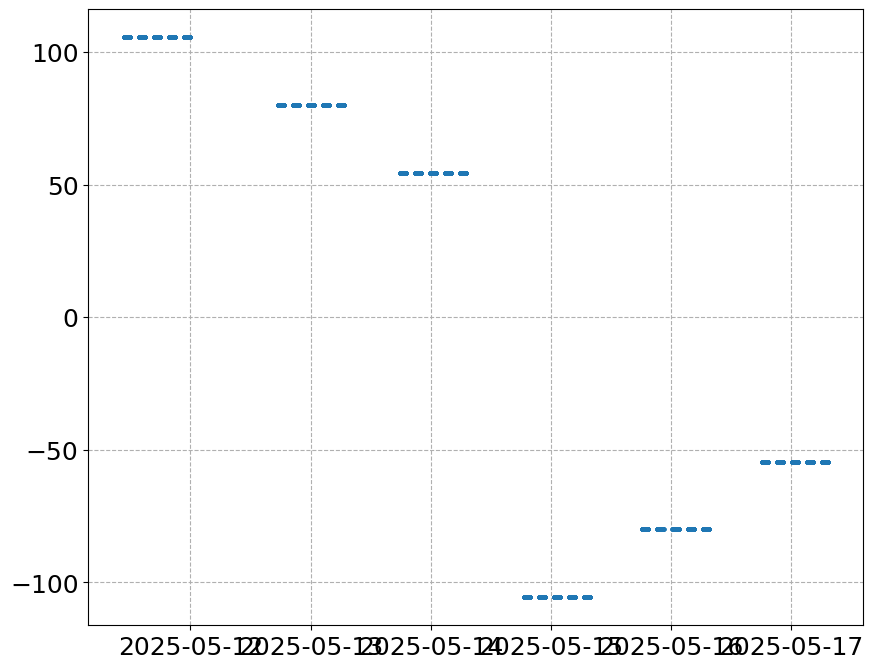

In [123]:
df_ = myHPC.df.query('has_nmr < 0.01')

fig, ax = plt.subplots()

ax.scatter(df_.index, df_['Magnet Current [A]'], s=4)

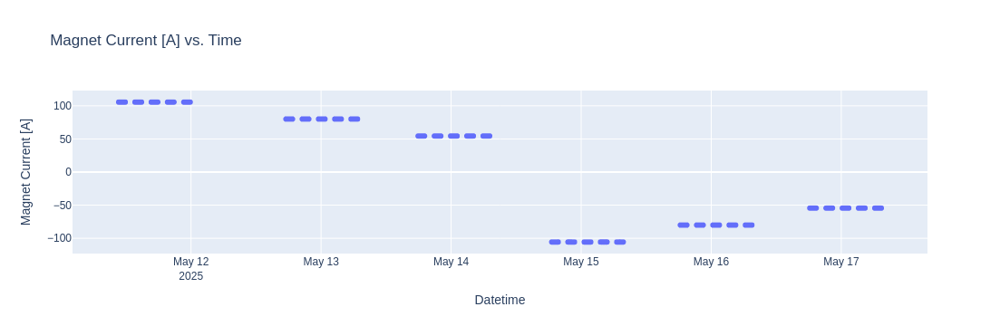

In [118]:
df_ = myHPC.df.query('has_nmr < 0.001')
fig = px.scatter(df_, x=df_.index, y='Magnet Current [A]', title='Magnet Current [A] vs. Time')
fig.update_layout(
    #xaxis_title='Index',
    #yaxis_title='y',
    height=600,  # increase height
    #width=800    # optional: set width if desired
)
fig.show()

In [97]:
df_.index

DatetimeIndex(['2025-04-16 16:22:56', '2025-04-16 16:23:05',
               '2025-04-16 16:23:14', '2025-04-16 16:23:23',
               '2025-04-16 16:23:32', '2025-04-16 16:23:41',
               '2025-04-16 16:23:50', '2025-04-16 16:23:59',
               '2025-04-16 16:24:08', '2025-04-16 16:24:18',
               ...
               '2025-05-20 18:38:08', '2025-05-20 18:38:16',
               '2025-05-20 18:38:17', '2025-05-20 18:38:19',
               '2025-05-20 18:38:26', '2025-05-20 18:38:28',
               '2025-05-20 18:38:30', '2025-05-20 18:38:37',
               '2025-05-20 18:38:39', '2025-05-20 18:38:40'],
              dtype='datetime64[ns]', name='Datetime', length=25168, freq=None)

In [104]:
interp_func = interp1d(myHPC.df_temps.seconds_delta, myHPC.df_temps['has_nmr'].values, kind='nearest', fill_value='extrapolate')
#df.loc[:, col] = interp_func(df.seconds_delta)

In [108]:
interp_func(3.)

array(1.)

In [111]:
interp_func(df.seconds_delta.iloc[10:40])

array([1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

Datetime
2025-04-16 16:07:32    True
2025-04-16 16:08:36    True
2025-04-16 16:13:37    True
2025-04-16 16:18:37    True
2025-04-16 16:23:36    True
                       ... 
2025-05-20 19:14:24    True
2025-05-20 19:19:24    True
2025-05-20 19:24:24    True
2025-05-20 19:29:24    True
2025-05-20 19:34:24    True
Name: has_nmr, Length: 8696, dtype: bool

In [102]:
i0 = 20
df.iloc[i0:i0+30]

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,TrippLite HVAC supply,Tripplite HVAC exhaust,EvapCoil (NWC),Barrel/Reservoir (FNAL),Return PS (FNAL),Return Magnet (NWC-R),Chiller Exhaust (NW),Supply Magnet (NWC-S),Supply PS (FNAL),has_nmr
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-04-16 16:23:41,4/16/2025 4:23:41 PM,113.562656,12.939268,0.232966,0.0,-53405.0,-21602.0,2093854.0,19746.0,-0.750938,...,18.203157,27.651842,23.774085,17.671492,36.297253,13.574732,28.796707,12.440739,28.443709,0.0
2025-04-16 16:23:50,4/16/2025 4:23:50 PM,112.668926,12.841719,0.206757,0.0,-55305.0,-25554.0,2093902.0,19748.0,-0.750936,...,17.821305,27.805090,23.769808,17.741796,36.529224,13.855743,28.500447,12.769713,28.733763,0.0
2025-04-16 16:23:59,4/16/2025 4:23:59 PM,111.775197,12.744169,0.180548,0.0,-58283.0,-28939.0,2093978.0,19734.0,-0.750937,...,17.439452,27.958338,23.765531,17.812100,36.761195,14.136755,28.204187,13.098686,29.023817,0.0
2025-04-16 16:24:08,4/16/2025 4:24:08 PM,110.881467,12.646620,0.154340,0.0,-61950.0,-31469.0,2094126.0,19660.0,-0.750944,...,17.057600,28.111587,23.761255,17.882404,36.993165,14.417767,27.907927,13.427660,29.313871,0.0
2025-04-16 16:24:18,4/16/2025 4:24:18 PM,109.888434,12.538231,0.125219,0.0,-66294.0,-32849.0,2094138.0,19609.0,-0.750911,...,16.633319,28.281862,23.756503,17.960519,37.250910,14.730002,27.578750,13.793186,29.636153,0.0
2025-04-16 16:25:37,4/16/2025 4:25:37 PM,142.928377,16.448648,0.811940,0.0,-80174.0,347.0,2093594.0,19616.0,-0.750765,...,19.979794,26.011135,23.160836,16.636141,33.435627,10.080302,28.545986,7.877334,24.243404,1.0
2025-04-16 16:25:46,4/16/2025 4:25:46 PM,130.940716,14.807539,0.742581,0.0,-75652.0,2471.0,2093539.0,19605.0,-0.750766,...,24.187116,23.107180,22.888476,16.228617,31.917975,7.914913,28.981835,5.909665,22.922029,1.0
2025-04-16 16:25:55,4/16/2025 4:25:55 PM,130.047283,14.711922,0.716372,0.0,-70546.0,3222.0,2093497.0,19619.0,-0.750778,...,24.213956,23.128105,22.884028,16.302906,32.147230,8.246120,28.859619,6.291663,23.205319,1.0
2025-04-16 16:26:04,4/16/2025 4:26:04 PM,129.153850,14.616305,0.690164,0.0,-65571.0,2692.0,2093424.0,19627.0,-0.750773,...,24.240797,23.149031,22.879579,16.377195,32.376485,8.577327,28.737403,6.673661,23.488609,1.0


In [81]:
df = myHPC.df

In [82]:
df.index

DatetimeIndex(['2025-04-16 16:20:38', '2025-04-16 16:20:48',
               '2025-04-16 16:20:57', '2025-04-16 16:21:06',
               '2025-04-16 16:21:15', '2025-04-16 16:21:24',
               '2025-04-16 16:21:33', '2025-04-16 16:21:43',
               '2025-04-16 16:21:52', '2025-04-16 16:22:01',
               ...
               '2025-05-20 18:38:19', '2025-05-20 18:38:26',
               '2025-05-20 18:38:28', '2025-05-20 18:38:30',
               '2025-05-20 18:38:37', '2025-05-20 18:38:39',
               '2025-05-20 18:38:40', '2025-05-20 18:38:48',
               '2025-05-20 18:38:49', '2025-05-20 18:38:51'],
              dtype='datetime64[ns]', name='Datetime', length=118542, freq=None)

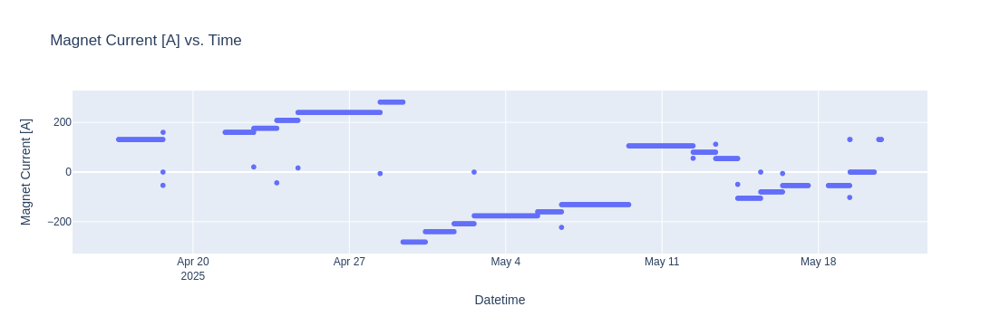

In [93]:
df_ = myHPC.df_temps#.query('has_nmr < 0.01')
fig = px.scatter(df_, x=df_.index, y='Magnet Current [A]', title='Magnet Current [A] vs. Time')
fig.update_layout(
    #xaxis_title='Index',
    #yaxis_title='y',
    height=600,  # increase height
    #width=800    # optional: set width if desired
)
fig.show()

In [90]:
myHPC.df_temps[~myHPC.df_temps.has_nmr]['Magnet Current [A]'].describe()

count    2906.000000
mean       13.753025
std        79.516757
min      -105.639643
25%       -54.425729
50%        -0.004566
75%       105.625576
max       131.237733
Name: Magnet Current [A], dtype: float64

In [91]:
myHPC.df_temps[~myHPC.df_temps.has_nmr]['Magnet Current [A]'].abs().describe()

count    2906.000000
mean       73.486840
std        33.315926
min         0.000469
25%        54.423342
50%        80.024327
75%       105.629840
max       131.237733
Name: Magnet Current [A], dtype: float64

In [92]:
myHPC.df_temps[~myHPC.df_temps.has_nmr].query('`Magnet Current [A]` > 130.')

,Time,Magnet Current [A],Magnet Voltage [V],Coil 1,Coil 2,LCW in Coil1,LCW out Coil 1,LCW in Coil 2,LCW out Coil 2,Yoke (near pole),...,Chiller Exhaust (NW),Supply Magnet (NWC-S),NaN (NWC-S),Supply PS (FNAL),NMR [T],NMR [FFT],seconds_delta,hours_delta,days_delta,has_nmr
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-05-19 09:40:28,5/19/2025 9:40:28 AM,131.237620,15.129802,21.094128,20.968334,17.922638,18.527121,17.466919,18.629032,16.664835,...,33.639107,17.216763,19.829386,27.705561,0.0,0.0,82524.0,22.923333,0.955139,False
2025-05-19 09:45:28,5/19/2025 9:45:28 AM,131.237733,15.140015,21.758398,21.471127,12.229705,13.827030,13.444400,14.044668,16.717627,...,27.129828,12.745499,19.685635,27.741264,0.0,0.0,82824.0,23.006667,0.958611,False
2025-05-19 09:50:28,5/19/2025 9:50:28 AM,131.237620,15.141825,21.935051,21.514387,11.901519,13.679614,13.313560,13.828050,16.697460,...,27.908785,12.433407,19.368422,27.756222,0.0,0.0,83124.0,23.090000,0.962083,False
2025-05-19 09:55:28,5/19/2025 9:55:28 AM,131.237507,15.146992,22.073929,21.601320,11.901362,13.894929,13.509782,13.902613,16.681707,...,30.261433,12.098932,19.171642,27.839500,0.0,0.0,83424.0,23.173333,0.965556,False


In [76]:
df_.has_nmr.unique()

array([0.])

In [80]:
myHPC.df.has_nmr

Datetime
2025-04-16 16:20:38    1.0
2025-04-16 16:20:48    1.0
2025-04-16 16:20:57    1.0
2025-04-16 16:21:06    1.0
2025-04-16 16:21:15    1.0
                      ... 
2025-05-20 18:38:39    0.0
2025-05-20 18:38:40    0.0
2025-05-20 18:38:48    1.0
2025-05-20 18:38:49    1.0
2025-05-20 18:38:51    1.0
Name: has_nmr, Length: 118542, dtype: float64

In [73]:
type(df_.Time.iloc[0])

str

In [ ]:
myBEst.B(1

In [25]:
pkldir_BEst = ('/home/ckampa/data/hallprobecalib_extras/datafiles/magnet_ramp/'+
               '2021-02-24/')
#pkl

In [40]:
f = pkldir_BEst+'ramp_2021-02-24.interp_fcn_NMR.pkl'
func = pkl.load(open(f,'rb')) # may need to rerun this analysis to update scipy interp
f_H = pkldir_BEst+'ramp_2021-02-24.interp_fcn_Hall.pkl'
func_H = pkl.load(open(f_H,'rb')) # may need to rerun this analysis to update scipy interp

/tmp/ipykernel_2661955/3563845383.py:2: DeprecationWarning: Please import `interp1d` from the `scipy.interpolate` namespace; the `scipy.interpolate.interpolate` namespace is deprecated and will be removed in SciPy 2.0.0.
  func = pkl.load(open(f,'rb')) # may need to rerun this analysis to update scipy interp
/tmp/ipykernel_2661955/3563845383.py:4: DeprecationWarning: Please import `interp1d` from the `scipy.interpolate` namespace; the `scipy.interpolate.interpolate` namespace is deprecated and will be removed in SciPy 2.0.0.
  func_H = pkl.load(open(f_H,'rb')) # may need to rerun this analysis to update scipy interp


In [53]:
I = 50.

In [54]:
func(I)

array(0.30845946)

In [55]:
func_H(I)

array(0.28866971)

In [56]:
1 - func_H(I) / func(I)

0.0641567170414925

### TMP RUN

In [ ]:
# B estimator, using Hall probe model from magnet ramp
# pkldir_BEst = ('/home/ckampa/data/hallprobecalib_extras/datafiles/magnet_ramp/'+
#                '2021-02-24/')
# pklfile_Hall = pkldir_BEst+'ramp_2021-02-24.interp_fcn_Hall.pkl'
# myBEst = BEstimator(pklfile_Hall, needs_loc_corr=False)

In [208]:
# use pole to pole
#pklfile_Hall = ddir_proc+'BEst_from_pole_to_pole.pkl'
#myBEst = BEstimator(pklfile_Hall, needs_loc_corr=False)

In [19]:
# use Bergsma calibration as correct
myBEst = None

In [20]:
ddir_run_info = 'run_info/'
ddir_raw = '/home/ckampa/Dropbox/LogFiles/'
ddir_proc = '/home/ckampa/data/hallprobecalib_extras/datafiles/Thesis_Calibration/'

In [21]:
# load the pole to pole function
params_BLocCorr = pkl.load(open(ddir_proc+'params_B_corr_func_linear_interp_extrap_xHall_40.0.pkl', 'rb'))
BLocCorr = get_B_corr_func(params_BLocCorr, I0=50.0)

In [22]:
BLocCorr(np.array([25., 40., 50., 100., 200., 300.]))

array([-4.20533968e-05, -4.20533968e-05, -4.20533968e-05, -8.82342060e-05,
       -4.97367231e-04, -1.56935284e-03])

In [23]:
[f for f in os.listdir(ddir_run_info)]

['pole_to_pole_slowscan_list.csv',
 'pole_to_pole_runs_list.csv',
 'runs_list_8E0000000D51483A.csv',
 'slowscan_list_2025.csv']

In [24]:
probe_ID = '8E0000000D51483A'

In [33]:
# only run again if I change first processing!
'''
# process from scratch
myHPC = HallProbeCalib(probe_ID=probe_ID,
                       ddir_run_info=ddir_run_info,
                       ddir_raw=ddir_raw,
                       ddir_proc=ddir_proc,
                       BEst=myBEst,
                       BLocCorr=BLocCorr,
                       t0=None, # no filter
                       # t0=parser.parse('2025-05-20 00:00'), # only process recent files
                       tf=None,
                      )
# initial process (concatenation)
myHPC.process_data()
# data qual checks -- creates df_clean
myHPC.check_data_qual()
# reference B
myHPC.get_B_ref()
# save / load pickle
myHPC.to_pickle(ddir_proc+f'{probe_ID}_HPC_analysis_class.pkl')
'''
pass;

In [859]:
# load
myHPC = myHPC.from_pickle(ddir_proc+f'{probe_ID}_HPC_analysis_class.pkl')

In [860]:
myHPC.df_clean

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,EvapCoil (NWC),Barrel/Reservoir (FNAL),Return PS (FNAL),Return Magnet (NWC-R),Chiller Exhaust (NW),Supply Magnet (NWC-S),Supply PS (FNAL),has_nmr,B,B_corr
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-04-16 16:20:38,4/16/2025 4:20:38 PM,131.238550,14.830992,0.751319,0.0,-66810.0,-32968.0,2094174.0,19542.0,-0.750901,...,22.825807,16.168856,31.869197,7.816095,28.756161,5.654546,22.875925,1.0,0.751319,0.751156
2025-04-16 16:20:48,4/16/2025 4:20:48 PM,131.238551,14.830296,0.751319,0.0,-71248.0,-33178.0,2094245.0,19535.0,-0.750906,...,22.820505,16.165964,31.871482,7.817052,28.734143,5.643985,22.879919,1.0,0.751319,0.751157
2025-04-16 16:20:57,4/16/2025 4:20:57 PM,131.238553,14.829670,0.751319,0.0,-75621.0,-31981.0,2094336.0,19536.0,-0.750924,...,22.815733,16.163361,31.873537,7.817914,28.714328,5.634480,22.883513,1.0,0.751319,0.751157
2025-04-16 16:21:06,4/16/2025 4:21:06 PM,131.238555,14.829044,0.751319,0.0,-79547.0,-29796.0,2094280.0,19576.0,-0.750907,...,22.810962,16.160758,31.875593,7.818775,28.694512,5.624975,22.887108,1.0,0.751319,0.751157
2025-04-16 16:21:15,4/16/2025 4:21:15 PM,131.238557,14.828418,0.751319,0.0,-82878.0,-26806.0,2094238.0,19609.0,-0.750898,...,22.806190,16.158155,31.877649,7.819637,28.674696,5.615471,22.890702,1.0,0.751319,0.751157
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-20 18:38:39,5/20/2025 6:38:39 PM,131.238518,15.145605,0.752870,0.0,-377253.0,373178.0,2036914.0,15978.0,-0.729629,...,24.153314,18.075692,36.608094,15.220987,24.738621,13.728871,28.000127,1.0,0.752870,0.752708
2025-05-20 18:38:40,5/20/2025 6:38:40 PM,131.238518,15.145596,0.752870,0.0,-377242.0,373210.0,2036932.0,15981.0,-0.729636,...,24.161632,18.075650,36.608594,15.220011,24.714383,13.732947,28.000679,1.0,0.752870,0.752708
2025-05-20 18:38:48,5/20/2025 6:38:48 PM,131.238520,15.145521,0.752870,0.0,-266089.0,436442.0,2035258.0,15954.0,-0.729649,...,24.228170,18.075316,36.612593,15.212200,24.520484,13.765556,28.005093,1.0,0.752870,0.752708


In [861]:
myHPC.df_clean.columns

Index(['Time', 'Magnet Current [A]', 'Magnet Voltage [V]', 'NMR [T]',
       'NMR [FFT]', '8E0000000D51483A_Raw_X', '8E0000000D51483A_Raw_Y',
       '8E0000000D51483A_Raw_Z', '8E0000000D51483A_Raw_T',
       '8E0000000D51483A_Cal_X', '8E0000000D51483A_Cal_Y',
       '8E0000000D51483A_Cal_Z', '8E0000000D51483A_Cal_T',
       'SmarAct_Pattern_Angle_1', 'SmarAct_Pattern_Angle_2',
       'SmarAct_Meas_Angle_1', 'SmarAct_Meas_Rotation_Angle_1',
       'SmarAct_Meas_Angle_2', 'SmarAct_Meas_Rotation_Angle_2',
       'seconds_delta', 'hours_delta', 'days_delta', 'run_type',
       'expected_field', 'polarity', 'chiller_temp_F',
       '8E0000000D51483A_Raw_Bmag', '8E0000000D51483A_Raw_Theta',
       '8E0000000D51483A_Raw_Phi', '8E0000000D51483A_Cal_Bmag',
       '8E0000000D51483A_Cal_Theta', '8E0000000D51483A_Cal_Phi',
       '8E0000000D51483A_Cal_Theta2', '8E0000000D51483A_Cal_Phi2',
       'Magnet Resistance [Ohm]', 'Coil Resistance [Ohm]', 'Magnet Power [W]',
       'SmarAct_Meas_Angle_1_Ce

### TMP

In [117]:
myHPC.df

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,TrippLite HVAC supply,Tripplite HVAC exhaust,EvapCoil (NWC),Barrel/Reservoir (FNAL),Return PS (FNAL),Return Magnet (NWC-R),Chiller Exhaust (NW),Supply Magnet (NWC-S),Supply PS (FNAL),has_nmr
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-04-16 16:20:38,4/16/2025 4:20:38 PM,131.238550,14.830992,0.751319,0.0,-66810.0,-32968.0,2094174.0,19542.0,-0.750901,...,23.895880,22.845411,22.825807,16.168856,31.869197,7.816095,28.756161,5.654546,22.875925,1.0
2025-04-16 16:20:48,4/16/2025 4:20:48 PM,131.238551,14.830296,0.751319,0.0,-71248.0,-33178.0,2094245.0,19535.0,-0.750906,...,23.872550,22.824354,22.820505,16.165964,31.871482,7.817052,28.734143,5.643985,22.879919,1.0
2025-04-16 16:20:57,4/16/2025 4:20:57 PM,131.238553,14.829670,0.751319,0.0,-75621.0,-31981.0,2094336.0,19536.0,-0.750924,...,23.851554,22.805402,22.815733,16.163361,31.873537,7.817914,28.714328,5.634480,22.883513,1.0
2025-04-16 16:21:06,4/16/2025 4:21:06 PM,131.238555,14.829044,0.751319,0.0,-79547.0,-29796.0,2094280.0,19576.0,-0.750907,...,23.830557,22.786450,22.810962,16.160758,31.875593,7.818775,28.694512,5.624975,22.887108,1.0
2025-04-16 16:21:15,4/16/2025 4:21:15 PM,131.238557,14.828418,0.751319,0.0,-82878.0,-26806.0,2094238.0,19609.0,-0.750898,...,23.809560,22.767499,22.806190,16.158155,31.877649,7.819637,28.674696,5.615471,22.890702,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-20 18:38:39,5/20/2025 6:38:39 PM,131.238518,15.145605,0.752870,0.0,-377253.0,373178.0,2036914.0,15978.0,-0.729629,...,21.996368,21.265503,24.153314,18.075692,36.608094,15.220987,24.738621,13.728871,28.000127,1.0
2025-05-20 18:38:40,5/20/2025 6:38:40 PM,131.238518,15.145596,0.752870,0.0,-377242.0,373210.0,2036932.0,15981.0,-0.729636,...,21.995950,21.265619,24.161632,18.075650,36.608594,15.220011,24.714383,13.732947,28.000679,1.0
2025-05-20 18:38:48,5/20/2025 6:38:48 PM,131.238520,15.145521,0.752870,0.0,-266089.0,436442.0,2035258.0,15954.0,-0.729649,...,21.992608,21.266548,24.228170,18.075316,36.612593,15.212200,24.520484,13.765556,28.005093,1.0


In [15]:
myHPC.df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 118542 entries, 2025-04-16 16:20:38 to 2025-05-20 18:38:51
Data columns (total 78 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   Time                           118542 non-null  object 
 1   Magnet Current [A]             118542 non-null  float64
 2   Magnet Voltage [V]             118542 non-null  float64
 3   NMR [T]                        118542 non-null  float64
 4   NMR [FFT]                      118542 non-null  float64
 5   8E0000000D51483A_Raw_X         118542 non-null  float64
 6   8E0000000D51483A_Raw_Y         118542 non-null  float64
 7   8E0000000D51483A_Raw_Z         118542 non-null  float64
 8   8E0000000D51483A_Raw_T         118542 non-null  float64
 9   8E0000000D51483A_Cal_X         118542 non-null  float64
 10  8E0000000D51483A_Cal_Y         118542 non-null  float64
 11  8E0000000D51483A_Cal_Z         118542 non-null  float64
 

In [109]:
myHPC.df.query('run_type == "prod"')

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,SmarAct_Meas_Rotation_Angle_1,SmarAct_Meas_Angle_2,SmarAct_Meas_Rotation_Angle_2,seconds_delta,hours_delta,days_delta,run_type,expected_field,polarity,chiller_temp_F
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-04-17 11:09:57,4/17/2025 11:09:57 AM,0.0,0.0,0.0,0.0,-64803.0,-32780.0,2094701.0,19276.0,-0.751014,...,0.0,3.900000e-07,0.0,41.0,0.011389,0.000475,prod,0.75,pos,40.0
2025-04-17 11:10:06,4/17/2025 11:10:06 AM,0.0,0.0,0.0,0.0,-69427.0,-33310.0,2094724.0,19285.0,-0.751005,...,0.0,1.500001e+01,0.0,50.0,0.013889,0.000579,prod,0.75,pos,40.0
2025-04-17 11:10:15,4/17/2025 11:10:15 AM,0.0,0.0,0.0,0.0,-73869.0,-32720.0,2094746.0,19306.0,-0.751003,...,0.0,3.000001e+01,0.0,59.0,0.016389,0.000683,prod,0.75,pos,40.0
2025-04-17 11:10:24,4/17/2025 11:10:24 AM,0.0,0.0,0.0,0.0,-78201.0,-30868.0,2094799.0,19340.0,-0.751021,...,0.0,4.500001e+01,0.0,68.0,0.018889,0.000787,prod,0.75,pos,40.0
2025-04-17 11:10:33,4/17/2025 11:10:33 AM,0.0,0.0,0.0,0.0,-81939.0,-28219.0,2094747.0,19351.0,-0.750999,...,0.0,6.000001e+01,0.0,77.0,0.021389,0.000891,prod,0.75,pos,40.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-17 07:23:26,5/17/2025 7:23:26 AM,0.0,0.0,0.0,0.0,159292.0,-154731.0,-839713.0,33184.0,0.304683,...,0.0,3.450000e+02,0.0,76367.0,21.213056,0.883877,prod,0.31,neg,66.0
2025-05-17 07:23:28,5/17/2025 7:23:28 AM,0.0,0.0,0.0,0.0,159229.0,-154803.0,-839775.0,33178.0,0.304705,...,0.0,3.450000e+02,0.0,76369.0,21.213611,0.883900,prod,0.31,neg,66.0
2025-05-17 07:23:33,5/17/2025 7:23:33 AM,0.0,0.0,0.0,0.0,113599.0,-181839.0,-838988.0,33198.0,0.304686,...,0.0,3.600000e+02,0.0,76374.0,21.215000,0.883958,prod,0.31,neg,66.0


In [19]:
myHPC.df.query('(run_type == "prod") & (has_nmr == 1.)')

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,TrippLite HVAC supply,Tripplite HVAC exhaust,EvapCoil (NWC),Barrel/Reservoir (FNAL),Return PS (FNAL),Return Magnet (NWC-R),Chiller Exhaust (NW),Supply Magnet (NWC-S),Supply PS (FNAL),has_nmr
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-04-17 11:09:57,4/17/2025 11:09:57 AM,176.049620,21.009467,0.983702,0.0,-64803.0,-32780.0,2094701.0,19276.0,-0.751014,...,8.284443,33.978710,24.481794,17.859858,37.901089,16.931528,26.759867,14.305468,28.252945,1.0
2025-04-17 11:10:06,4/17/2025 11:10:06 AM,131.235696,15.026029,0.752267,0.0,-69427.0,-33310.0,2094724.0,19285.0,-0.751005,...,13.543633,27.040523,25.151627,17.376700,31.259010,12.104171,29.735835,10.276973,22.395636,1.0
2025-04-17 11:10:15,4/17/2025 11:10:15 AM,131.237625,14.950721,0.751652,0.0,-73869.0,-32720.0,2094746.0,19306.0,-0.751003,...,4.670500,31.977919,24.672418,16.701273,31.448731,9.674521,32.591852,7.401125,22.521769,1.0
2025-04-17 11:10:24,4/17/2025 11:10:24 AM,142.810566,16.602904,0.794250,0.0,-78201.0,-30868.0,2094799.0,19340.0,-0.751021,...,0.150570,34.570044,24.291451,16.482120,31.655724,8.970798,33.945618,6.023403,22.909171,1.0
2025-04-17 11:10:33,4/17/2025 11:10:33 AM,168.847273,20.414450,0.890862,0.0,-81939.0,-28219.0,2094747.0,19351.0,-0.750999,...,1.072142,34.230579,24.033285,16.833307,31.884309,10.424484,33.421571,6.518339,23.623159,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-17 07:23:26,5/17/2025 7:23:26 AM,-144.041472,-19.722772,1.122787,0.0,159292.0,-154731.0,-839713.0,33184.0,0.304683,...,16.776443,26.282052,24.415603,18.764624,33.836114,13.004012,29.599251,5.963068,26.765582,1.0
2025-05-17 07:23:28,5/17/2025 7:23:28 AM,-149.439120,-20.398516,1.130068,0.0,159229.0,-154803.0,-839775.0,33178.0,0.304705,...,16.778930,26.225773,24.414909,18.808460,33.814815,13.104706,29.570385,5.975429,26.778939,1.0
2025-05-17 07:23:33,5/17/2025 7:23:33 AM,-162.933241,-22.087877,1.148272,0.0,113599.0,-181839.0,-838988.0,33198.0,0.304686,...,16.785146,26.085076,24.413175,18.918048,33.761568,13.356441,29.498218,6.006331,26.812330,1.0


In [108]:
1500 * 16 * 3

72000

In [122]:
myHPC.scan_files

['run_info/runs_list_8E0000000D51483A.csv']

In [138]:
myHPC.df_slowscans_filt

,filename,has_nmr
0,2025-05-18 104503slow.txt,False
1,2025-05-20 165340slow.txt,True


In [139]:
myHPC.df_scans_filt

,filename,run_type,expected_field,polarity,chiller_temp_F
0,2025-05-20 165814.txt,test,0.75,pos,55.0


In [80]:
myHPC.df_slowscans

,filename,has_nmr
0,2025-04-16 160730slow.txt,True
1,2025-04-21 103520slow.txt,True
2,2025-04-23 012031slow.txt,True
3,2025-04-23 181127slow.txt,True
4,2025-04-28 132017slow.txt,True
5,2025-05-09 122556slow.txt,False
6,2025-05-18 104503slow.txt,False


In [81]:
myHPC.df_slowscans.iloc[0:]

,filename,has_nmr
0,2025-04-16 160730slow.txt,True
1,2025-04-21 103520slow.txt,True
2,2025-04-23 012031slow.txt,True
3,2025-04-23 181127slow.txt,True
4,2025-04-28 132017slow.txt,True
5,2025-05-09 122556slow.txt,False
6,2025-05-18 104503slow.txt,False


In [69]:
myHPC.t0, myHPC.tf

(datetime.datetime(2025, 4, 16, 16, 14, 36),
 datetime.datetime(2025, 5, 16, 10, 10, 38))

In [39]:
myHPC.df_scans_list

[                 filename run_type  expected_field polarity  chiller_temp_F
 0   2025-04-16 161436.txt     test            0.75      pos            40.0
 1   2025-04-17 110915.txt     prod            0.75      pos            40.0
 2   2025-04-17 135437.txt     prod            0.75      pos            40.0
 3   2025-04-17 163125.txt     prod            0.75      pos            40.0
 4   2025-04-17 221013.txt     prod            0.75      pos            40.0
 5   2025-04-18 004731.txt     prod            0.75      pos            40.0
 6   2025-04-18 110400.txt      val            0.75      pos            40.0
 7   2025-04-18 150308.txt     test            0.75      pos            40.0
 8   2025-04-21 111443.txt     prod            0.91      pos            55.0
 9   2025-04-22 120255.txt      val            0.91      pos            55.0
 10  2025-04-22 172233.txt     test            0.98      pos            55.0
 11  2025-04-23 012221.txt     prod            0.98      pos            55.0

In [40]:
myHPC.df_scans.chiller_temp_F

0     40.0
1     40.0
2     40.0
3     40.0
4     40.0
5     40.0
6     40.0
7     40.0
8     55.0
9     55.0
10    55.0
11    55.0
12    55.0
13    40.0
14    40.0
15    40.0
16    40.0
17    40.0
18    40.0
19    55.0
20    55.0
21    55.0
22    55.0
23    66.0
24    66.0
25    66.0
26    66.0
27    66.0
28    66.0
Name: chiller_temp_F, dtype: float64

In [41]:
myHPC.df_slowscans

,filename,has_nmr
0,2025-04-16 160730slow.txt,True
1,2025-04-21 103520slow.txt,True
2,2025-04-23 012031slow.txt,True
3,2025-04-23 181127slow.txt,True
4,2025-04-28 132017slow.txt,True
5,2025-05-09 122556slow.txt,False
6,2025-05-18 104503slow.txt,False


In [ ]:
dates = [parser.parse(row.Time) for row in df.itertuples()]

In [48]:
dates = np.array([parser.parse(f.split('.txt')[0]) for f in myHPC.df_scans.filename])

In [50]:
np.min(dates)

datetime.datetime(2025, 4, 16, 16, 14, 36)

In [51]:
dates

array([datetime.datetime(2025, 4, 16, 16, 14, 36),
       datetime.datetime(2025, 4, 17, 11, 9, 15),
       datetime.datetime(2025, 4, 17, 13, 54, 37),
       datetime.datetime(2025, 4, 17, 16, 31, 25),
       datetime.datetime(2025, 4, 17, 22, 10, 13),
       datetime.datetime(2025, 4, 18, 0, 47, 31),
       datetime.datetime(2025, 4, 18, 11, 4),
       datetime.datetime(2025, 4, 18, 15, 3, 8),
       datetime.datetime(2025, 4, 21, 11, 14, 43),
       datetime.datetime(2025, 4, 22, 12, 2, 55),
       datetime.datetime(2025, 4, 22, 17, 22, 33),
       datetime.datetime(2025, 4, 23, 1, 22, 21),
       datetime.datetime(2025, 4, 23, 18, 12, 30),
       datetime.datetime(2025, 4, 24, 16, 50, 10),
       datetime.datetime(2025, 4, 26, 21, 21, 16),
       datetime.datetime(2025, 4, 28, 13, 23, 40),
       datetime.datetime(2025, 4, 29, 9, 52, 41),
       datetime.datetime(2025, 4, 30, 9, 47, 27),
       datetime.datetime(2025, 5, 1, 16, 30, 47),
       datetime.datetime(2025, 5, 2, 14, 15, 

In [52]:
np.max(dates)

datetime.datetime(2025, 5, 16, 10, 10, 38)

# Main

## Process All Scan Data

- Scans and slow controls
- Should do the following:
    - Concatenate files
    - Run basic data quality checks (magnet is on; NMR reading if expected; Hall probe reading; motor is rotating as expected; anything else?)
    - If low field, apply the nominal interpolation based on the current (pole-to-pole or magnet ramp measurement) -- that could be another step
    - Apply pole-to-pole (?) -- that could be another step
    - Plots (?) or in the next step

In [ ]:
# initialize class to load the appropriate files

## Apply NMR Offset Correction (Pole-to-pole)

## Orientation Fit

In [1033]:
myHPC

In [1034]:
probe = probe_ID

In [1035]:
df = myHPC.df_clean.query('run_type == "prod"').copy()

In [1036]:
df

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,EvapCoil (NWC),Barrel/Reservoir (FNAL),Return PS (FNAL),Return Magnet (NWC-R),Chiller Exhaust (NW),Supply Magnet (NWC-S),Supply PS (FNAL),has_nmr,B,B_corr
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-04-17 11:09:57,4/17/2025 11:09:57 AM,131.238682,14.751499,0.75143,0.0,-64803.0,-32780.0,2094701.0,19276.0,-0.751014,...,21.008929,15.845252,34.591993,7.545472,32.892182,5.875191,25.902517,1.0,0.751430,0.751268
2025-04-17 11:10:06,4/17/2025 11:10:06 AM,131.238680,14.751497,0.75143,0.0,-69427.0,-33310.0,2094724.0,19285.0,-0.751005,...,20.999366,15.845038,34.592579,7.541997,32.871995,5.874836,25.902735,1.0,0.751430,0.751268
2025-04-17 11:10:15,4/17/2025 11:10:15 AM,131.238678,14.751494,0.75143,0.0,-73869.0,-32720.0,2094746.0,19306.0,-0.751003,...,20.989804,15.844823,34.593166,7.538523,32.851808,5.874481,25.902953,1.0,0.751430,0.751268
2025-04-17 11:10:24,4/17/2025 11:10:24 AM,131.238676,14.751492,0.75143,0.0,-78201.0,-30868.0,2094799.0,19340.0,-0.751021,...,20.980241,15.844609,34.593752,7.535048,32.831621,5.874126,25.903171,1.0,0.751430,0.751268
2025-04-17 11:10:33,4/17/2025 11:10:33 AM,131.238675,14.751489,0.75143,0.0,-81939.0,-28219.0,2094747.0,19351.0,-0.750999,...,20.970678,15.844395,34.594339,7.531573,32.811434,5.873771,25.903388,1.0,0.751430,0.751268
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-17 07:23:26,5/17/2025 7:23:26 AM,-54.423891,-6.248866,0.00000,0.0,159292.0,-154731.0,-839713.0,33184.0,0.304683,...,24.778301,22.152089,32.873679,19.545909,26.187655,18.977705,28.397092,0.0,0.314316,0.314316
2025-05-17 07:23:28,5/17/2025 7:23:28 AM,-54.423892,-6.248890,0.00000,0.0,159229.0,-154803.0,-839775.0,33178.0,0.304705,...,24.769011,22.152010,32.873488,19.552342,26.186401,18.985644,28.396759,0.0,0.314339,0.314339
2025-05-17 07:23:33,5/17/2025 7:23:33 AM,-54.423895,-6.248952,0.00000,0.0,113599.0,-181839.0,-838988.0,33198.0,0.304686,...,24.745785,22.151813,32.873010,19.568426,26.183266,19.005492,28.395924,0.0,0.314346,0.314346


In [1037]:
df.columns

Index(['Time', 'Magnet Current [A]', 'Magnet Voltage [V]', 'NMR [T]',
       'NMR [FFT]', '8E0000000D51483A_Raw_X', '8E0000000D51483A_Raw_Y',
       '8E0000000D51483A_Raw_Z', '8E0000000D51483A_Raw_T',
       '8E0000000D51483A_Cal_X', '8E0000000D51483A_Cal_Y',
       '8E0000000D51483A_Cal_Z', '8E0000000D51483A_Cal_T',
       'SmarAct_Pattern_Angle_1', 'SmarAct_Pattern_Angle_2',
       'SmarAct_Meas_Angle_1', 'SmarAct_Meas_Rotation_Angle_1',
       'SmarAct_Meas_Angle_2', 'SmarAct_Meas_Rotation_Angle_2',
       'seconds_delta', 'hours_delta', 'days_delta', 'run_type',
       'expected_field', 'polarity', 'chiller_temp_F',
       '8E0000000D51483A_Raw_Bmag', '8E0000000D51483A_Raw_Theta',
       '8E0000000D51483A_Raw_Phi', '8E0000000D51483A_Cal_Bmag',
       '8E0000000D51483A_Cal_Theta', '8E0000000D51483A_Cal_Phi',
       '8E0000000D51483A_Cal_Theta2', '8E0000000D51483A_Cal_Phi2',
       'Magnet Resistance [Ohm]', 'Coil Resistance [Ohm]', 'Magnet Power [W]',
       'SmarAct_Meas_Angle_1_Ce

In [1038]:
# more intuitive labels, based on a Mu2e-like coordinate system
# Bergsma Cal
df.loc[:, 'Cal_X'] = df.loc[:, f'{probe_ID}_Cal_Y']
df.loc[:, 'Cal_Y'] = df.loc[:, f'{probe_ID}_Cal_Z']
df.loc[:, 'Cal_Z'] = df.loc[:, f'{probe_ID}_Cal_X']
df.loc[:, 'Cal_Bmag'] = df.loc[:, f'{probe_ID}_Cal_Bmag']
# Raw
df.loc[:, 'Raw_X'] = df.loc[:, f'{probe_ID}_Raw_Y']
df.loc[:, 'Raw_Y'] = -df.loc[:, f'{probe_ID}_Raw_X']
df.loc[:, 'Raw_Z'] = -df.loc[:, f'{probe_ID}_Raw_Z']
df.loc[:, 'Raw_Bmag'] = df.loc[:, f'{probe_ID}_Raw_Bmag']
# field angles
df.loc[:, 'Cal_Trans'] = (df.loc[:, 'Cal_X']**2 + df.loc[:, 'Cal_Y']**2)**(1/2)
df.loc[:, 'Cal_Theta'] = np.arctan2(df.loc[:, 'Cal_Trans'], df.loc[:, 'Cal_Bmag'])
df.loc[:, 'Cal_Phi'] = np.arctan2(df.loc[:, 'Cal_Y'], df.loc[:, 'Cal_X'])

In [1039]:
## PUT BELOW IN A FUNCTION

In [1121]:
def model_func_CalibrationOrientationFit(axis0, axis1, Bmag, **params):
    if not isinstance(axis0, Iterable):
        axis0 = np.array([axis0])
        axis1 = np.array([axis1])
        Bmag = np.array([Bmag])
    # scale axis0, axis1
    axis0 = params['a0_sf'] * axis0
    axis1 = params['a1_sf'] * axis1
    # calculate normal vectors
    # Hall element is w.r.t. "SmarAct coordinates" (or better, Kinematic plate coordinates) and is fixed, regardless of axis0, axis1
    norm_Hall = np.array([np.sin(params['theta'])*np.cos(params['phi']), np.sin(params['theta'])*np.sin(params['phi']), np.cos(params['theta'])])
    # x_Hall is arbitary...
    ##x_Hall = np.array([-np.sin(params['phi']), np.cos(params['phi']), 0.])
    x_Hall = np.array([np.cos(params['phi']), np.sin(params['phi']), 0.])
    # B field has some nominal orientation w.r.t. kinematic plate, and is further rotated by axis0, axis1
    norm_B = np.array([np.sin(params['alpha'])*np.cos(params['beta']), np.sin(params['alpha'])*np.sin(params['beta']), np.cos(params['alpha'])])
    # rotate the field vector w.r.t. (orig comment)
    # ??? rotate the field vector w.r.t. SmarAct coords ???
    ###rot = Rotation.from_euler('yz', angles=np.array([-axis0, -axis1]).T, degrees=True) # ok
    rot = Rotation.from_euler('yz', angles=np.array([-axis0, axis1]).T, degrees=True) # ok
    norm_B_rot = rot.apply(np.repeat(norm_B[:, np.newaxis], len(axis0), axis=1).T)
    # calculate signed fraction of B vector along Hall normal i.e. Hall only reads perpendicular field (to first order)
    costh = np.dot(norm_B_rot, norm_Hall)
    sinth = (1 - costh**2)**(1/2)
    theta = np.arccos(costh)
    BT_rot90 = np.cross(norm_B_rot, norm_Hall)
    BT_rot90 = BT_rot90 / np.linalg.norm(BT_rot90, axis=1)[:, None]
    BT_rot = np.cross(norm_Hall, BT_rot90)
    # must normalize BT_rot
    BT_rot = BT_rot / np.linalg.norm(BT_rot, axis=1)[:, None]
    phi_Hall = np.arccos(np.dot(BT_rot, x_Hall))
    sign_phi = 2*(np.dot(np.cross(x_Hall, BT_rot), norm_Hall) > 0.).astype(int) - 1.
    phi_Hall = sign_phi * phi_Hall + params['phase']
    # recenter phi
    phi_Hall[phi_Hall > np.pi] = phi_Hall[phi_Hall > np.pi] - 2*np.pi
    phi_Hall[phi_Hall < -np.pi] = phi_Hall[phi_Hall < -np.pi] + 2*np.pi
    ###
    Bx = Bmag * sinth * np.cos(phi_Hall)
    By = Bmag * sinth * np.sin(phi_Hall)
    Bz = Bmag * costh
    B_meas = np.concatenate([Bx, By, Bz])
    if params['verbose'] == 1.:
        return B_meas, norm_Hall, norm_B, norm_B_rot, BT_rot, theta, phi_Hall
    else:
        return B_meas

In [1075]:
df

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,Cal_Y,Cal_Z,Cal_Bmag,Raw_X,Raw_Y,Raw_Z,Raw_Bmag,Cal_Trans,Cal_Theta,Cal_Phi
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-04-17 11:09:57,4/17/2025 11:09:57 AM,131.238682,14.751499,0.75143,0.0,-64803.0,-32780.0,2094701.0,19276.0,-0.751014,...,0.000954,-0.751014,0.751016,-32780.0,64803.0,-2094701.0,2.095960e+06,0.001365,0.001818,0.773853
2025-04-17 11:10:06,4/17/2025 11:10:06 AM,131.238680,14.751497,0.75143,0.0,-69427.0,-33310.0,2094724.0,19285.0,-0.751005,...,0.002621,-0.751005,0.751010,-33310.0,69427.0,-2094724.0,2.096139e+06,0.002725,0.003629,1.293180
2025-04-17 11:10:15,4/17/2025 11:10:15 AM,131.238678,14.751494,0.75143,0.0,-73869.0,-32720.0,2094746.0,19306.0,-0.751003,...,0.004222,-0.751003,0.751016,-32720.0,73869.0,-2094746.0,2.096303e+06,0.004323,0.005756,1.354843
2025-04-17 11:10:24,4/17/2025 11:10:24 AM,131.238676,14.751492,0.75143,0.0,-78201.0,-30868.0,2094799.0,19340.0,-0.751021,...,0.005785,-0.751021,0.751045,-30868.0,78201.0,-2094799.0,2.096485e+06,0.005993,0.007979,1.306386
2025-04-17 11:10:33,4/17/2025 11:10:33 AM,131.238675,14.751489,0.75143,0.0,-81939.0,-28219.0,2094747.0,19351.0,-0.750999,...,0.007135,-0.750999,0.751037,-28219.0,81939.0,-2094747.0,2.096539e+06,0.007560,0.010066,1.233749
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-17 07:23:26,5/17/2025 7:23:26 AM,-54.423891,-6.248866,0.00000,0.0,159292.0,-154731.0,-839713.0,33184.0,0.304683,...,-0.048399,0.304683,0.314316,-154731.0,-159292.0,839713.0,8.685813e+05,0.077222,0.240911,-2.464220
2025-05-17 07:23:28,5/17/2025 7:23:28 AM,-54.423892,-6.248890,0.00000,0.0,159229.0,-154803.0,-839775.0,33178.0,0.304705,...,-0.048375,0.304705,0.314339,-154803.0,-159229.0,839775.0,8.686426e+05,0.077228,0.240913,-2.464678
2025-05-17 07:23:33,5/17/2025 7:23:33 AM,-54.423895,-6.248952,0.00000,0.0,113599.0,-181839.0,-838988.0,33198.0,0.304686,...,-0.031869,0.304686,0.314346,-181839.0,-113599.0,838988.0,8.659509e+05,0.077327,0.241205,-2.716799


In [1076]:
df.columns

Index(['Time', 'Magnet Current [A]', 'Magnet Voltage [V]', 'NMR [T]',
       'NMR [FFT]', '8E0000000D51483A_Raw_X', '8E0000000D51483A_Raw_Y',
       '8E0000000D51483A_Raw_Z', '8E0000000D51483A_Raw_T',
       '8E0000000D51483A_Cal_X', '8E0000000D51483A_Cal_Y',
       '8E0000000D51483A_Cal_Z', '8E0000000D51483A_Cal_T',
       'SmarAct_Pattern_Angle_1', 'SmarAct_Pattern_Angle_2',
       'SmarAct_Meas_Angle_1', 'SmarAct_Meas_Rotation_Angle_1',
       'SmarAct_Meas_Angle_2', 'SmarAct_Meas_Rotation_Angle_2',
       'seconds_delta', 'hours_delta', 'days_delta', 'run_type',
       'expected_field', 'polarity', 'chiller_temp_F',
       '8E0000000D51483A_Raw_Bmag', '8E0000000D51483A_Raw_Theta',
       '8E0000000D51483A_Raw_Phi', '8E0000000D51483A_Cal_Bmag',
       '8E0000000D51483A_Cal_Theta', '8E0000000D51483A_Cal_Phi',
       '8E0000000D51483A_Cal_Theta2', '8E0000000D51483A_Cal_Phi2',
       'Magnet Resistance [Ohm]', 'Coil Resistance [Ohm]', 'Magnet Power [W]',
       'SmarAct_Meas_Angle_1_Ce

In [1077]:
df.SmarAct_Meas_Angle_1_Centered.describe()

count    99679.000000
mean         6.524152
std          4.597490
min         -1.000019
25%          2.999995
50%          6.999996
75%         10.999994
max         14.000013
Name: SmarAct_Meas_Angle_1_Centered, dtype: float64

In [1078]:
df.SmarAct_Meas_Angle_1.describe()

count    99679.000000
mean         6.524152
std          4.597490
min         -1.000019
25%          2.999995
50%          6.999996
75%         10.999994
max         14.000013
Name: SmarAct_Meas_Angle_1, dtype: float64

### First Orientation Fit

In [2300]:
# do we query a particular run?
#df_ = df.copy() # no
#df_ = df.query('`Magnet Current [A]` > 0.').copy() # positive current only
#df_ = df.query('(`Magnet Current [A]` > 0.) & (0.97 <= B_corr <=0.99)').copy() # positive current only; 0.98 T scans only
#df_ = df.query(f'(`Magnet Current [A]` > 0.) & (0.97 <= B_corr <=0.99) & (18.5 <= `{probe}_Cal_T` <= 21.5)').copy() # positive current only; 0.98 T scans only; 20 deg scan only
##df_ = df.query(f'(`Magnet Current [A]` < 0.) & (0.97 <= B_corr <=0.99) & (18.5 <= `{probe}_Cal_T` <= 21.5)').copy() # negative current only; 0.98 T scans only; 20 deg scan only
#df_ = df.query(f'(`Magnet Current [A]` < 0.) & (1.10 <= B_corr <=1.12) & (18.5 <= `{probe}_Cal_T` <= 21.5)').copy() # negative current only; 0.98 T scans only; 20 deg scan only
#df_ = df.query(f'(`Magnet Current [A]` < 0.)').copy() # negative current only
#df_ = df.query(f'(`Magnet Current [A]` < 0.) & (B_corr > 0.8)').copy() # negative current only
### NOMINAL
# df_ = df.query(f'(`Magnet Current [A]` < 0.) ' 
#                + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 14.)'
#               ).copy()
###
### DEBUG
### GOOD FOR NEGATIVE POLARITY
# df_ = df.query(f'(`Magnet Current [A]` < 0.) ' 
#                ####+f'& (0.97 <= B_corr <=0.99) '
#                +f'& (0.7 <= B_corr) '
#                # +f'& (18.5 <= `{probe}_Cal_T` <= 21.5) '
#                +f'& (23. <= `{probe}_Cal_T` <= 27.5) '
#                # +f'& (`{probe}_Cal_T` <= 18.0) '
#                # + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 10.)'
#                ##+ f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 14.)'
#                # + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 13.)'
#                + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` <= 13.)'
#               ).copy()
### POSITIVE POLARITY DEBUG
df_ = df.query(
               #f'(`Magnet Current [A]` > 0.) '
               f'(`Magnet Current [A]` > -10000.) '
               ####+f'& (0.97 <= B_corr <=0.99) '
               +f'& (0.7 <= B_corr) '
               # +f'& (18.5 <= `{probe}_Cal_T` <= 21.5) '
               +f'& (23. <= `{probe}_Cal_T` <= 27.5) '
               # +f'& (`{probe}_Cal_T` <= 18.0) '
               # + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 10.)'
               ##+ f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 14.)'
               # + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 13.)'
               + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` <= 13.)'
              ).copy()
###
# df_ = df.query('"01-16-23 08:55" <= Datetime <= "01-18-23 15:25"').copy() # yes, query run 3.
# df_ = df.query('("01-16-23 08:55" <= Datetime <= "01-18-23 15:25") or ("01-22-23 06:37" <= Datetime)').copy() # yes, query run 3 and 5
# df_ = df.query('("01-16-23 08:55" <= Datetime <= "01-18-23 15:25") or ("01-22-23 06:37" >= Datetime)').copy() # yes, query run 3 and 4

In [2301]:
len(df), len(df_)

(99679, 9587)

In [2302]:
#probe = probe_ID
#probe

In [2303]:
sign_Bmag = df_['Magnet Current [A]'] < 0.

In [2304]:
2.*sign_Bmag.astype(float) - 1.

Datetime
2025-04-17 16:37:25   -1.0
2025-04-17 16:37:43   -1.0
2025-04-17 16:38:02   -1.0
2025-04-17 16:38:12   -1.0
2025-04-17 16:38:21   -1.0
                      ... 
2025-05-07 03:45:49    1.0
2025-05-07 03:45:54    1.0
2025-05-07 03:45:55    1.0
2025-05-07 03:46:04    1.0
2025-05-07 03:46:12    1.0
Name: Magnet Current [A], Length: 9587, dtype: float64

In [2305]:
sigma_est = 3e-5
#sigma_est = 5e-5
# sigma_est = 1e-4
# sigma_est = 1e-3
# coord = 'Z'
# coord = 'X'
# coord = 'Y'
#B0 = df[f'Cal_{coord}'].abs().max()
B0 = df_['B_corr'].mean()
Bs_meas = np.concatenate([df_[f'Cal_{coord}'].values for coord in ['X', 'Y', 'Z']])
Bmag_meas0 = np.linalg.norm([df_[f'Cal_{coord}'].values for coord in ['X', 'Y', 'Z']], axis=0)
Bmag_meas = np.concatenate(3*[Bmag_meas0])
sign_Bmag_bool = df_['Magnet Current [A]'] < 0.
sign_Bmag = (2.*sign_Bmag_bool.astype(float) - 1.).values
# fit!
model = lm.Model(model_func_CalibrationOrientationFit, independent_vars=['axis0', 'axis1', 'Bmag'])
params = lm.Parameters()
# '''
# fixed parameters
# params.add('Bmax', value=B0, vary=True, min=0.5, max=1.5)
# params.add('Bmax', value=B0, vary=False)
# params.add('Bmax', value=1.00212872, vary=False)
params.add('verbose', value=0., vary=False)
# parameters to vary
# params.add('theta', value=np.pi/2, min=0. - np.pi/4, max=np.pi + np.pi/4)
##params.add('theta', value=np.radians(2), min=0., max=np.radians(5.))
# params.add('theta', value=np.radians(2), min=0., max=np.radians(15.))
params.add('theta', value=np.radians(2), min=- np.radians(5.), max=np.radians(15.))
params.add('phi', value=0., min=-np.pi, max=np.pi)
###params.add('phi', value=np.pi/2., min=-np.pi, max=np.pi)
# params.add('phi', value=-np.pi/2. - np.radians(32.81),
#            min=-np.pi/2. - np.radians(32.81) - np.radians(10.), 
#            max=-np.pi/2. - np.radians(32.81) + np.radians(10.),)
# params.add('alpha', value=np.pi/2, min=0., max=np.pi)
# params.add('alpha', value=np.radians(2), min=np.radians(-4.), max=np.radians(12.))
####params.add('alpha', value=np.radians(2), min=0., max=np.radians(5.))
####params.add('alpha', value=np.radians(2), min=0., max=np.radians(15.))
params.add('alpha', value=np.radians(2), min=-np.radians(5.), max=np.radians(15.))
# params.add('alpha', value=-0.03523667, vary=False)
# params.add('beta', value=0., min=-np.pi - np.pi/4, max=np.pi + np.pi/4, vary=True)
# params.add('beta', value=0., min=-np.pi, max=np.pi, vary=True)
params.add('beta', value=np.pi, min=0., max=2*np.pi, vary=True)
###params.add('beta', value=np.pi, min=-2.*np.pi, max=4*np.pi, vary=True)
# params.add('beta', value=-0.40267806, vary=False,)
params.add('phase', value=0., min=-np.pi, max=np.pi)
###params.add('phase', value=np.pi, min=0., max=2.*np.pi)
# best fit alpha and beta
# params.add('alpha', value=0.03240273, vary=False)
# params.add('beta', value=-3.14159265, vary=False)
# angle scale factors
r2 = 5e-1
# params.add('a0_sf', value=1.0, min=1.-r2, max=1.+r2, vary=True)
# params.add('a1_sf', value=1.0, min=1.-r2, max=1.+r2, vary=True)
params.add('a0_sf', value=1.0, min=1.-r2, max=1.+r2, vary=True)
#params.add('a0_sf', value=-1.0, min=-1.-r2, max=-1.+r2, vary=False)
# params.add('a1_sf', value=1.0, min=1.-r2, max=1.+r2, vary=False)
params.add('a1_sf', value=-1.0, min=-1.-r2, max=-1.+r2, vary=True)
# '''

'''
# var = False
var = True
params.add('verbose', value=0., vary=False)
# params.add('Bmax', value=result_Zcoord.params['Bmax'].value, vary = False)
params.add('theta', value=result_Zcoord.params['theta'].value, vary = var)
params.add('phi', value=result_Zcoord.params['phi'].value, vary = var)
params.add('alpha', value=result_Zcoord.params['alpha'].value, vary = var)
params.add('beta', value=result_Zcoord.params['beta'].value, vary = var)
params.add('phase', value=0., min=-np.pi, max=np.pi, vary=var)
'''

### NOT SURE THAT THESE WORK ON THEIR OWN
# phi for X (really Y)
# if coord == 'X':
#     params.add('phi', value=-np.pi/2, vary=True, min=-np.pi/2 + np.radians(-10), max=-np.pi/2 + np.radians(10))
# phi for Y (really X)
# if coord == 'Y':
#     params.add('phi', value=0., vary=True, min=np.radians(-10), max=np.radians(10))

# run fit
#result = model.fit(Bs_meas, axis0=A0.flatten(), axis1=A1.flatten(),
#                   params=params, weights=1/(sigma_est*B0*np.ones_like(Bs_meas)), scale_covar=False)
####
# result = model.fit(Bs_meas, axis0=df['SmarAct_Meas_Angle_1_Centered'].values, axis1=df['SmarAct_Meas_Angle_2_Centered'].values,
#                   params=params, weights=1/(sigma_est*B0*np.ones_like(Bs_meas)), scale_covar=False)
# adding Bmag
result = model.fit(Bs_meas, axis0=df_['SmarAct_Meas_Angle_1_Centered'].values, axis1=df_['SmarAct_Meas_Angle_2_Centered'].values,
                   #Bmag=df_[f'{probe}_Cal_Bmag'].values, params=params, weights=1/(sigma_est*B0*np.ones_like(Bs_meas)), scale_covar=False)
                   ####Bmag=df_[f'{probe}_Cal_Bmag'].values, params=params, weights=1/(sigma_est*np.ones_like(Bs_meas)), scale_covar=False)
                   Bmag=sign_Bmag*df_[f'{probe}_Cal_Bmag'].values, params=params, weights=1/(sigma_est*np.ones_like(Bs_meas)), scale_covar=False)
                   #Bmag=df_[f'{probe}_Cal_Bmag'].values, params=params, weights=1/(sigma_est*Bmag_meas), scale_covar=False)

In [2306]:
Bmag_meas.shape

(28761,)

In [2307]:
df_.shape

(9587, 98)

In [2308]:
result

In [2309]:
result

In [2310]:
2.74866+0.5499

3.29856

In [2311]:
5.7173 - 2.*np.pi

-0.5658853071795864

In [2312]:
0.006502 - 0.007667

-0.0011650000000000002

In [2313]:
result

In [2314]:
0.997996 * np.radians(14.) - np.radians(14.)

-0.0004896695749395386

In [2315]:
0.99992565 * np.radians(360.) - np.radians(360.)

-0.0004671548275885229

In [2316]:
np.degrees(0.00768)

0.44003158666047226

In [2317]:
np.degrees(0.00790)

0.4526366581533504

In [2318]:
np.degrees(0.00946)

0.5420180741937588

In [2319]:
def normalize_angle(angle, degrees=False):
    if degrees:
        angle_rad = np.radians(angle)
        return np.degrees(np.arctan2(np.sin(angle_rad), np.cos(angle_rad)))
    else:
        return np.arctan2(np.sin(angle), np.cos(angle))

def normalize_polar_angle(angle, degrees=False):
    if degrees:
        angle_rad = np.radians(angle)
        return np.degrees(np.arccos(np.cos(angle_rad)))
    else:
        return np.arccos(np.cos(angle))

In [2320]:
for k in result.params.keys():
    print(k, result.params[k].value, normalize_angle(result.params[k].value), normalize_polar_angle(result.params[k].value))

verbose 0.0 0.0 0.0
theta 0.00947563089458224 0.00947563089458224 0.009475630894578483
phi 0.06671123659268297 0.06671123659268297 0.06671123659268215
alpha -0.007543416128532807 -0.007543416128532807 0.007543416128536108
beta 2.4935698698348485 2.4935698698348485 2.4935698698348485
phase 0.45746627645261606 0.457466276452616 0.457466276452616
a0_sf 0.9974271415977702 0.9974271415977702 0.9974271415977702
a1_sf -0.9999614519102066 -0.9999614519102066 0.9999614519102066


In [2321]:
# plots!
from matplotlib.colors import Normalize
import matplotlib.cm as cm

In [2331]:
#N = len(df)
N = len(df_)
### X
# coord = 'X'
# ind0 = 0
# ind1 = 1*N
### Y
# coord = 'Y'
# ind0 = 1*N
# ind1 = 2*N
### Z
coord = 'Z'
ind0 = 2*N
ind1 = 3*N
####
bf = result.best_fit[ind0:ind1]

Bmin = np.min([np.min(df[f'Cal_{coord}']), np.min(bf)])
Bmax = np.max([np.max(df[f'Cal_{coord}']), np.max(bf)])

/tmp/ipykernel_1595705/3098269832.py:5: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



Text(0.5, 1.0, 'Best Fit Values: \n$\\theta = 0.009,\\ \\phi = 0.067$, $\\alpha = -0.008,\\ \\beta = 2.494,\\ \\mathrm{phase} = 0.457$')

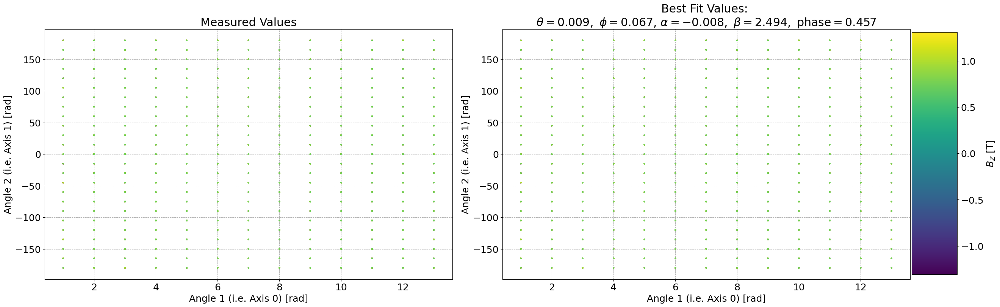

In [2332]:
# data, fit
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(24, 8), layout='constrained')
cax = fig.add_axes([1.0, 0.1, 0.05, 0.8])

cmap = cm.get_cmap('viridis')
normalizer = Normalize(Bmin, Bmax)
im = cm.ScalarMappable(norm=normalizer)
# sc = axs[0].scatter(A0.flatten(), A1.flatten(), c=Bs_meas, s=4, cmap=cmap, norm=normalizer)
# sc1 = axs[1].scatter(A0.flatten(), A1.flatten(), c=result.best_fit, s=4, cmap=cmap, norm=normalizer)

sc = axs[0].scatter(df_['SmarAct_Meas_Angle_1_Centered'].values, df_['SmarAct_Meas_Angle_2_Centered'].values, c=Bs_meas[ind0:ind1], s=4, cmap=cmap, norm=normalizer)
sc1 = axs[1].scatter(df_['SmarAct_Meas_Angle_1_Centered'].values, df_['SmarAct_Meas_Angle_2_Centered'].values, c=bf, s=4, cmap=cmap, norm=normalizer)

cb = fig.colorbar(im, cax=cax, label=rf'$B_{coord}$ [T]')

axs[0].set_xlabel('Angle 1 (i.e. Axis 0) [rad]')
axs[0].set_ylabel('Angle 2 (i.e. Axis 1) [rad]')
axs[0].set_title('Measured Values')
axs[1].set_xlabel('Angle 1 (i.e. Axis 0) [rad]')
axs[1].set_ylabel('Angle 2 (i.e. Axis 1) [rad]')
axs[1].set_title('Best Fit Values: \n'+
                 rf'$\theta = {result.params["theta"].value:0.3f},\ \phi = {result.params["phi"].value:0.3f}$, '+#'\n'+
                 rf'$\alpha = {result.params["alpha"].value:0.3f},\ \beta = {result.params["beta"].value:0.3f},\ \mathrm{{phase}} = {result.params["phase"].value:0.3f}$')

/tmp/ipykernel_1595705/2893674951.py:4: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



Text(0.5, 1.0, 'Measured Values - Best Fit Values: \n$\\theta = 0.009,\\ \\phi = 0.067$, $\\alpha = -0.008,\\ \\beta = 2.494,$\n$\\ \\mathrm{phase} = 0.457$')

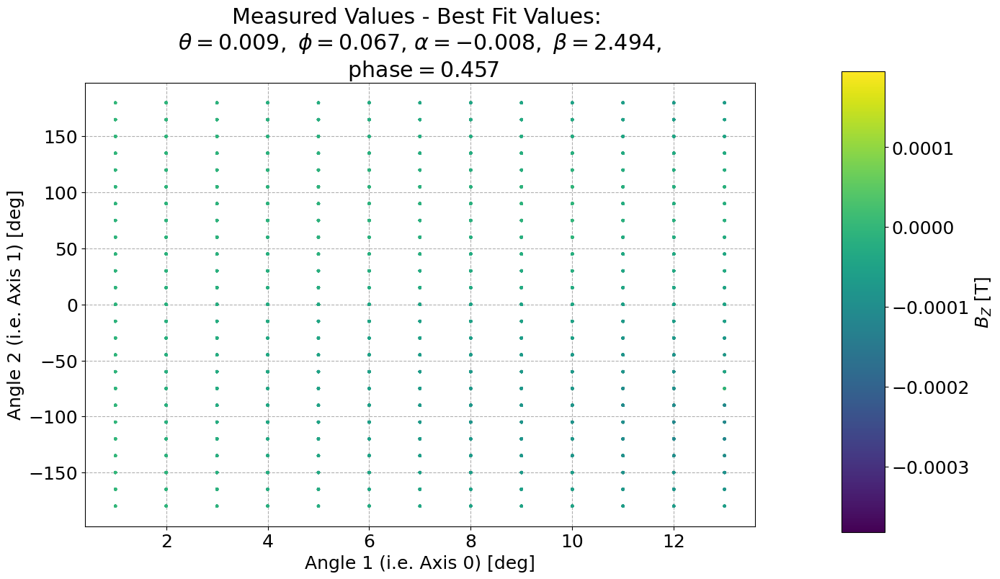

In [2333]:
# data - fit
fig, ax = plt.subplots(figsize=(12, 8))
cax = fig.add_axes([1.0, 0.1, 0.05, 0.8])
cmap = cm.get_cmap('viridis')
# normalizer = Normalize(Bmin, Bmax)
# im = cm.ScalarMappable(norm=normalizer)
# sc = axs[0].scatter(A0.flatten(), A1.flatten(), c=Bs_meas, s=4, cmap=cmap, norm=normalizer)
# sc1 = axs[1].scatter(A0.flatten(), A1.flatten(), c=result.best_fit, s=4, cmap=cmap, norm=normalizer)

sc = ax.scatter(df_['SmarAct_Meas_Angle_1_Centered'].values, df_['SmarAct_Meas_Angle_2_Centered'].values, c=Bs_meas[ind0:ind1]-bf, s=4, cmap=cmap)#, norm=normalizer)

cb = fig.colorbar(sc, cax=cax, label=rf'$B_{coord}$ [T]')

ax.set_xlabel('Angle 1 (i.e. Axis 0) [deg]')
ax.set_ylabel('Angle 2 (i.e. Axis 1) [deg]')
ax.set_title('Measured Values - Best Fit Values: \n'+
             rf'$\theta = {result.params["theta"].value:0.3f},\ \phi = {result.params["phi"].value:0.3f}$, '+#'\n'+
             rf'$\alpha = {result.params["alpha"].value:0.3f},\ \beta = {result.params["beta"].value:0.3f},$'+'\n'+rf'$\ \mathrm{{phase}} = {result.params["phase"].value:0.3f}$')

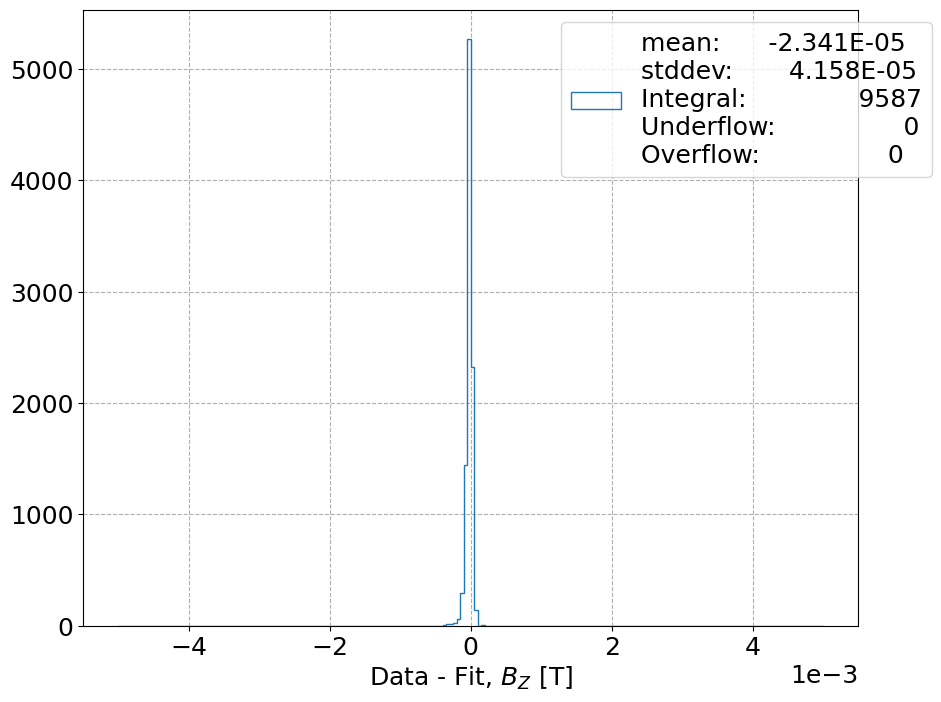

In [2334]:
# hist
fig, ax = plt.subplots()

#bins = np.arange(-1.50e-4, 1.52e-4, 2e-6)
###bins = np.arange(-5e-4, 5.05e-4, 5e-6)
bins = np.arange(-5e-3, 5.05e-3, 5e-5)
# bins = np.arange(-1e-3, 10.05e-4, 5e-6)
# bins = np.arange(-1.50e-1, 2.52e-1, 2e-3)

ax.hist(Bs_meas[ind0:ind1]-bf, bins=bins, histtype='step', label=get_label(Bs_meas[ind0:ind1]-bf, bins))

ax.set_xlabel(rf'Data - Fit, $B_{coord}$ [T]')
ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
ax.legend(loc='upper left', bbox_to_anchor=(0.6, 1.0));

In [2336]:
# what is the error in the angle?
# dfplot = df_.copy()
dfplot = df.query(
                 ###f'(`Magnet Current [A]` < 0.) '
                 f'(`Magnet Current [A]` > -10000.) '
                 #+f'& (0.97 <= B_corr <=0.99) '
                 ##+f'& (18.5 <= `{probe}_Cal_T` <= 21.5) '
                 +f'& (23. <= `{probe}_Cal_T` <= 27.5) '
#                # +f'& (`{probe}_Cal_T` <= 18.0) '
#                # + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 10.)'
                 #+ f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 14.)'
                 + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` <= 13.)'
              ).copy()
#N = len(df_)
N = len(dfplot)
### X
# coord = 'X'
ind0x = 0
ind1x = 1*N
### Y
# coord = 'Y'
ind0y = 1*N
ind1y = 2*N
### Z
# coord = 'Z'
ind0z = 2*N
ind1z = 3*N
####
sign_Bmag_bool = dfplot['Magnet Current [A]'] < 0.
sign_Bmag = (2.*sign_Bmag_bool.astype(float) - 1.).values
#res_bf = result.best_fit
res_bf = model_func_CalibrationOrientationFit(axis0=dfplot['SmarAct_Meas_Angle_1_Centered'].values,
                                              axis1=dfplot['SmarAct_Meas_Angle_2_Centered'].values,
                                              Bmag=sign_Bmag*dfplot[f'{probe}_Cal_Bmag'].values,
                                              **result.params)
# Bx_fit = result.best_fit[ind0x:ind1x]
# By_fit = result.best_fit[ind0y:ind1y]
# Bz_fit = result.best_fit[ind0z:ind1z]
Bx_fit = res_bf[ind0x:ind1x]
By_fit = res_bf[ind0y:ind1y]
Bz_fit = res_bf[ind0z:ind1z]
Bvec_fit = np.array([Bx_fit, By_fit, Bz_fit]).T
#Bvec_meas = df_[['Cal_X', 'Cal_Y', 'Cal_Z']].values
Bvec_meas = dfplot[['Cal_X', 'Cal_Y', 'Cal_Z']].values
magBvec_fit = np.linalg.norm(Bvec_fit, axis=1)
magBvec_meas = np.linalg.norm(Bvec_meas, axis=1)
# dot product
dot_Bvec = np.sum((Bvec_fit * Bvec_meas), axis=1)
cos_angle_bw = dot_Bvec / (magBvec_fit * magBvec_meas)
angle_bw = np.arccos(cos_angle_bw)

In [2341]:
len(dfplot), len(df_), len(df)

(15017, 9587, 99679)

In [2342]:
np.max(magBvec_meas - magBvec_fit), np.min(magBvec_meas - magBvec_fit)

(4.440892098500626e-16, -4.440892098500626e-16)

In [2343]:
angle_bw.max()

0.004031119533853561

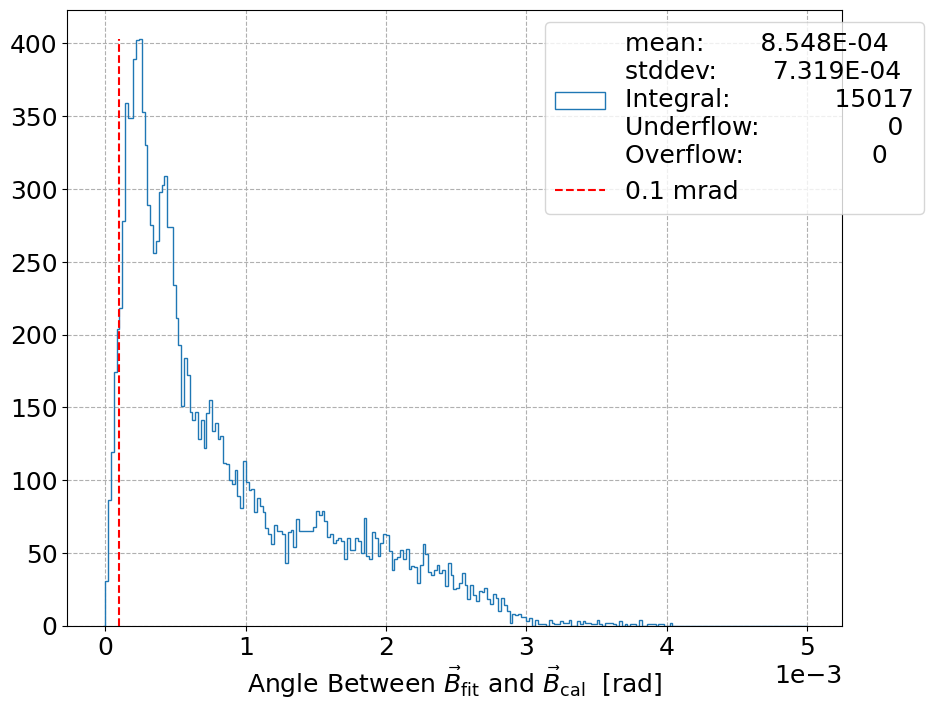

In [2344]:
# hist
fig, ax = plt.subplots()

#bins = np.arange(-0.12e-4, 10.02e-4, 2e-6)
bins = np.arange(-0.2e-4, 50.2e-4, 2e-5)
# bins = np.arange(-0.12e-4, 3.02e-4, 2e-6) ### GOOD!
# bins = np.arange(-5e-4, 5.05e-4, 5e-6)
# bins = np.arange(-1.50e-1, 2.52e-1, 2e-3)

n, _, _ = ax.hist(angle_bw, bins=bins, histtype='step', label=get_label(angle_bw, bins))

ym = np.max(n)
ax.plot([0.1e-3, 0.1e-3], [0, ym], 'r--', label='0.1 mrad')

#ax.set_xlabel(r'Angle Between $\vec{B}_{\mathrm{fit}}$ and $\vec{B}_{cal}}$  [rad]')
ax.set_xlabel(r'Angle Between $\vec{B}_{\mathrm{fit}}$'+r' and $\vec{B}_{\mathrm{cal}}$  [rad]')
ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
ax.legend(loc='upper left', bbox_to_anchor=(0.6, 1.0));

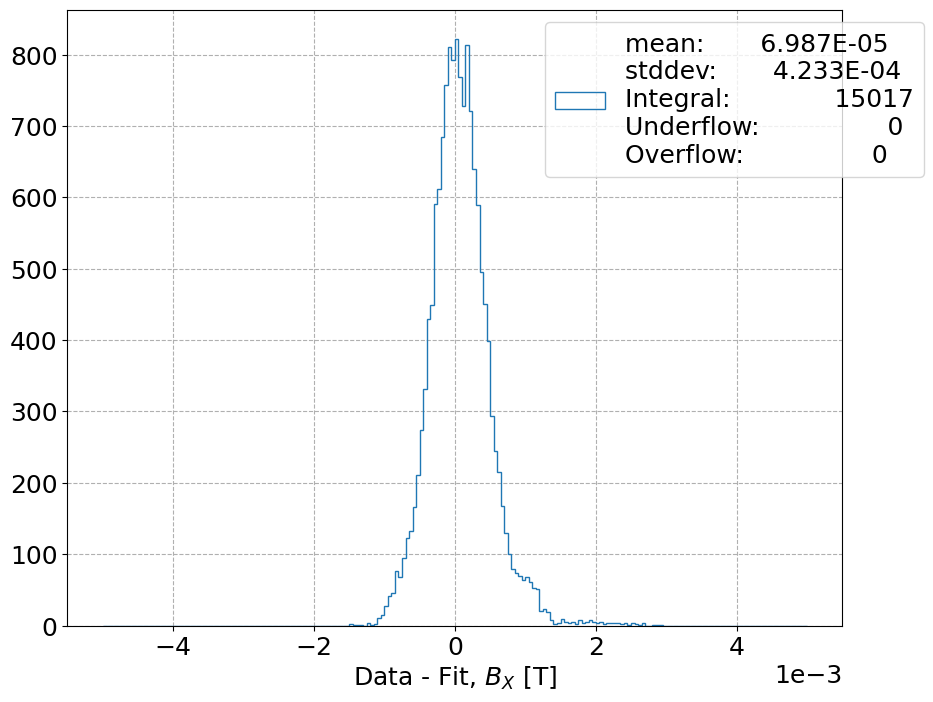

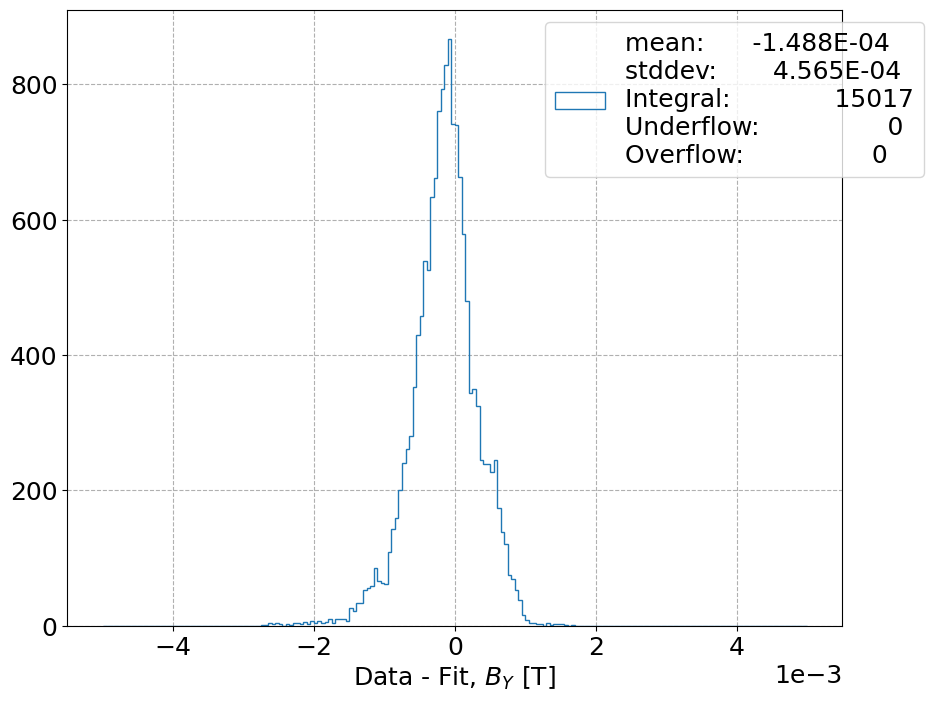

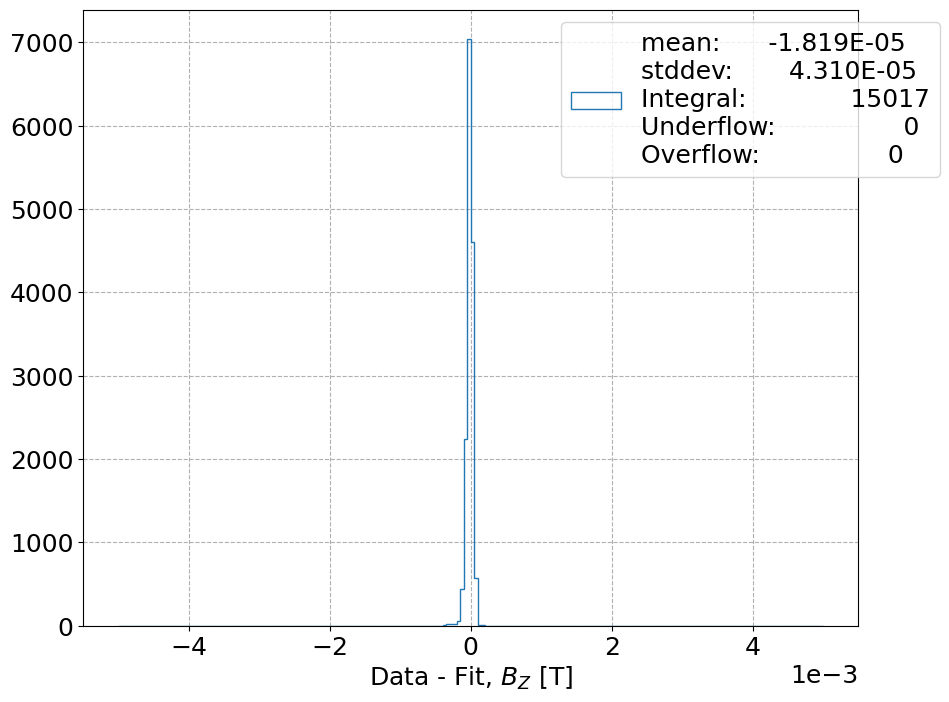

In [2347]:
for i, comp in enumerate(comps):
    dB = Bvec_meas[:,i] - Bvec_fit[:,i]
    # hist
    fig, ax = plt.subplots()
    
    #bins = np.arange(-1.50e-4, 1.52e-4, 2e-6)
    ###bins = np.arange(-5e-4, 5.05e-4, 5e-6)
    bins = np.arange(-5e-3, 5.05e-3, 5e-5)
    # bins = np.arange(-1e-3, 10.05e-4, 5e-6)
    # bins = np.arange(-1.50e-1, 2.52e-1, 2e-3)
    
    ##ax.hist(Bs_meas[ind0:ind1]-bf, bins=bins, histtype='step', label=get_label(Bs_meas[ind0:ind1]-bf, bins))
    ax.hist(dB, bins=bins, histtype='step', label=get_label(dB, bins))
    
    ax.set_xlabel(rf'Data - Fit, $B_{comp}$ [T]')
    ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))
    ax.legend(loc='upper left', bbox_to_anchor=(0.6, 1.0));

In [2201]:
### explore component residuals vs. indep vars

In [2202]:
#i = 'x'
#eval(f'dB = B{i} - B{i}_fit')

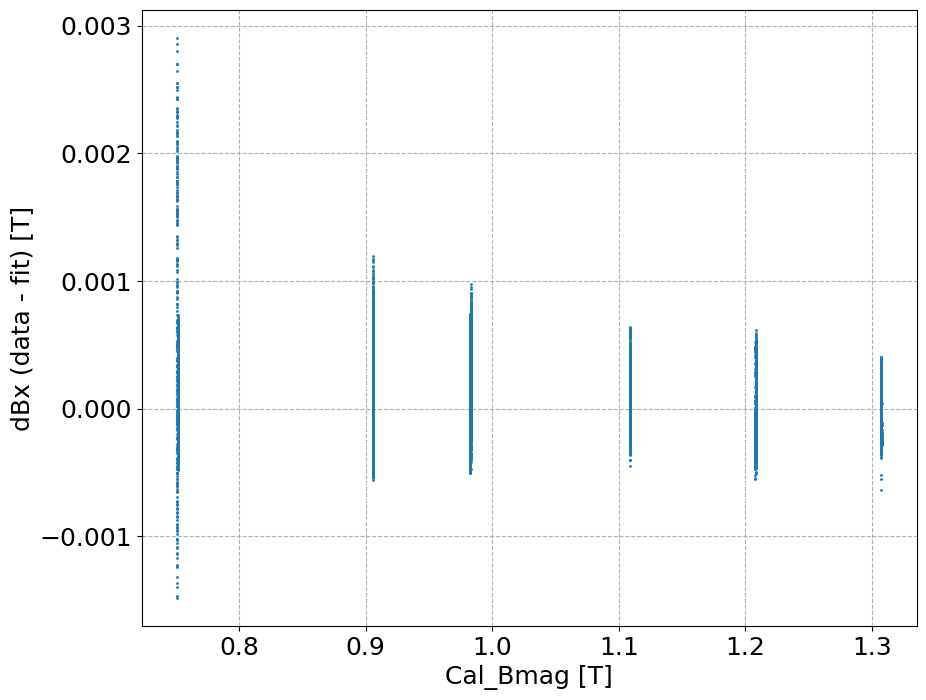

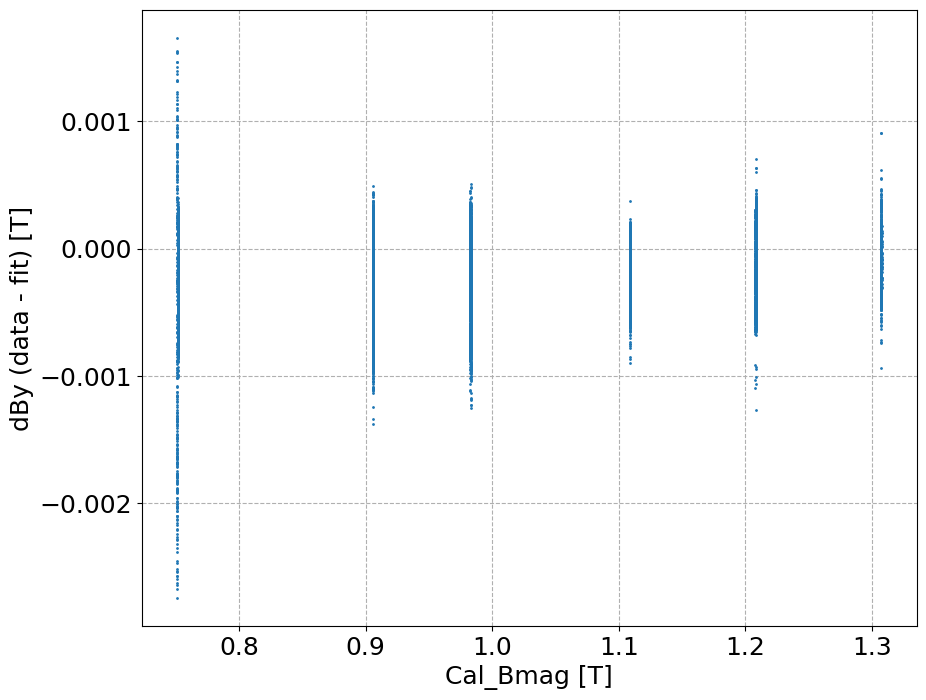

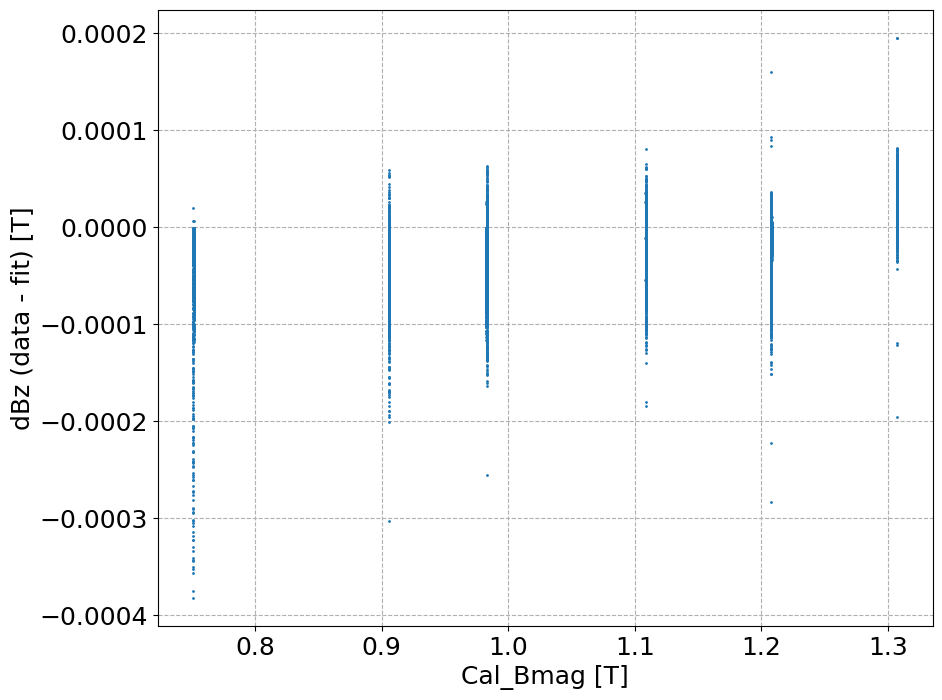

In [2203]:
# |B|
for i, comp in enumerate(['x', 'y', 'z']):
    dB = Bvec_meas[:,i] - Bvec_fit[:,i]
    fig, ax = plt.subplots()

    ax.scatter(dfplot['Cal_Bmag'], dB, s=1.)
    ax.set_xlabel('Cal_Bmag [T]')
    ax.set_ylabel(f'dB{comp} (data - fit) [T]')

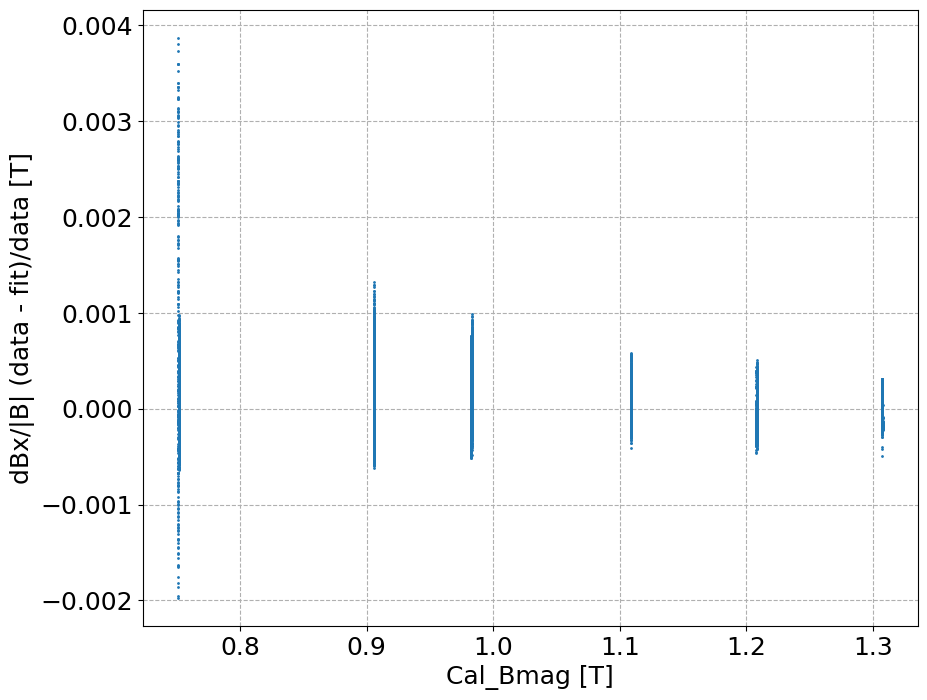

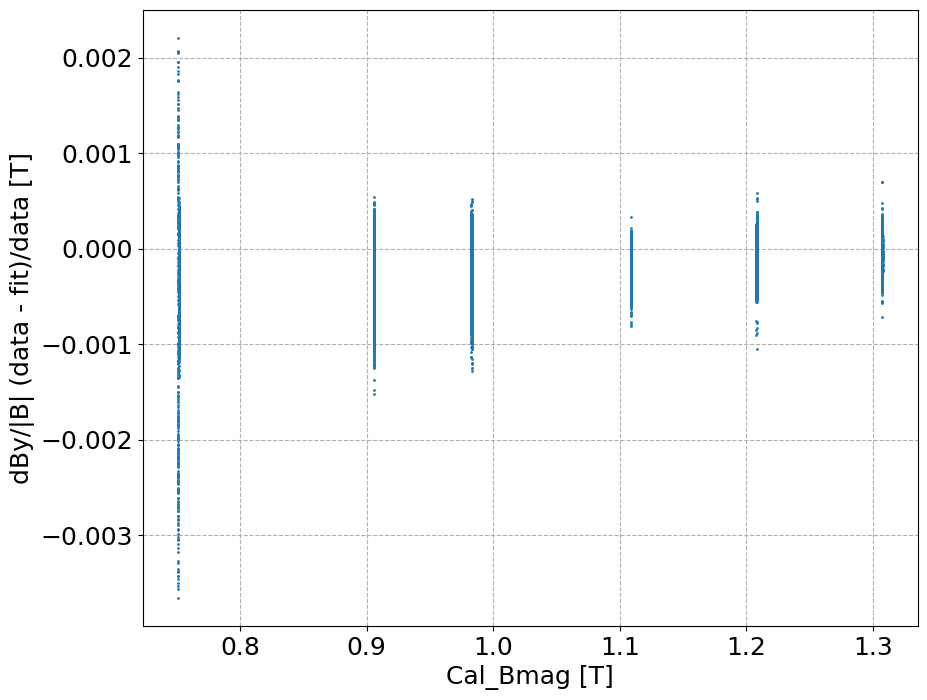

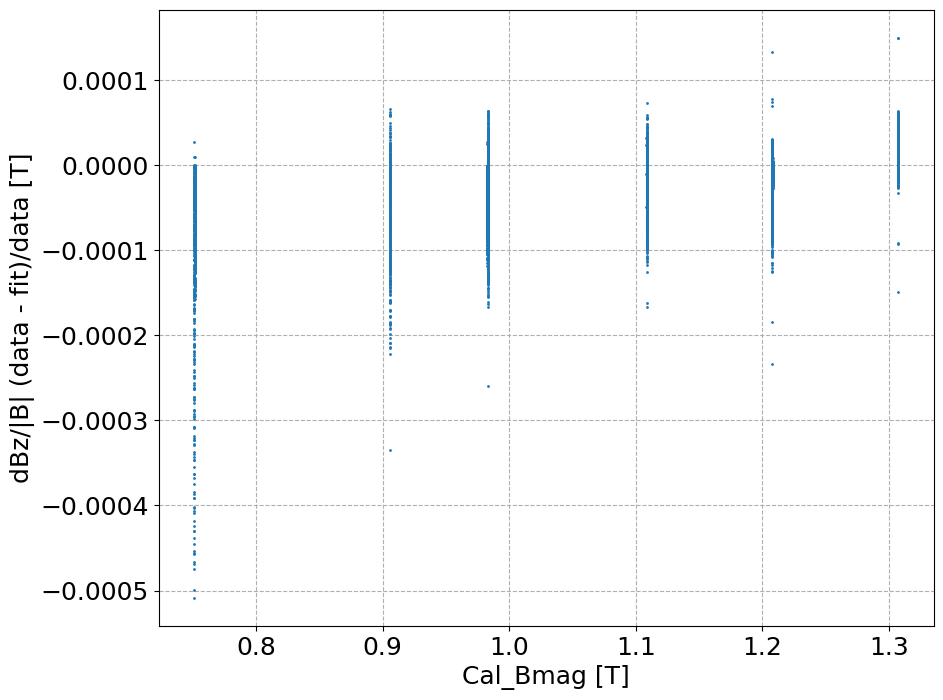

In [2204]:
# |B|, relative dB
for i, comp in enumerate(['x', 'y', 'z']):
    dB = Bvec_meas[:,i] - Bvec_fit[:,i]
    fig, ax = plt.subplots()

    ax.scatter(dfplot['Cal_Bmag'], dB/dfplot['Cal_Bmag'], s=1.)
    ax.set_xlabel('Cal_Bmag [T]')
    ax.set_ylabel(f'dB{comp}/|B| (data - fit)/data [T]')

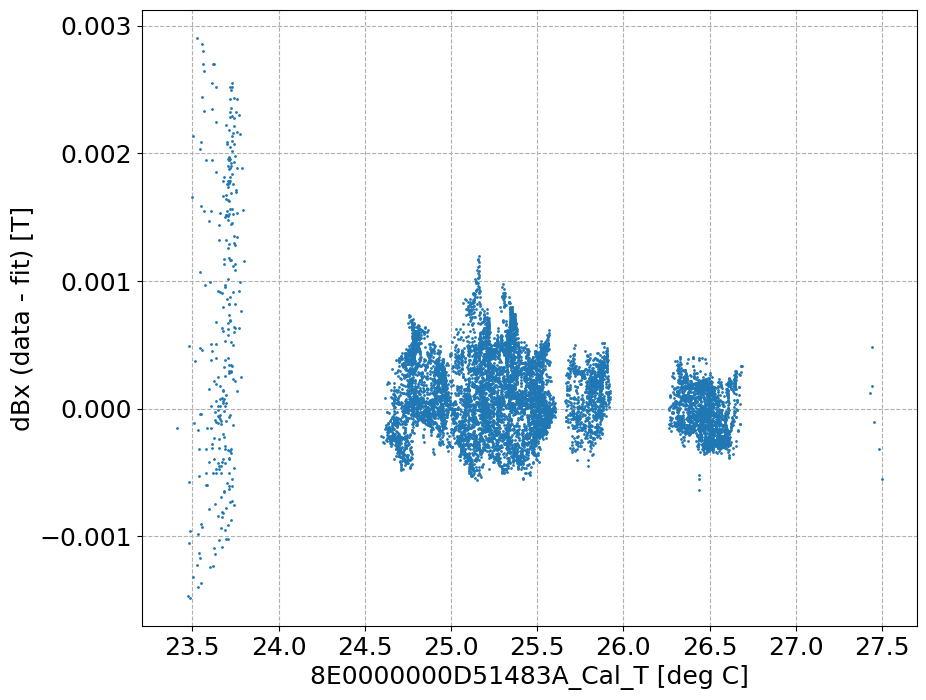

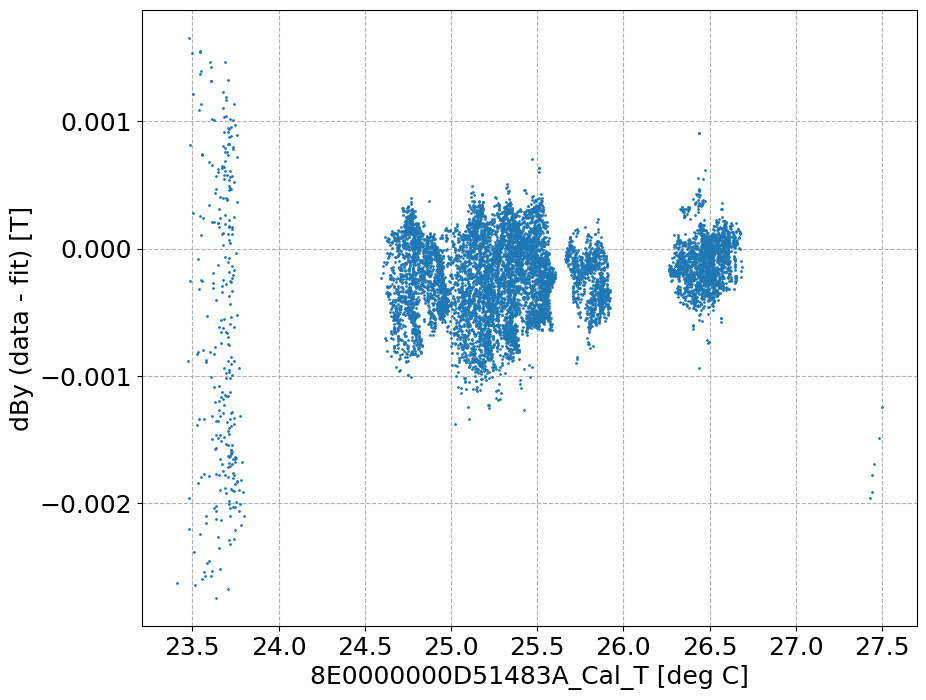

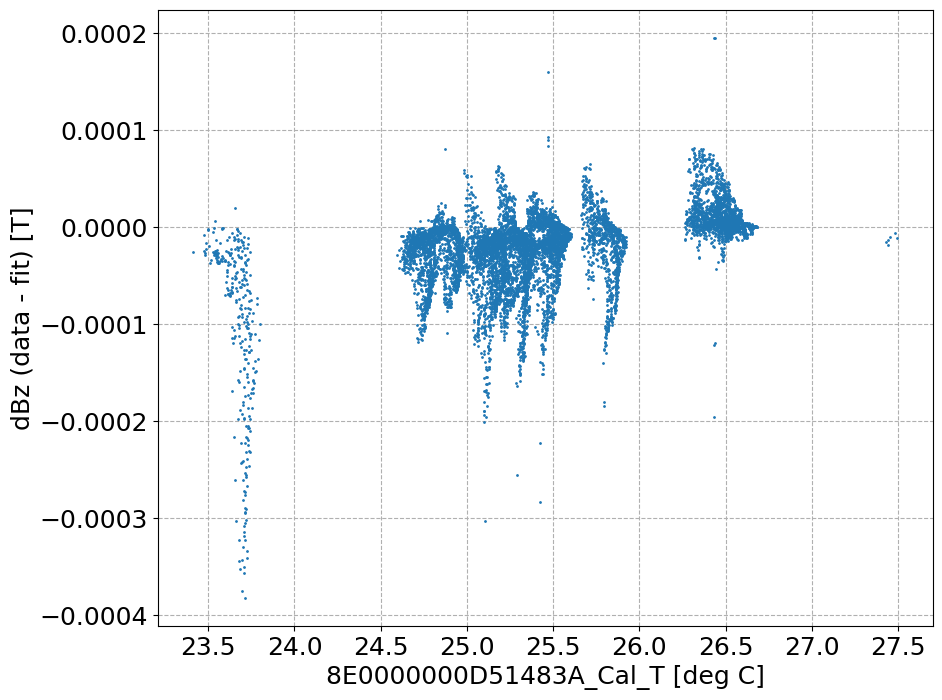

In [2205]:
# temp
for i, comp in enumerate(['x', 'y', 'z']):
    dB = Bvec_meas[:,i] - Bvec_fit[:,i]
    fig, ax = plt.subplots()

    ax.scatter(dfplot[f'{probe}_Cal_T'], dB, s=1.)
    ax.set_xlabel(f'{probe}_Cal_T [deg C]')
    ax.set_ylabel(f'dB{comp} (data - fit) [T]')

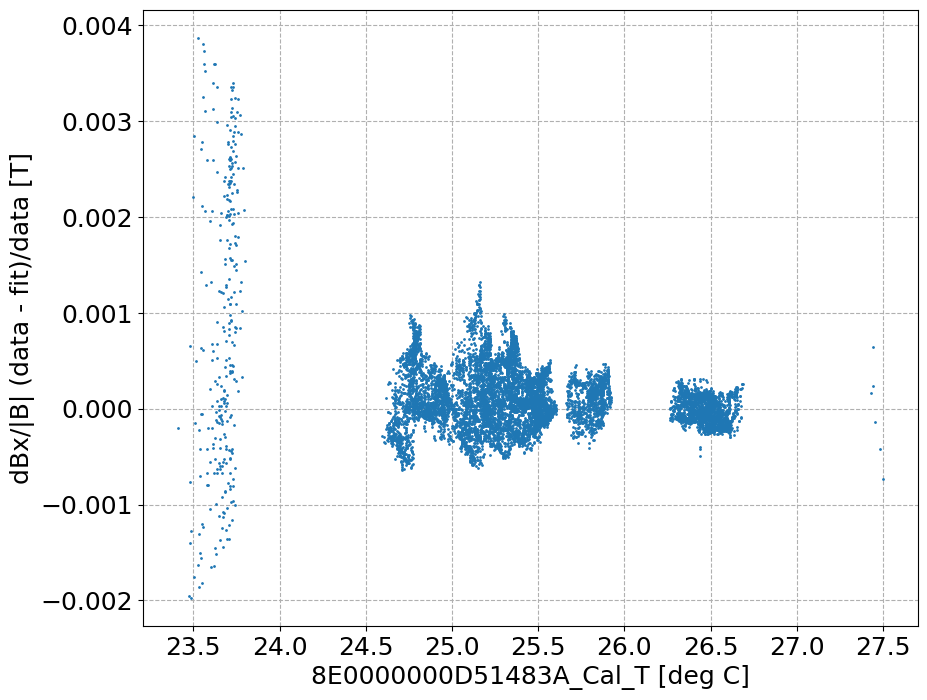

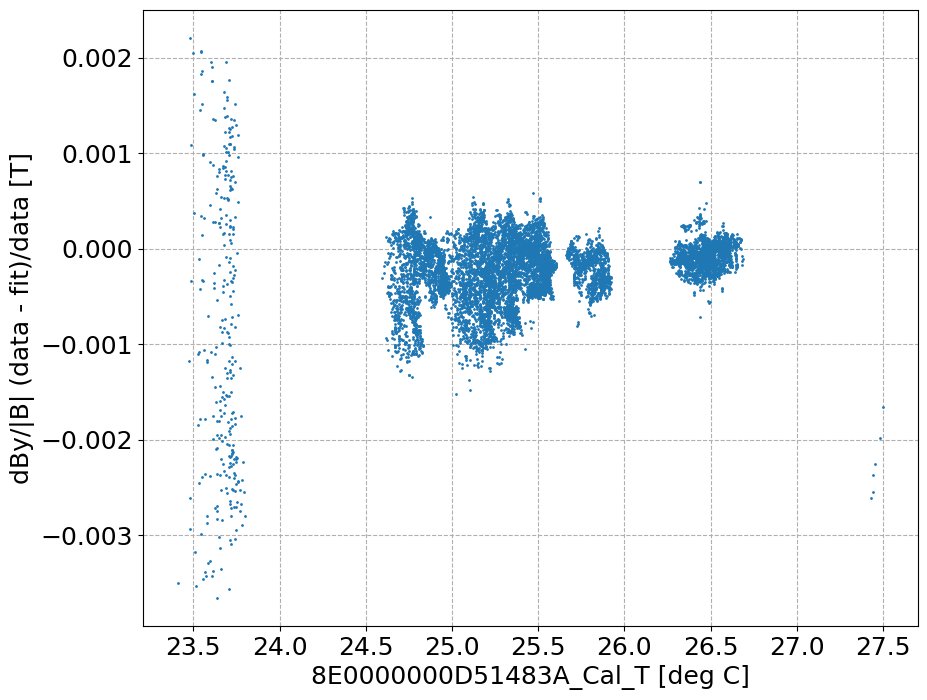

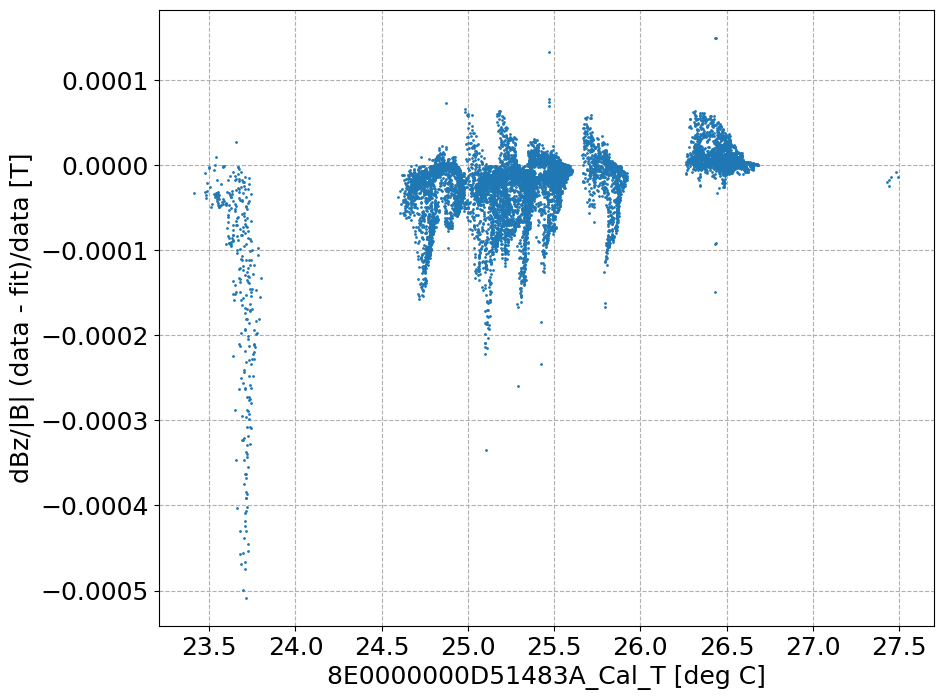

In [2206]:
# temp, relative dB
for i, comp in enumerate(['x', 'y', 'z']):
    dB = Bvec_meas[:,i] - Bvec_fit[:,i]
    fig, ax = plt.subplots()

    ax.scatter(dfplot[f'{probe}_Cal_T'], dB/dfplot['Cal_Bmag'], s=1.)
    ax.set_xlabel(f'{probe}_Cal_T [deg C]')
    ax.set_ylabel(f'dB{comp}/|B| (data - fit)/data [T]')

In [2207]:
# angle vs things
angle_bw

array([0.0035125 , 0.00296351, 0.00227871, ..., 0.00066678, 0.00058963,
       0.0007521 ])

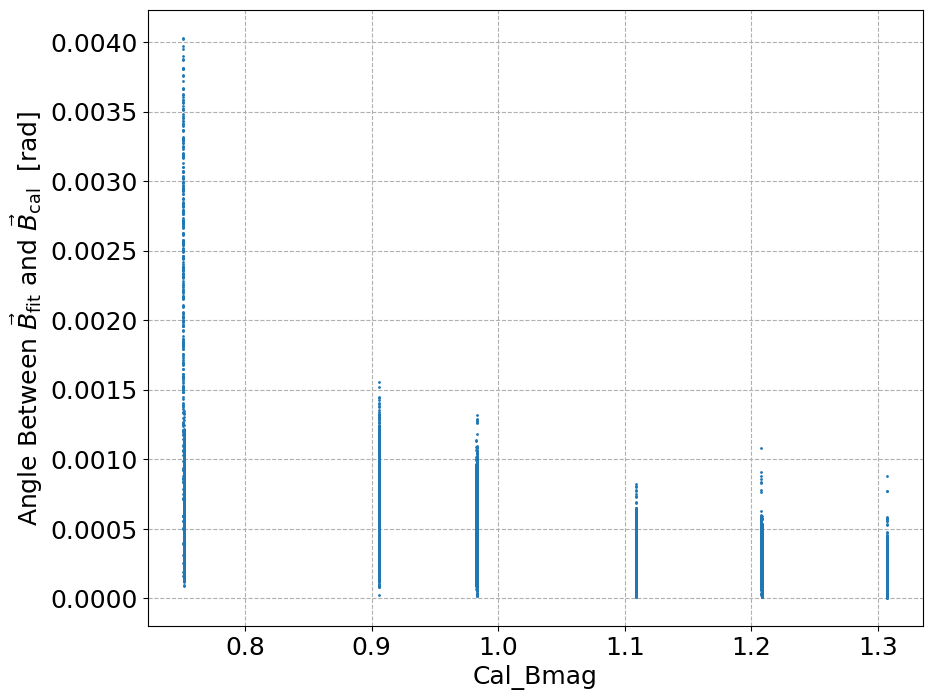

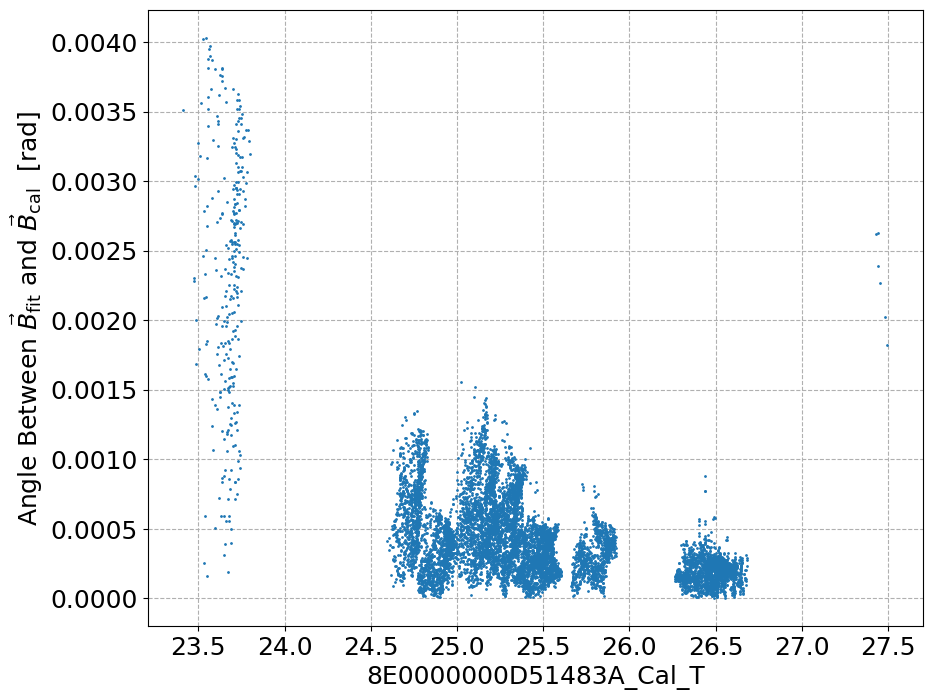

In [2208]:
# |B|
#for i, comp in enumerate(['x', 'y', 'z']):
    #dB = Bvec_meas[:,i] - Bvec_fit[:,i]
for xcol in ['Cal_Bmag', f'{probe}_Cal_T']:
    fig, ax = plt.subplots()
    
    ax.scatter(dfplot[xcol], angle_bw, s=1.)
    ax.set_xlabel(xcol)
    ax.set_ylabel(r'Angle Between $\vec{B}_{\mathrm{fit}}$'+r' and $\vec{B}_{\mathrm{cal}}$  [rad]')

### Fit Raw Values (based on orientation fit)

- Just repeat the function call, turning on "verbose" (theta and phi returned)

In [2351]:
from copy import deepcopy

In [2352]:
bf_params = deepcopy(result.params)
bf_params['verbose'].value = 1.0

In [2353]:
bf_params

name,value,standard error,relative error,initial value,min,max,vary
verbose,1.00000000,0.00000000,(0.00%),0.0,-inf,inf,False
theta,0.00947563,3.2207e-07,(0.00%),0.03490658503988659,-0.08726646,0.26179939,True
phi,0.06671124,2.6485e-05,(0.04%),0.0,-3.14159265,3.14159265,True
alpha,-0.00754342,6.3791e-07,(0.01%),0.03490658503988659,-0.08726646,0.26179939,True
beta,2.49356987,8.1427e-05,(0.00%),3.141592653589793,0.00000000,6.28318531,True
phase,0.45746628,2.6076e-05,(0.01%),0.0,-3.14159265,3.14159265,True
a0_sf,0.99742714,4.6389e-06,(0.00%),1.0,0.50000000,1.50000000,True
a1_sf,-0.99996145,1.3850e-06,(0.00%),-1.0,-1.50000000,-0.50000000,True


In [2354]:
sign_Bmag_bool = df['Magnet Current [A]'] < 0.
sign_Bmag = (2.*sign_Bmag_bool.astype(float) - 1.).values
#B_meas, norm_Hall, norm_B, norm_B_rot, BT_rot, theta, phi_Hall =
B_meas_full, _, _, _, _, theta, phi = model_func_CalibrationOrientationFit(df.SmarAct_Meas_Angle_1_Centered.values,
                                                        df.SmarAct_Meas_Angle_2_Centered.values,
                                                        sign_Bmag*df[f'{probe}_Cal_Bmag'].values,
                                                        **bf_params)

In [2355]:
N = len(df)
### X
# coord = 'X'
ind0x = 0
ind1x = 1*N
### Y
# coord = 'Y'
ind0y = 1*N
ind1y = 2*N
### Z
# coord = 'Z'
ind0z = 2*N
ind1z = 3*N
####
Bx_fit_full = B_meas_full[ind0x:ind1x]
By_fit_full = B_meas_full[ind0y:ind1y]
Bz_fit_full = B_meas_full[ind0z:ind1z]

In [2356]:
df.loc[:, 'Bx_true'] = Bx_fit_full
df.loc[:, 'By_true'] = By_fit_full
df.loc[:, 'Bz_true'] = Bz_fit_full
df.loc[:, 'theta_B_true'] = theta
df.loc[:, 'phi_B_true'] = phi
df.loc[:, 'theta_B_true_deg'] = np.degrees(theta)
df.loc[:, 'phi_B_true_deg'] = np.degrees(phi)

In [2357]:
# do we query a particular run?
# negative polarity
# df_ = df.query(f'(`Magnet Current [A]` < 0.) ' 
#                #+f'& (0.97 <= B_corr <=0.99) '
#                # +f'& (18.5 <= `{probe}_Cal_T` <= 21.5) '
#                #+f'& (23. <= `{probe}_Cal_T` <= 27.5) '
#                # +f'& (`{probe}_Cal_T` <= 18.0) '
#                # + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 10.)'
#                + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 14.)'
#               ).copy()
###
# pick a specific field strength or temp
###df_ = df.query(f'(`Magnet Current [A]` < 0.) '
df_ = df.query(
               #f'(`Magnet Current [A]` > 0.) '
               f'(`Magnet Current [A]` > -10000.) '
               ##+f'& (0.97 <= B_corr <=0.99) '
               ###+f'& (0.7 <= B_corr) ' # can get pretty good results here
               # +f'& (18.5 <= `{probe}_Cal_T` <= 21.5) '
               +f'& (23. <= `{probe}_Cal_T` <= 27.5) '
               # +f'& (`{probe}_Cal_T` <= 18.0) '
               # + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 10.)'
               ###+ f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 14.)'
               ##+ f'& (1.0 < `SmarAct_Meas_Angle_1_Centered`)'
               # + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 13.)'
               + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` <= 13.)'
               + f'& (0. <= theta_B_true_deg <= 13.)'
              ).copy()

In [2358]:
df_.columns

Index(['Time', 'Magnet Current [A]', 'Magnet Voltage [V]', 'NMR [T]',
       'NMR [FFT]', '8E0000000D51483A_Raw_X', '8E0000000D51483A_Raw_Y',
       '8E0000000D51483A_Raw_Z', '8E0000000D51483A_Raw_T',
       '8E0000000D51483A_Cal_X', '8E0000000D51483A_Cal_Y',
       '8E0000000D51483A_Cal_Z', '8E0000000D51483A_Cal_T',
       'SmarAct_Pattern_Angle_1', 'SmarAct_Pattern_Angle_2',
       'SmarAct_Meas_Angle_1', 'SmarAct_Meas_Rotation_Angle_1',
       'SmarAct_Meas_Angle_2', 'SmarAct_Meas_Rotation_Angle_2',
       'seconds_delta', 'hours_delta', 'days_delta', 'run_type',
       'expected_field', 'polarity', 'chiller_temp_F',
       '8E0000000D51483A_Raw_Bmag', '8E0000000D51483A_Raw_Theta',
       '8E0000000D51483A_Raw_Phi', '8E0000000D51483A_Cal_Bmag',
       '8E0000000D51483A_Cal_Theta', '8E0000000D51483A_Cal_Phi',
       '8E0000000D51483A_Cal_Theta2', '8E0000000D51483A_Cal_Phi2',
       'Magnet Resistance [Ohm]', 'Coil Resistance [Ohm]', 'Magnet Power [W]',
       'SmarAct_Meas_Angle_1_Ce

In [2359]:
len(df), len(df_)

(99679, 14843)

In [2360]:
# rescale temperature
# tmax = 40.
# tmin = 10.
tmax = df_[f'{probe}_Cal_T'].max()
tmin = df_[f'{probe}_Cal_T'].min()
t_sub = (tmax + tmin) / 2
t_div = (tmax - tmin) / 2
ts_scaled = (df_[f'{probe}_Cal_T'].values - t_sub) / t_div
df_.loc[:, f'{probe}_Cal_T_rescaled'] = ts_scaled
# field
sign_Bmag_bool = df_['Magnet Current [A]'] < 0.
sign_Bmag = (2.*sign_Bmag_bool.astype(float) - 1.).values
bmax = (sign_Bmag*df_['B_corr']).max()
bmin = (sign_Bmag*df_['B_corr']).min()
b_sub = (bmax + bmin) / 2
b_div = (bmax - bmin) / 2
bs_scaled = ((sign_Bmag*df_['B_corr'].values) - b_sub) / b_div
df_.loc[:, 'B_corr_rescaled'] = bs_scaled

In [2361]:
tmax, tmin

(27.497, 23.411)

In [2362]:
bmax, bmin, bmax-bmin

(1.3075973941441317, -1.3076040650048955, 2.615201459149027)

In [2363]:
# expected change from field strength
(bmax-bmin) * 2.863e6

7487321.777543665

In [2364]:
df_.loc[:, 'B_corr_rescaled'].describe()

count    14843.000000
mean         0.049594
std          0.697541
min         -1.000000
25%         -0.692925
50%          0.240374
75%          0.692754
max          1.000000
Name: B_corr_rescaled, dtype: float64

In [2515]:
def simultaneous_fit_rot_temp_B(theta, phi, temp_rescaled, B_rescaled, **params):
    # how many B terms to include?
    kmax = params['kmax']
    # how many temperature terms to include?
    nmax = params['nmax']
    # angular info
    B_n_vec = np.array([np.sin(theta) * np.cos(phi), np.sin(theta) * np.sin(phi), np.cos(theta)]).T
    rot = Rotation.from_euler('XYZ', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
    B_n_vec_rot = rot.apply(B_n_vec)
    B_n_T = np.linalg.norm(B_n_vec_rot[:,:2], axis=1)
    B_n = np.linalg.norm(B_n_vec_rot, axis=1)
    costheta = B_n_vec_rot[:, 2] / B_n
    sintheta = B_n_T / B_n
    cosphi = B_n_vec_rot[:, 0] / B_n_T
#     sinphi = B_n_vec_rot[:, 1] / B_n_T
    
    result = np.zeros_like(theta)
    # loop through B Chebyshev
    for k in range(kmax+1):
        # turn on appropriate Chebyshev term
        coeffs_k = np.zeros(kmax+1)
        coeffs_k[k] = 1.
        T_k = np.polynomial.chebyshev.chebval(B_rescaled, coeffs_k)
        # loop through Temp Chebyshev
        for n in range(nmax+1):
            # turn on appropriate Chebyshev term
            coeffs_n = np.zeros(nmax+1)
            coeffs_n[n] = 1.
            T_n = np.polynomial.chebyshev.chebval(temp_rescaled, coeffs_n)
            # angular encodes the coefficient values
            # coeff "CNLM" -- C_nlm
            angular = params[f'C{k}{n}00'] + params[f'C{k}{n}10'] * costheta + params[f'C{k}{n}20'] * (3*costheta**2 - 1) + params[f'C{k}{n}22'] * (2*cosphi**2 - 1)*(sintheta**2) \
            + params[f'C{k}{n}30'] * (5*costheta**3 - 3*costheta) + params[f'C{k}{n}32'] * (2*cosphi**2 - 1)*(sintheta**2)*costheta
            result += T_k * T_n * angular
    
    return result

def get_simultaneous_fit_rot_temp_B_v2(theta, phi, temp_rescaled, B_rescaled, **params):
    # calculate and save the spherical harmonics once only
    ## ACTUALLY DOES NOT WORK AS ALPHA BETA GAMMA FLOATING
    # Y_lm_dict = {}
    # for l in range(params['lmax']+1):
    #     Y_lm_dict[l] = {}
    #     for m in range(0, min(l, params['mmax']) + 1):
    #         # note reverse convention of phi/theta that scipy uses
    #         #Y_lm_dict[l][m] = sph_harm(m=m, n=l, theta=phi, phi=theta).real
    #         # note positional arguments expected
    #         #Y_lm_dict[l][m] = sph_harm(m, l, phi, theta).real
    #         # sph_harm_y has the normal convention
    #         #Y_lm_dict[l][m] = sph_harm_y(n=l, m=m, theta=theta, phi=phi).real
    #         # note positional arguments expected
    #         Y_lm_dict[l][m] = sph_harm_y(l, m, theta, phi).real
    # other things we can calculate once
    #B_n_vec = np.array([np.sin(theta) * np.cos(phi), np.sin(theta) * np.sin(phi), np.cos(theta)]).T
            
    def model_func(theta, phi, temp_rescaled, B_rescaled, **params):
        theta = np.atleast_1d(theta)[0]
        phi = np.atleast_1d(phi)[0]
        temp_rescaled = np.atleast_1d(temp_rescaled)[0]
        B_rescaled = np.atleast_1d(B_rescaled)[0]
        # how many B terms to include?
        kmax = params['kmax']
        # how many temperature terms to include?
        nmax = params['nmax']
        # angular info
        B_n_vec = np.array([np.sin(theta) * np.cos(phi), np.sin(theta) * np.sin(phi), np.cos(theta)]).T
        # reshape for scalar input
        B_n_vec = B_n_vec.reshape((-1, 3))
        rot = Rotation.from_euler('XYZ', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
        #rot = Rotation.from_euler('XZX', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
        #rot = Rotation.from_euler('XZY', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
        #rot = Rotation.from_euler('xyz', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
        # rot = Rotation.from_euler('ZYX', angles=np.array([params['gamma'], params['beta'], params['alpha']]), degrees=False)
        B_n_vec_rot = rot.apply(B_n_vec)
        B_n_T = np.linalg.norm(B_n_vec_rot[:,:2], axis=1)
        B_n = np.linalg.norm(B_n_vec_rot, axis=1)
        costheta = B_n_vec_rot[:, 2] / B_n
        sintheta = B_n_T / B_n
        cosphi = B_n_vec_rot[:, 0] / B_n_T
    #     sinphi = B_n_vec_rot[:, 1] / B_n_T
        theta_ = np.arccos(costheta)
        phi_ = np.arccos(cosphi)
        
        
        #result = np.zeros_like(theta)
        result = np.zeros_like(theta_)
        # loop through B Chebyshev
        for k in range(kmax+1):
            # turn on appropriate Chebyshev term
            coeffs_k = np.zeros(kmax+1)
            coeffs_k[k] = 1.
            T_k = np.polynomial.chebyshev.chebval(B_rescaled, coeffs_k)
            # loop through Temp Chebyshev
            for n in range(nmax+1):
                # turn on appropriate Chebyshev term
                coeffs_n = np.zeros(nmax+1)
                coeffs_n[n] = 1.
                T_n = np.polynomial.chebyshev.chebval(temp_rescaled, coeffs_n)
                # angular encodes the coefficient values
                # coeff "CKNLM" -- C_knlm
                #angular = np.zeros_like(theta)
                angular = np.zeros_like(theta_)
                for l in range(params['lmax']+1):
                    for m in range(0, min(l, params['mmax']) + 1):
                        key = f'C_{k}_{n}_{l}_{m}'
                        #if key not in params:
                        #    continue
                        #angular += params[key] * Y_lm_dict[l][m]
                        angular += params[key] * sph_harm_y(l, m, theta_, phi_).real
                #angular = params[f'C{k}{n}00'] + params[f'C{k}{n}10'] * costheta + params[f'C{k}{n}20'] * (3*costheta**2 - 1) + params[f'C{k}{n}22'] * (2*cosphi**2 - 1)*(sintheta**2) \
                #+ params[f'C{k}{n}30'] * (5*costheta**3 - 3*costheta) + params[f'C{k}{n}32'] * (2*cosphi**2 - 1)*(sintheta**2)*costheta
                result += T_k * T_n * angular
        
        return result
    return model_func


def get_simultaneous_fit_rot_temp_B_abg_fixed(theta, phi, temp_rescaled, B_rescaled, **params):
    # assumes fixed alpha, beta, gamma (final fit)
    B_n_vec = np.array([np.sin(theta) * np.cos(phi), np.sin(theta) * np.sin(phi), np.cos(theta)]).T
    rot = Rotation.from_euler('XYZ', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
    #rot = Rotation.from_euler('XZX', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
    #rot = Rotation.from_euler('XZY', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
    #rot = Rotation.from_euler('xyz', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
    # rot = Rotation.from_euler('ZYX', angles=np.array([params['gamma'], params['beta'], params['alpha']]), degrees=False)
    B_n_vec_rot = rot.apply(B_n_vec)
    B_n_T = np.linalg.norm(B_n_vec_rot[:,:2], axis=1)
    B_n = np.linalg.norm(B_n_vec_rot, axis=1)
    costheta = B_n_vec_rot[:, 2] / B_n
    sintheta = B_n_T / B_n
    cosphi = B_n_vec_rot[:, 0] / B_n_T
#     sinphi = B_n_vec_rot[:, 1] / B_n_T
    theta_ = np.arccos(costheta)
    phi_ = np.arccos(cosphi)
    # calculate and save the spherical harmonics once only
    lmax = params['lmax']
    mmax = params['mmax']
    Y_lm_dict = {}
    for l in range(lmax+1):
        Y_lm_dict[l] = {}
        for m in range(0, min(l, mmax) + 1):
            # note reverse convention of phi/theta that scipy uses
            #Y_lm_dict[l][m] = sph_harm(m=m, n=l, theta=phi, phi=theta).real
            # note positional arguments expected
            #Y_lm_dict[l][m] = sph_harm(m, l, phi, theta).real
            # sph_harm_y has the normal convention
            #Y_lm_dict[l][m] = sph_harm_y(n=l, m=m, theta=theta, phi=phi).real
            # note positional arguments expected
            Y_lm_dict[l][m] = sph_harm_y(l, m, theta_, phi_).real
    # chebyshev
    kmax = params['kmax']
    nmax = params['nmax']
    T_k_dict = {}
    T_n_dict = {}
    for k in range(kmax+1):
        # turn on appropriate Chebyshev term
        coeffs_k = np.zeros(kmax+1)
        coeffs_k[k] = 1.
        T_k = np.polynomial.chebyshev.chebval(B_rescaled, coeffs_k)
        T_k_dict[k] = T_k
    for n in range(nmax+1):
        # turn on appropriate Chebyshev term
        coeffs_n = np.zeros(nmax+1)
        coeffs_n[n] = 1.
        T_n = np.polynomial.chebyshev.chebval(temp_rescaled, coeffs_n)
        T_n_dict[n] = T_n    
        
    def model_func(theta, phi, temp_rescaled, B_rescaled, **params):
        # how many B terms to include?
        #kmax = params['kmax']
        # how many temperature terms to include?
        #nmax = params['nmax']
        # angular info
        # B_n_vec = np.array([np.sin(theta) * np.cos(phi), np.sin(theta) * np.sin(phi), np.cos(theta)]).T
        # rot = Rotation.from_euler('XYZ', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
        # B_n_vec_rot = rot.apply(B_n_vec)
        # B_n_T = np.linalg.norm(B_n_vec_rot[:,:2], axis=1)
        # B_n = np.linalg.norm(B_n_vec_rot, axis=1)
        # costheta = B_n_vec_rot[:, 2] / B_n
        # sintheta = B_n_T / B_n
        # cosphi = B_n_vec_rot[:, 0] / B_n_T
        # #sinphi = B_n_vec_rot[:, 1] / B_n_T
        # theta_ = np.arccos(costheta)
        # phi_ = np.arccos(cosphi)
        
        
        result = np.zeros_like(theta)
        # loop through B Chebyshev
        for k in range(kmax+1):
            # turn on appropriate Chebyshev term
            # coeffs_k = np.zeros(kmax+1)
            # coeffs_k[k] = 1.
            # T_k = np.polynomial.chebyshev.chebval(B_rescaled, coeffs_k)
            T_k = T_k_dict[k]
            # loop through Temp Chebyshev
            for n in range(nmax+1):
                # turn on appropriate Chebyshev term
                # coeffs_n = np.zeros(nmax+1)
                # coeffs_n[n] = 1.
                # T_n = np.polynomial.chebyshev.chebval(temp_rescaled, coeffs_n)
                T_n = T_n_dict[n]
                # angular encodes the coefficient values
                # coeff "CKNLM" -- C_knlm
                angular = np.zeros_like(theta)
                for l in range(params['lmax']+1):
                    for m in range(0, min(l, params['mmax']) + 1):
                        key = f'C_{k}_{n}_{l}_{m}'
                        #if key not in params:
                        #    continue
                        angular += params[key] * Y_lm_dict[l][m]
                        # angular += params[key] * sph_harm_y(l, m, theta_, phi_).real
                #angular = params[f'C{k}{n}00'] + params[f'C{k}{n}10'] * costheta + params[f'C{k}{n}20'] * (3*costheta**2 - 1) + params[f'C{k}{n}22'] * (2*cosphi**2 - 1)*(sintheta**2) \
                #+ params[f'C{k}{n}30'] * (5*costheta**3 - 3*costheta) + params[f'C{k}{n}32'] * (2*cosphi**2 - 1)*(sintheta**2)*costheta
                result += T_k * T_n * angular
                ###result += T_k_dict[k] * T_n_dict[n] * angular
        
        return result
    return model_func

def get_simultaneous_fit_rot_temp_B_abg_float(theta, phi, temp_rescaled, B_rescaled, **params):
    # assumes fixed alpha, beta, gamma (final fit)
    #B_n_vec = np.array([np.sin(theta) * np.cos(phi), np.sin(theta) * np.sin(phi), np.cos(theta)]).T
    #rot = Rotation.from_euler('XYZ', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
    #rot = Rotation.from_euler('XZX', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
    #rot = Rotation.from_euler('XZY', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
    #B_n_vec_rot = rot.apply(B_n_vec)
    #B_n_T = np.linalg.norm(B_n_vec_rot[:,:2], axis=1)
    #B_n = np.linalg.norm(B_n_vec_rot, axis=1)
    #costheta = B_n_vec_rot[:, 2] / B_n
    #sintheta = B_n_T / B_n
    #cosphi = B_n_vec_rot[:, 0] / B_n_T
#     sinphi = B_n_vec_rot[:, 1] / B_n_T
    #theta_ = np.arccos(costheta)
    #phi_ = np.arccos(cosphi)
    # calculate and save the spherical harmonics once only
    lmax = params['lmax']
    mmax = params['mmax']
    # Y_lm_dict = {}
    # for l in range(lmax+1):
    #     Y_lm_dict[l] = {}
    #     for m in range(0, min(l, mmax) + 1):
    #         # note reverse convention of phi/theta that scipy uses
    #         #Y_lm_dict[l][m] = sph_harm(m=m, n=l, theta=phi, phi=theta).real
    #         # note positional arguments expected
    #         #Y_lm_dict[l][m] = sph_harm(m, l, phi, theta).real
    #         # sph_harm_y has the normal convention
    #         #Y_lm_dict[l][m] = sph_harm_y(n=l, m=m, theta=theta, phi=phi).real
    #         # note positional arguments expected
    #         Y_lm_dict[l][m] = sph_harm_y(l, m, theta_, phi_).real
    # chebyshev
    kmax = params['kmax']
    nmax = params['nmax']
    T_k_dict = {}
    T_n_dict = {}
    for k in range(kmax+1):
        # turn on appropriate Chebyshev term
        coeffs_k = np.zeros(kmax+1)
        coeffs_k[k] = 1.
        T_k = np.polynomial.chebyshev.chebval(B_rescaled, coeffs_k)
        T_k_dict[k] = T_k
    for n in range(nmax+1):
        # turn on appropriate Chebyshev term
        coeffs_n = np.zeros(nmax+1)
        coeffs_n[n] = 1.
        T_n = np.polynomial.chebyshev.chebval(temp_rescaled, coeffs_n)
        T_n_dict[n] = T_n    
        
    def model_func(theta, phi, temp_rescaled, B_rescaled, **params):
        theta = np.atleast_1d(theta)[0]
        phi = np.atleast_1d(phi)[0]
        temp_rescaled = np.atleast_1d(temp_rescaled)[0]
        B_rescaled = np.atleast_1d(B_rescaled)[0]
        # how many B terms to include?
        #kmax = params['kmax']
        # how many temperature terms to include?
        #nmax = params['nmax']
        # angular info
        B_n_vec = np.array([np.sin(theta) * np.cos(phi), np.sin(theta) * np.sin(phi), np.cos(theta)]).T
        # reshape for scalar input
        B_n_vec = B_n_vec.reshape((-1, 3))
        #print(f'B_n_vec={B_n_vec} (shape={B_n_vec.shape})')
        rot = Rotation.from_euler('XYZ', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
        #rot = Rotation.from_euler('XZX', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
        #rot = Rotation.from_euler('XZY', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
        # rot = Rotation.from_euler('xyz', angles=np.array([params['alpha'], params['beta'], params['gamma']]), degrees=False)
        # rot = Rotation.from_euler('ZYX', angles=np.array([params['gamma'], params['beta'], params['alpha']]), degrees=False)
        B_n_vec_rot = rot.apply(B_n_vec)
        #print(f'B_n_vec_rot={B_n_vec_rot} (shape={B_n_vec_rot.shape})')
        B_n_T = np.linalg.norm(B_n_vec_rot[:,:2], axis=1)
        B_n = np.linalg.norm(B_n_vec_rot, axis=1)
        costheta = B_n_vec_rot[:, 2] / B_n
        sintheta = B_n_T / B_n
        cosphi = B_n_vec_rot[:, 0] / B_n_T
        #sinphi = B_n_vec_rot[:, 1] / B_n_T
        theta_ = np.arccos(costheta)
        phi_ = np.arccos(cosphi)
        
        
        #result = np.zeros_like(theta)
        result = np.zeros_like(theta_)
        # loop through B Chebyshev
        for k in range(kmax+1):
            # turn on appropriate Chebyshev term
            # coeffs_k = np.zeros(kmax+1)
            # coeffs_k[k] = 1.
            # T_k = np.polynomial.chebyshev.chebval(B_rescaled, coeffs_k)
            T_k = T_k_dict[k]
            # loop through Temp Chebyshev
            for n in range(nmax+1):
                # turn on appropriate Chebyshev term
                # coeffs_n = np.zeros(nmax+1)
                # coeffs_n[n] = 1.
                # T_n = np.polynomial.chebyshev.chebval(temp_rescaled, coeffs_n)
                T_n = T_n_dict[n]
                # angular encodes the coefficient values
                # coeff "CKNLM" -- C_knlm
                ##angular = np.zeros_like(theta)
                angular = np.zeros_like(theta_)
                for l in range(params['lmax']+1):
                    for m in range(0, min(l, params['mmax']) + 1):
                        key = f'C_{k}_{n}_{l}_{m}'
                        #if key not in params:
                        #    continue
                        # angular += params[key] * Y_lm_dict[l][m]
                        angular += params[key] * sph_harm_y(l, m, theta_, phi_).real
                #angular = params[f'C{k}{n}00'] + params[f'C{k}{n}10'] * costheta + params[f'C{k}{n}20'] * (3*costheta**2 - 1) + params[f'C{k}{n}22'] * (2*cosphi**2 - 1)*(sintheta**2) \
                #+ params[f'C{k}{n}30'] * (5*costheta**3 - 3*costheta) + params[f'C{k}{n}32'] * (2*cosphi**2 - 1)*(sintheta**2)*costheta
                result += T_k * T_n * angular
                ###result += T_k_dict[k] * T_n_dict[n] * angular
        
        return result
    return model_func

### TMP

In [2366]:
Vm = df_[f'{probe}_Raw_Z'].abs().max()
if abs(df_[f'{probe}_Raw_Z'].max()) > abs(df_[f'{probe}_Raw_Z'].min()):
    pass
else:
    Vm = -1 * Vm
Vm

-3688590.0

In [2367]:
thetas = np.linspace(0, 2*np.pi, 100)
phis = 0.

In [2368]:
sph_harm_y(1, 0, thetas, phis).real

array([ 0.48860251,  0.4876188 ,  0.48467161,  0.47977283,  0.47294217,
        0.46420713,  0.4536029 ,  0.44117217,  0.426965  ,  0.41103859,
        0.39345707,  0.37429124,  0.35361827,  0.3315214 ,  0.30808962,
        0.28341726,  0.25760369,  0.23075283,  0.20297282,  0.1743755 ,
        0.14507604,  0.11519241,  0.08484494,  0.05415582,  0.02324864,
       -0.00775215, -0.03872173, -0.06953539, -0.10006905, -0.13019977,
       -0.15980623, -0.1887692 , -0.21697206, -0.24430126, -0.27064673,
       -0.29590241, -0.3199666 , -0.34274239, -0.36413808, -0.38406752,
       -0.40245045, -0.41921285, -0.43428723, -0.44761289, -0.45913617,
       -0.46881068, -0.47659744, -0.48246512, -0.48639008, -0.48835652,
       -0.48835652, -0.48639008, -0.48246512, -0.47659744, -0.46881068,
       -0.45913617, -0.44761289, -0.43428723, -0.41921285, -0.40245045,
       -0.38406752, -0.36413808, -0.34274239, -0.3199666 , -0.29590241,
       -0.27064673, -0.24430126, -0.21697206, -0.1887692 , -0.15

Text(0, 0.5, 'Y^1_0 / cos(theta)')

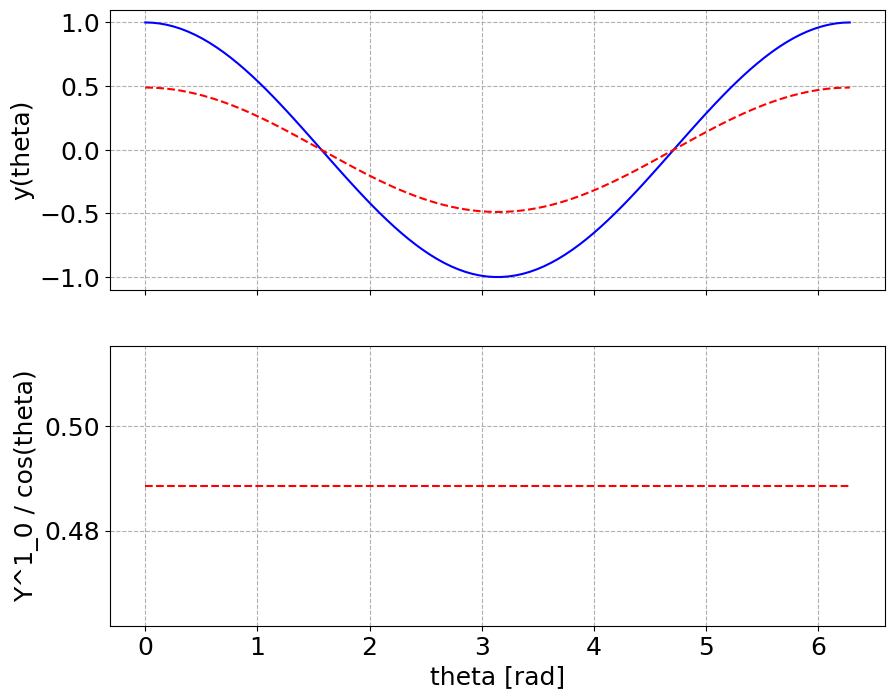

In [2369]:
fig, axs = plt.subplots(2, 1, sharex=True)

costh = np.cos(thetas)
sph = sph_harm_y(1, 0, thetas, phis).real

axs[0].plot(thetas, costh, 'b-', label='cos(theta)')
axs[0].plot(thetas, sph, 'r--', label='Y^1_0')

axs[1].plot(thetas, sph / costh, 'r--')

axs[1].set_xlabel('theta [rad]')
axs[0].set_ylabel('y(theta)')
axs[1].set_ylabel('Y^1_0 / cos(theta)')

In [2370]:
1./2. * (3. / np.pi)**(1/2)

0.4886025119029199

In [2371]:
import scipy

In [2372]:
scipy.__version__

'1.15.2'

In [2373]:
probe

'8E0000000D51483A'

Text(0.5, 0, 'theta_B_true_deg')

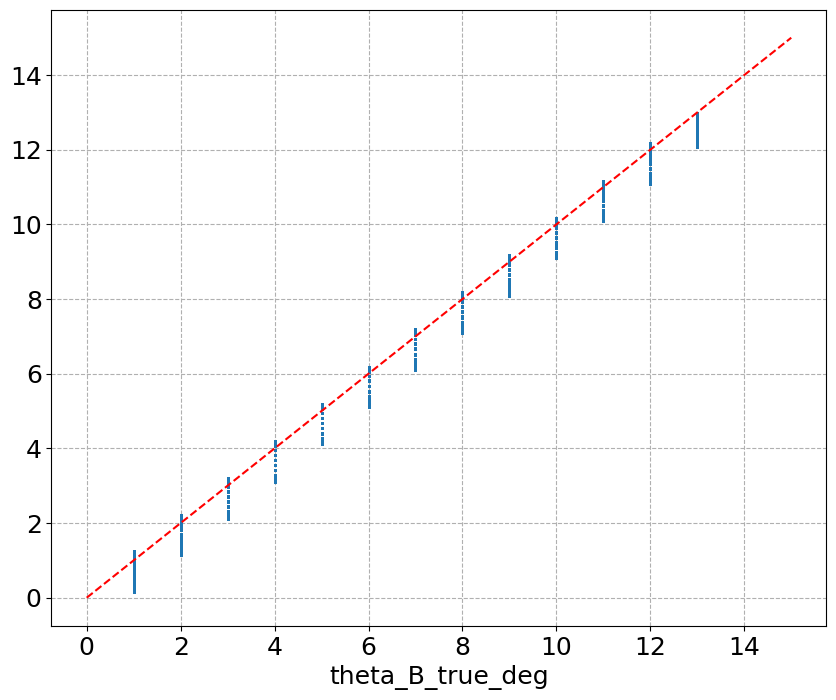

In [2374]:
# interrogate theta, phi
fig, ax = plt.subplots()

ax.scatter(df_['SmarAct_Meas_Angle_1_Centered'], df_['theta_B_true_deg'], s=1)

ax.plot([0, 15], [0, 15], 'r--')

ax.set_xlabel('SmarAct_Meas_Angle_1_Centered')
ax.set_xlabel('theta_B_true_deg')

Text(0.5, 0, 'phi_B_true_deg')

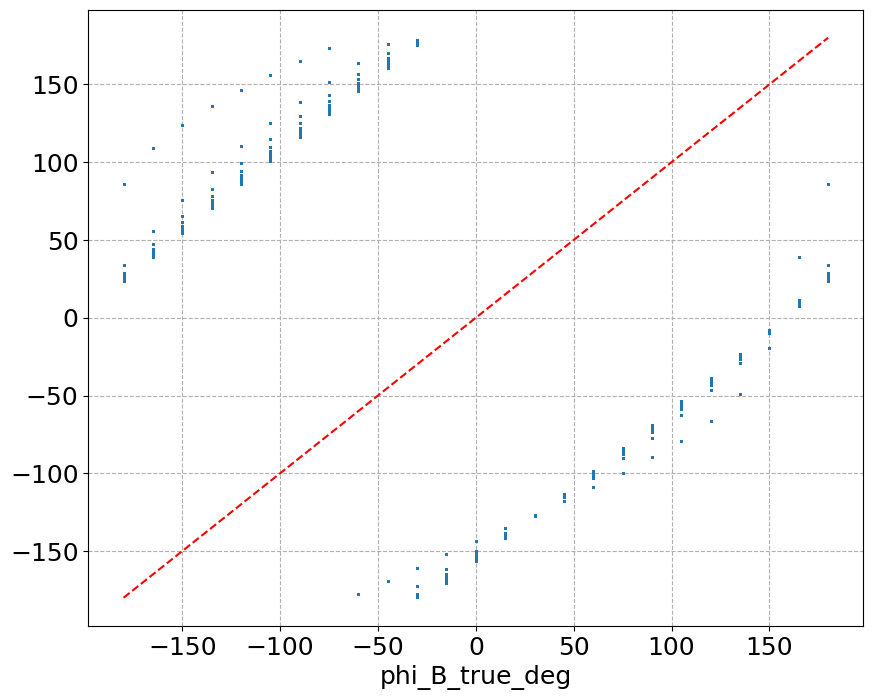

In [2375]:
# interrogate theta, phi
fig, ax = plt.subplots()

ax.scatter(-df_['SmarAct_Meas_Angle_2_Centered'], df_['phi_B_true_deg'], s=1)

ax.plot([-180, 180], [-180, 180], 'r--')

ax.set_xlabel('SmarAct_Meas_Angle_2_Centered')
ax.set_xlabel('phi_B_true_deg')

Text(0.5, 0, 'phi_B_true_deg')

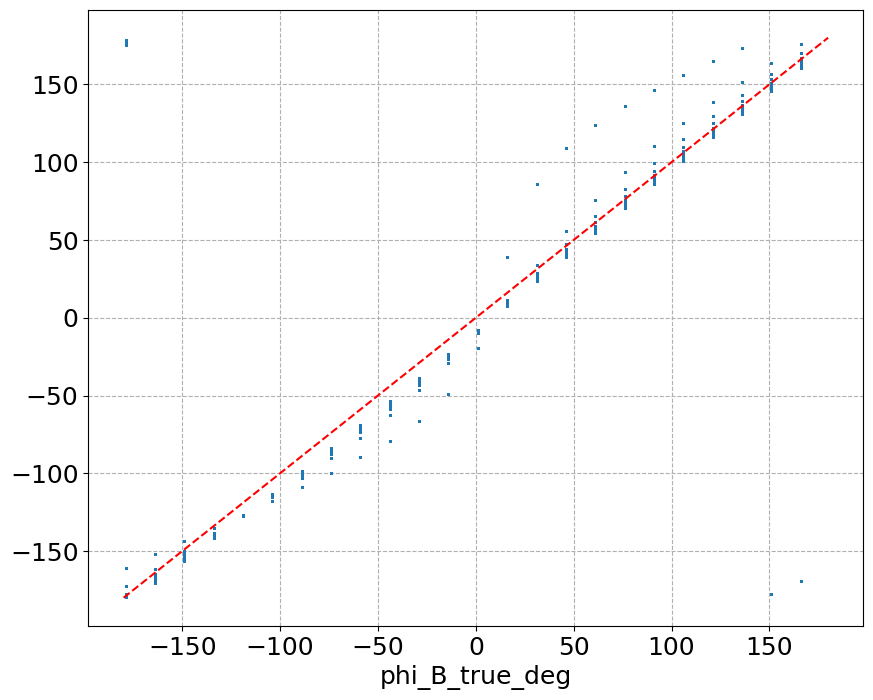

In [2376]:
# try to align
#phase_deg = -150.
phase_deg = 211.
fig, ax = plt.subplots()

SA2 = deepcopy(-df_['SmarAct_Meas_Angle_2_Centered'].values)
SA2 += phase_deg
SA2[SA2>180.] = SA2[SA2>180.] - 360.

ax.scatter(SA2, df_['phi_B_true_deg'], s=1)

ax.plot([-180, 180], [-180, 180], 'r--')

ax.set_xlabel(f'SmarAct_Meas_Angle_2_Centered + {phase_deg:0.1f} [deg]')
ax.set_xlabel('phi_B_true_deg')

In [2377]:
### without sign flip

Text(0.5, 0, 'phi_B_true_deg')

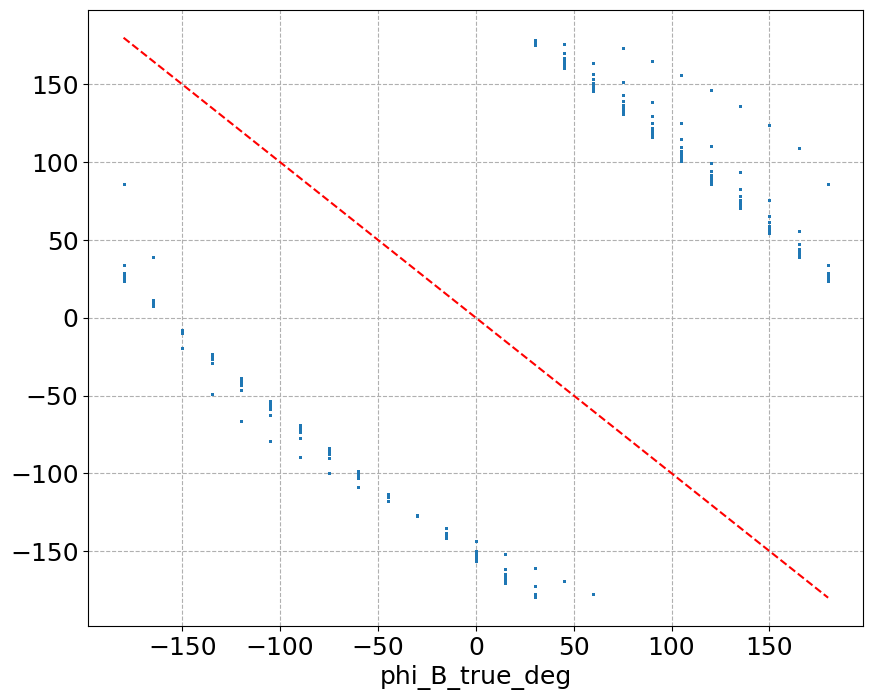

In [2378]:
# interrogate theta, phi
fig, ax = plt.subplots()

ax.scatter(df_['SmarAct_Meas_Angle_2_Centered'], df_['phi_B_true_deg'], s=1)

ax.plot([-180, 180], [180, -180], 'r--')

ax.set_xlabel('SmarAct_Meas_Angle_2_Centered')
ax.set_xlabel('phi_B_true_deg')

Text(0.5, 0, 'phi_B_true_deg')

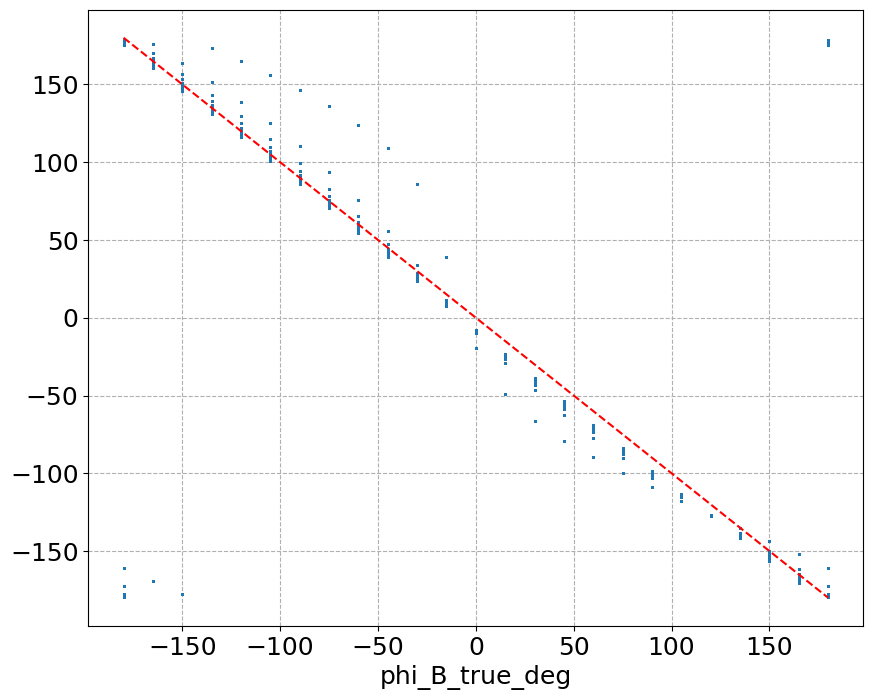

In [2379]:
# try to align
phase_deg = 150.
fig, ax = plt.subplots()

SA2 = deepcopy(df_['SmarAct_Meas_Angle_2_Centered'].values)
SA2 += phase_deg
SA2[SA2>180.] = SA2[SA2>180.] - 360.

ax.scatter(SA2, df_['phi_B_true_deg'], s=1)

ax.plot([-180, 180], [180, -180], 'r--')

ax.set_xlabel(f'SmarAct_Meas_Angle_2_Centered + {phase_deg:0.1f} [deg]')
ax.set_xlabel('phi_B_true_deg')

In [2380]:
np.radians(150.)

2.6179938779914944

In [2381]:
np.radians(360-150.)

3.6651914291880923

In [2382]:
df_.columns

Index(['Time', 'Magnet Current [A]', 'Magnet Voltage [V]', 'NMR [T]',
       'NMR [FFT]', '8E0000000D51483A_Raw_X', '8E0000000D51483A_Raw_Y',
       '8E0000000D51483A_Raw_Z', '8E0000000D51483A_Raw_T',
       '8E0000000D51483A_Cal_X', '8E0000000D51483A_Cal_Y',
       '8E0000000D51483A_Cal_Z', '8E0000000D51483A_Cal_T',
       'SmarAct_Pattern_Angle_1', 'SmarAct_Pattern_Angle_2',
       'SmarAct_Meas_Angle_1', 'SmarAct_Meas_Rotation_Angle_1',
       'SmarAct_Meas_Angle_2', 'SmarAct_Meas_Rotation_Angle_2',
       'seconds_delta', 'hours_delta', 'days_delta', 'run_type',
       'expected_field', 'polarity', 'chiller_temp_F',
       '8E0000000D51483A_Raw_Bmag', '8E0000000D51483A_Raw_Theta',
       '8E0000000D51483A_Raw_Phi', '8E0000000D51483A_Cal_Bmag',
       '8E0000000D51483A_Cal_Theta', '8E0000000D51483A_Cal_Phi',
       '8E0000000D51483A_Cal_Theta2', '8E0000000D51483A_Cal_Phi2',
       'Magnet Resistance [Ohm]', 'Coil Resistance [Ohm]', 'Magnet Power [W]',
       'SmarAct_Meas_Angle_1_Ce

In [2383]:
# first fit, basic, with 1 temp and 1 B
###df_1 = df_.query(f'(`Magnet Current [A]` < 0.) ' 
df_1 = df_.query(
               #f'(`Magnet Current [A]` > 0.) '
               f'(`Magnet Current [A]` > -10000.) '
               +f'& (0.97 <= B_corr <=0.99) '
               # +f'& (18.5 <= `{probe}_Cal_T` <= 21.5) '
               +f'& (23. <= `{probe}_Cal_T` <= 27.5) '
               # +f'& (`{probe}_Cal_T` <= 18.0) '
               # + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 10.)'
               ####+ f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` < 14.)'
               ##+ f'& (1.0 < `SmarAct_Meas_Angle_1_Centered`)'
               + f'& (1.0 < `SmarAct_Meas_Angle_1_Centered` <= 13.)'
               + f'& (theta_B_true <= 13.0)'
              ).copy()

comps = ['X', 'Y', 'Z']
result_dict = dict()

# define a regular dict of limited parameters first for getting the model function
params_dict = {}
# kmax = 3
# nmax = 2
# lmax = 3
# mmax = 2
### GOOD, quick
kmax = 1
nmax = 1
lmax = 1
# lmax = 2
##mmax = 1
mmax = 0
# mmax = 2
### BETTER X, Y, poor Z
# kmax = 1
# nmax = 1
# lmax = 3
# mmax = 2

# lmax = 3
# mmax = 2
for k in ['kmax', 'nmax', 'lmax', 'mmax']:
    exec(f'params_dict["{k}"] = {k}')

#simultaneous_fit_rot_temp_B_v2 = get_simultaneous_fit_rot_temp_B_v2(
simultaneous_fit_rot_temp_B_v2 = get_simultaneous_fit_rot_temp_B_abg_float(
    theta=df_1['theta_B_true'].values,phi=df_1['phi_B_true'].values,
    B_rescaled=df_1['B_corr_rescaled'].values,
    temp_rescaled=df_1[f'{probe}_Cal_T_rescaled'].values,
    **params_dict
)

for comp in comps:
# for comp in ['Y']:
# for comp in ['Z']:
    print(f'Fitting {comp}')
    # rescale data?
    ###data = deepcopy(df_1[f'{probe}_Raw_{comp}'].values)
    data = deepcopy(df_1[f'Raw_{comp}'].values)
    # data = data / np.max(np.abs(data))
    tempdata = df_1[f'{probe}_Cal_T_rescaled'].values
    Bdata = df_1['B_corr_rescaled'].values
    ###
    # uncertainty
    sigma_est = 100 # 100 / 3e-6 ~ 3e-5
    # sigma_est = 3e-5
    ###
    model = lm.Model(simultaneous_fit_rot_temp_B_v2, independent_vars=['theta', 'phi', 'temp_rescaled', 'B_rescaled'])
    params = lm.Parameters()

    #params.add('kmax', value=1, vary=False)
    #params.add('nmax', value=2, vary=False)

    #params.add('kmax', value=5, vary=False)
    #params.add('nmax', value=3, vary=False)

    # limited model for extracting these values
    params.add('kmax', value=kmax, vary=False)
    params.add('nmax', value=nmax, vary=False)

    params.add('lmax', value=lmax, vary=False)
    params.add('mmax', value=mmax, vary=False)

    var_rot = True # takes a long time...not sure if fit will converge.
    # var_rot = False

    #params.add('alpha', value=result_dict[comp].params['alpha'].value, vary=var_rot, min=-np.pi, max=np.pi)
    #params.add('beta', value=result_dict[comp].params['beta'].value, vary=var_rot, min=-np.pi, max=np.pi)
    #params.add('gamma', value=result_dict[comp].params['gamma'].value, vary=var_rot, min=-np.pi, max=np.pi)

    # def
    a0=0.
    da=np.pi
    b0=0.
    db=np.pi
    g0=0.
    dg=np.pi
    # custom
    if comp == 'Z':
        a0 = 0.0
        da = np.radians(10.)
        b0 = 0.0
        db = np.radians(10.)
        g0 = 0.0
        dg = np.pi + np.radians(15.)
        var_g = False
    elif comp == 'X':
        a0 = -np.pi/2
        # a0 = -np.pi/2
        #da = np.radians(15.)
        da = np.radians(25.)
        d0 = 0.
        #db = np.pi/2.
        db = np.pi
        g0 = 0. + np.radians(1.)
        var_g = True
        # g0 = 0.
        # var_g = False
        # pass
    elif comp == 'Y':
        a0 = -np.pi/2
        #da = np.radians(15.)
        #g0 = -np.pi/2
        g0 = 0.
        da = np.radians(25.)
        d0 = 0.
        db = np.pi/2.
        var_g = False
        # pass

    #params.add('alpha', value=a0, vary=var_rot, min=a0-da, max=a0+da)
    params.add('alpha', value=a0+np.radians(1.0), vary=var_rot, min=a0-da, max=a0+da)
    params.add('beta', value=b0+np.radians(1.0), vary=var_rot, min=b0-db, max=b0+db)
    params.add('gamma', value=g0, vary=var_g, min=g0-dg, max=g0+dg)
    #params.add('alpha', value=np.pi/4., vary=var_rot, min=0., max=np.pi/2. + np.radians(15.))
    #params.add('beta', value=0., vary=var_rot, min=-np.pi, max=np.pi)
    # params.add('beta', value=0., vary=var_rot, min=-2*np.pi, max=2*np.pi)
    # params.add('gamma', value=0., vary=var_rot, min=-np.pi, max=np.pi)
    ###params.add('gamma', value=0., vary=var_g, min=-np.pi, max=np.pi)

    ## grabbed from other notebook -- not sure how I landed here
    #params.add('alpha', value=-1.55, vary=True, min=-np.pi, max=np.pi)
    #params.add('beta', value=2.25, vary=True, min=-np.pi, max=np.pi)
    #params.add('gamma', value=-3.08, vary=True, min=-np.pi, max=np.pi)

    # if comp=='X':
    #     a0=-1.55
    #     b0=2.25
    #     g0=-3.08
    
    #params.add('alpha', value=-1.55, vary=True, min=-2.*np.pi, max=2.*np.pi)
    #params.add('beta', value=2.25, vary=True, min=-2.*np.pi, max=2.*np.pi)
    #params.add('gamma', value=-3.08, vary=True, min=-2.*np.pi, max=2.*np.pi)

    # spherical
    # min_ = 0. # use 0 min?
    min_ = None # or allow negative?
    # max_ = 1.0
    max_ = None

    for k in range(params['kmax'] + 1):
        for n in range(params['nmax'] + 1):
            for l in range(params['lmax']+1):
                for m in range(0, min(l, params['mmax']) + 1):
                    params.add(f'C_{k}_{n}_{l}_{m}', value=0.5, vary=True, min=min_, max=max_)
    
    # for k in range(params['kmax'] + 1):
    #     for n in range(params['nmax'] + 1):
    #         params.add(f'C{k}{n}00', value=0.5, vary=True, min=min_, max=max_)
    #         params.add(f'C{k}{n}10', value=0.5, vary=True, min=min_, max=max_)
    # #         params.add(f'C{k}{n}10', value=Vm, vary=True, min=min_, max=max_)
    #         params.add(f'C{k}{n}20', value=0.5, vary=True, min=min_, max=max_)
    #         params.add(f'C{k}{n}22', value=0.5, vary=True, min=min_, max=max_) # PHE
    #         params.add(f'C{k}{n}30', value=0.5, vary=True, min=min_, max=max_)
    #         params.add(f'C{k}{n}32', value=0.5, vary=True, min=min_, max=max_) # 3D Hall effect
    #     #     params.add(f'C{n}32', value=0.0, vary=False, min=min_, max=max_) # 3D Hall effect

    result_simul_rot_temp_B = model.fit(data, theta=df_1['theta_B_true'].values, phi=df_1['phi_B_true'].values, 
                                        temp_rescaled=tempdata, B_rescaled=Bdata, params=params,
                                        #weights=1/(sigma_est*np.ones_like(df_1[f'{probe}_Raw_{comp}'].values)), scale_covar=False)
                                        weights=1/(sigma_est*np.ones_like(df_1[f'Raw_{comp}'].values)), scale_covar=False)
    # subtract off cos(theta)
    df_1.loc[:, f'simul_rot_temp_B_fit'] = result_simul_rot_temp_B.best_fit
    df_1.loc[:, f'{probe}_Raw_{comp}_min_simul_rot_temp_B'] = data - result_simul_rot_temp_B.best_fit
    result_dict[comp] = result_simul_rot_temp_B

Fitting X
Fitting Y
Fitting Z


In [2384]:
np.pi/2

1.5707963267948966

In [2385]:
result_dict['X']

In [2386]:
result_dict['Y']

In [2387]:
result_dict['Z']

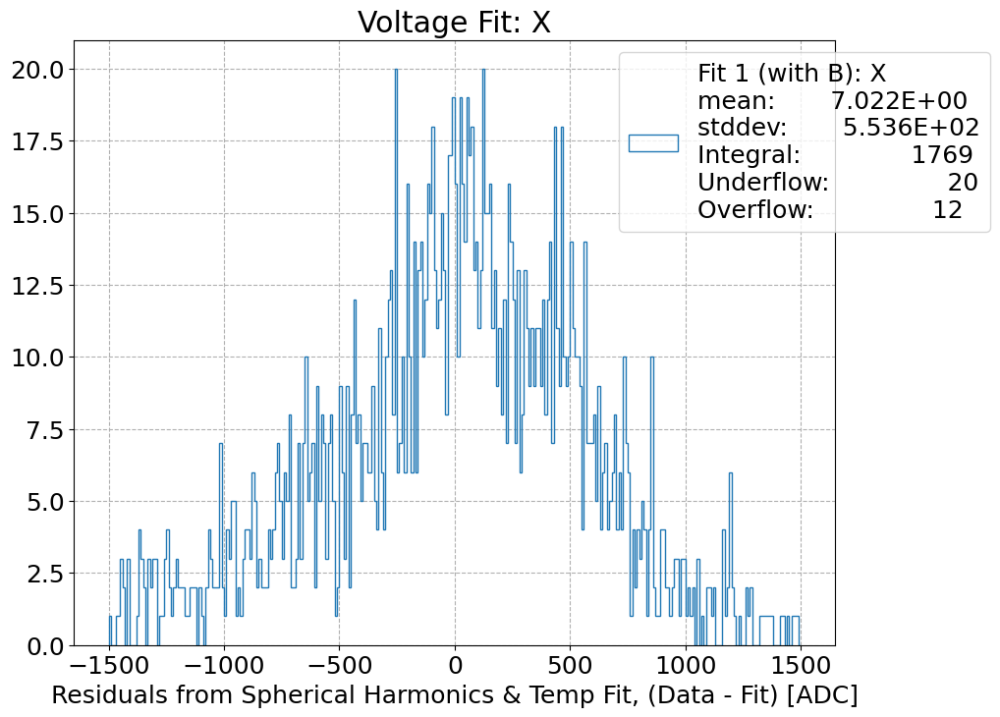

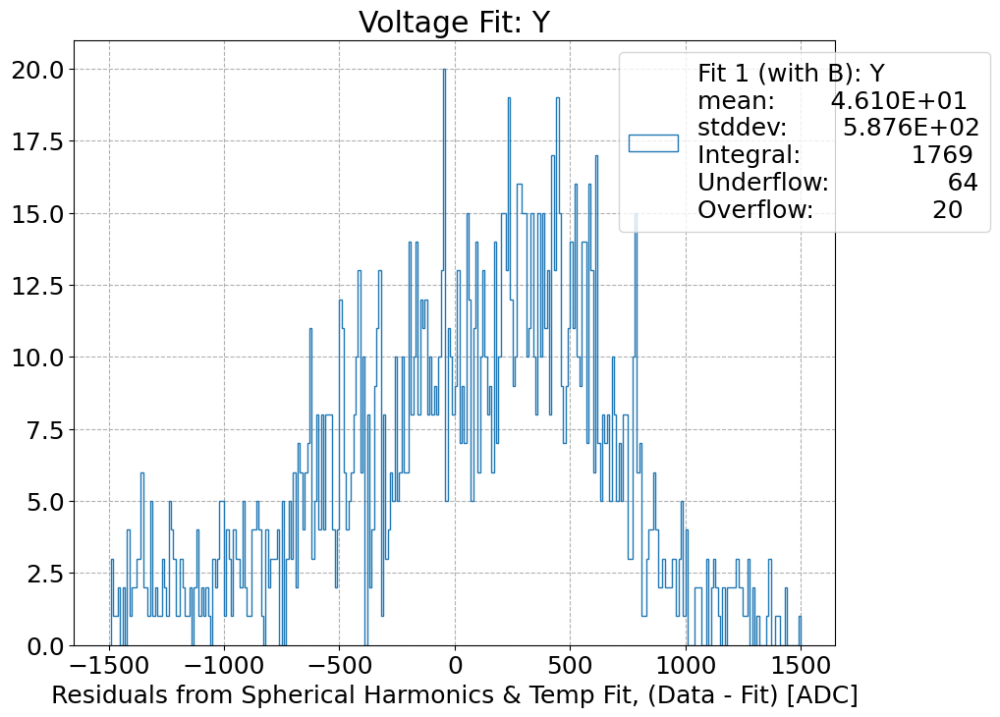

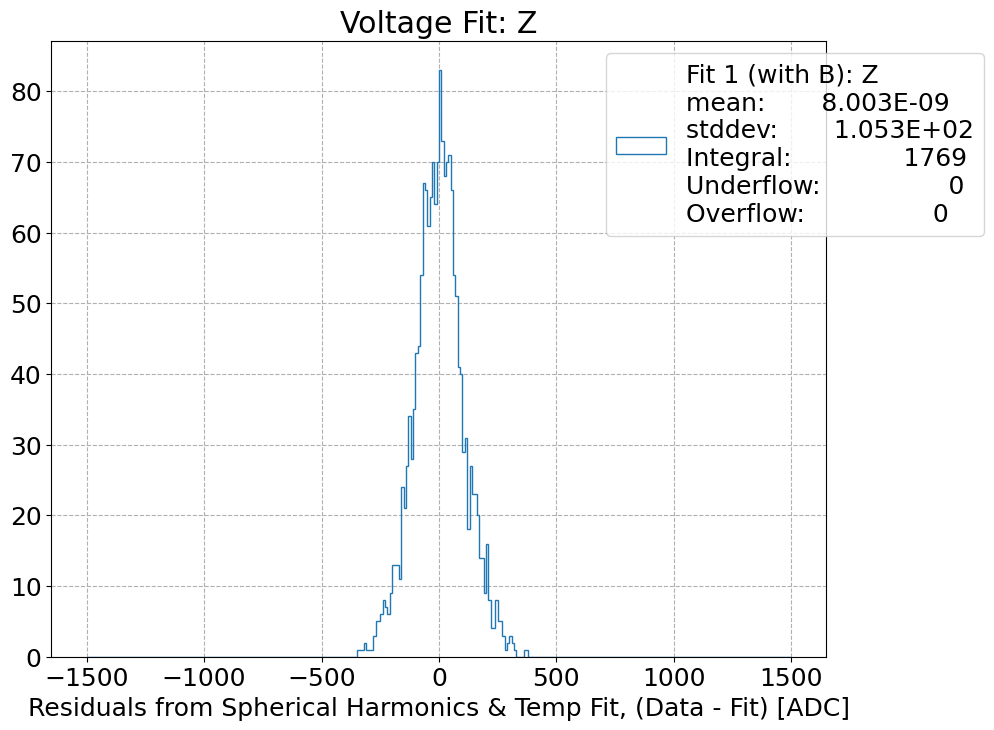

In [2388]:
for comp in comps:
    fig, ax = plt.subplots()

    # bins=np.arange(-500, 510, 10)
    ###bins=np.arange(-750, 760, 10)
    #bins=np.arange(-15000, 15000, 100)
    bins=np.arange(-1500, 1510, 10)
    # bins=np.arange(-1000, 1050, 50)

    #ax.hist(df_[f'{probe}_Raw_{comp}_min_simul_rot_temp'], bins=bins, histtype='step', label=f'Fit 1 (no B): {comp}\n'+get_label(df_[f'{probe}_Raw_{comp}_min_simul_rot_temp'], bins))
    ax.hist(df_1[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], bins=bins, histtype='step',
            label=f'Fit 1 (with B): {comp}\n'+get_label(df_1[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], bins))

    ax.set_xlabel('Residuals from Spherical Harmonics & Temp Fit, (Data - Fit) [ADC]');
    ax.set_title(f"Voltage Fit: {comp}")
    ax.legend(loc='upper left', bbox_to_anchor=(0.7, 1.0));

In [2389]:
2.33e2 / 100 * 3e-5

6.99e-05

In [2390]:
300 / 100 * 3e-5

9e-05

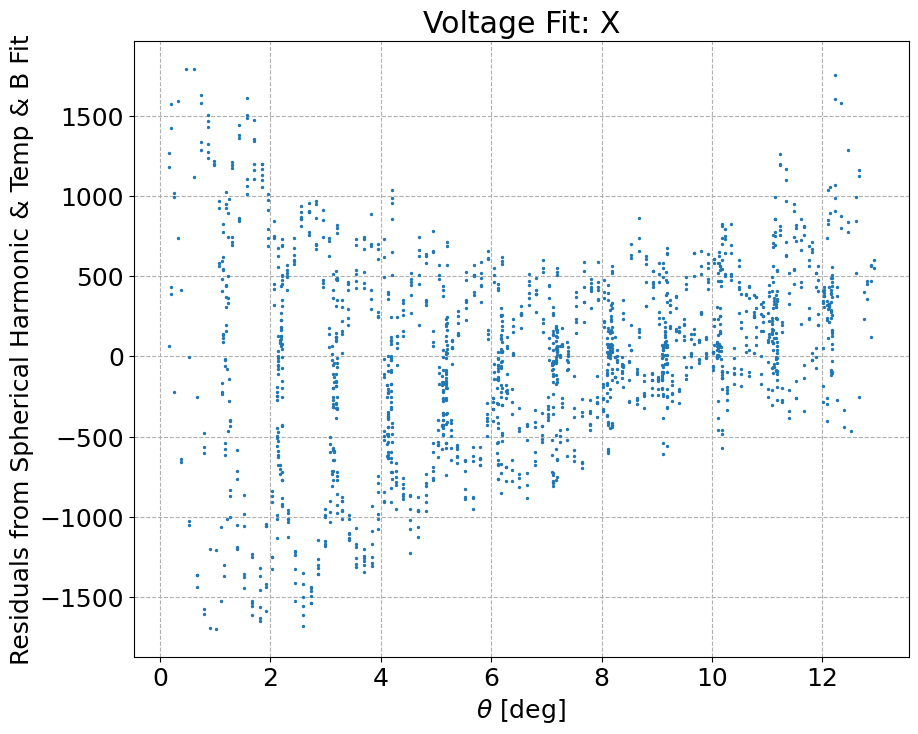

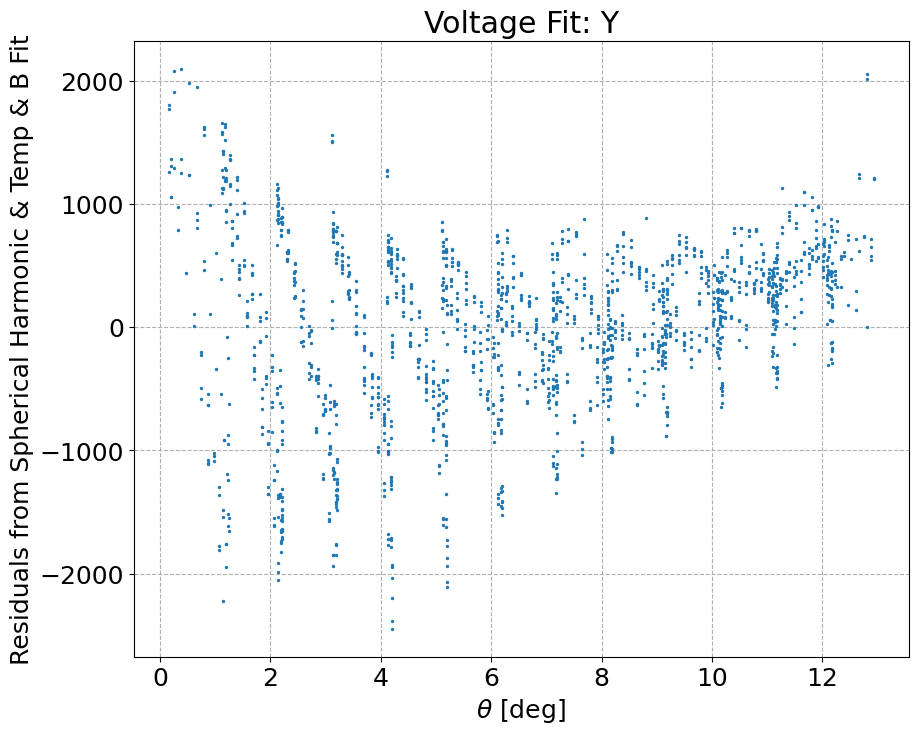

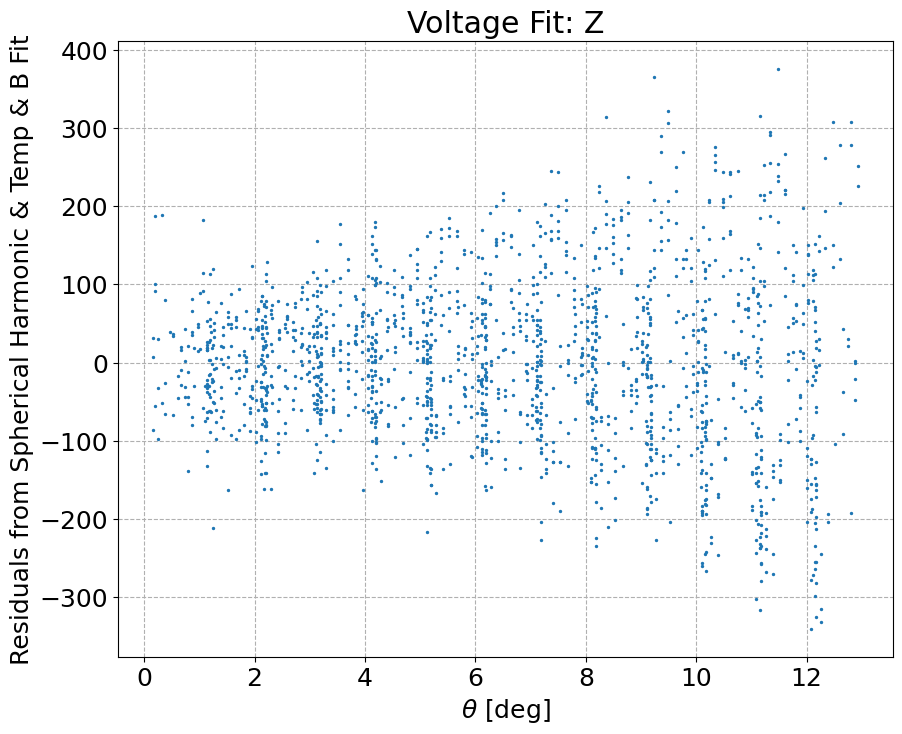

In [2391]:
for comp in comps:
    fig, ax = plt.subplots()

    ax.scatter(df_1.theta_B_true_deg, df_1[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], s=2)

    ax.set_xlabel(r'$\theta$ [deg]')
    ax.set_ylabel('Residuals from Spherical Harmonic & Temp & B Fit')
    ax.set_title(f"Voltage Fit: {comp}");

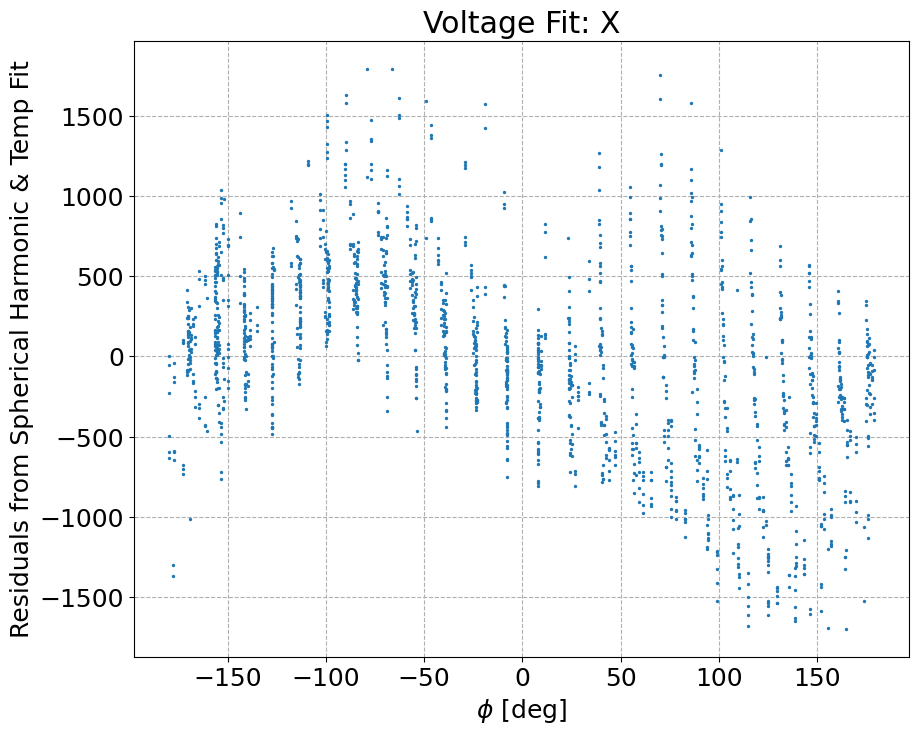

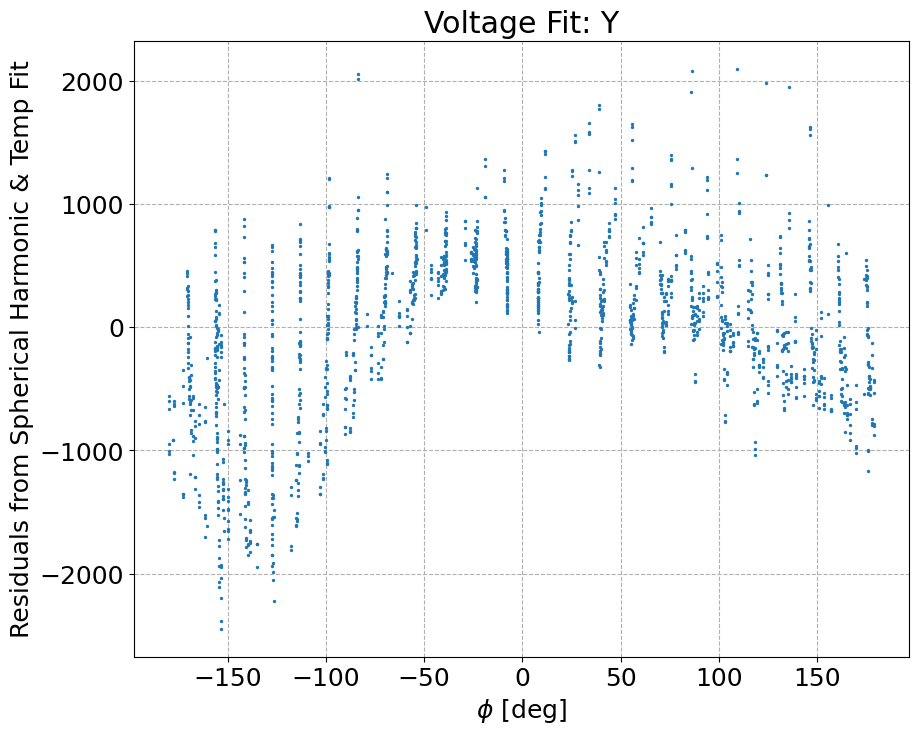

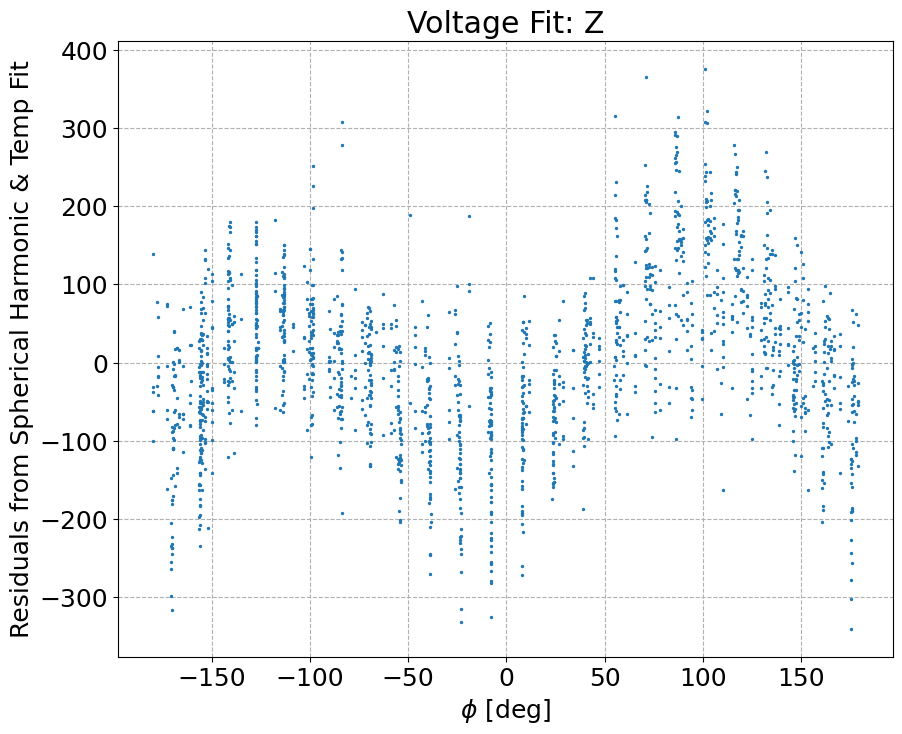

In [2392]:
for comp in comps:
    fig, ax = plt.subplots()

    ax.scatter(df_1.phi_B_true_deg, df_1[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], s=2)

    ax.set_xlabel(r'$\phi$ [deg]')
    ax.set_ylabel('Residuals from Spherical Harmonic & Temp Fit');
    ax.set_title(f"Voltage Fit: {comp}");

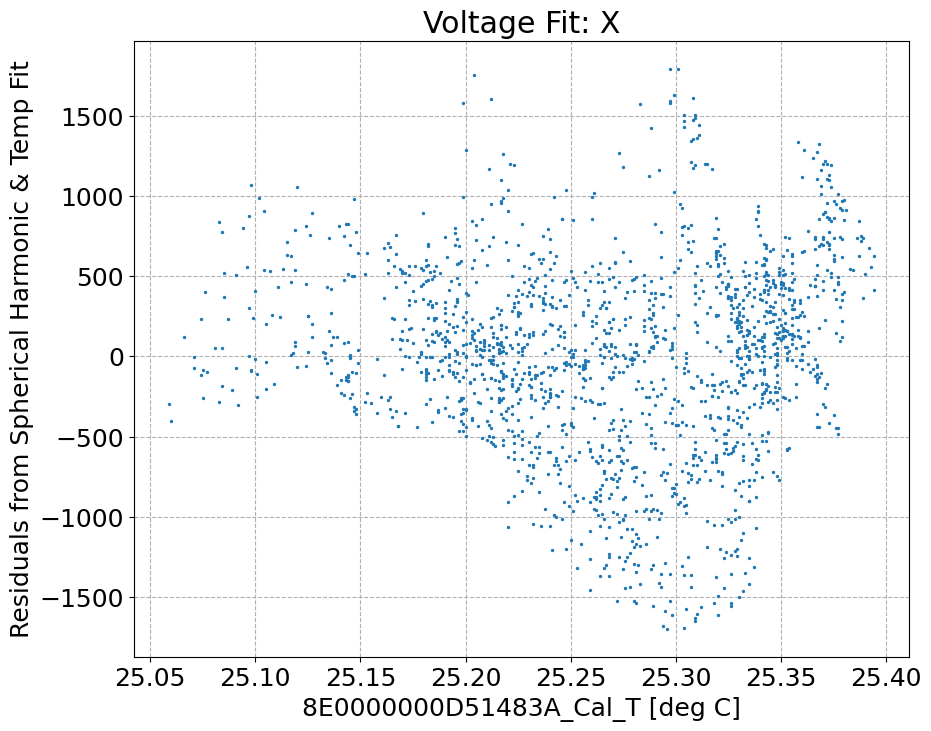

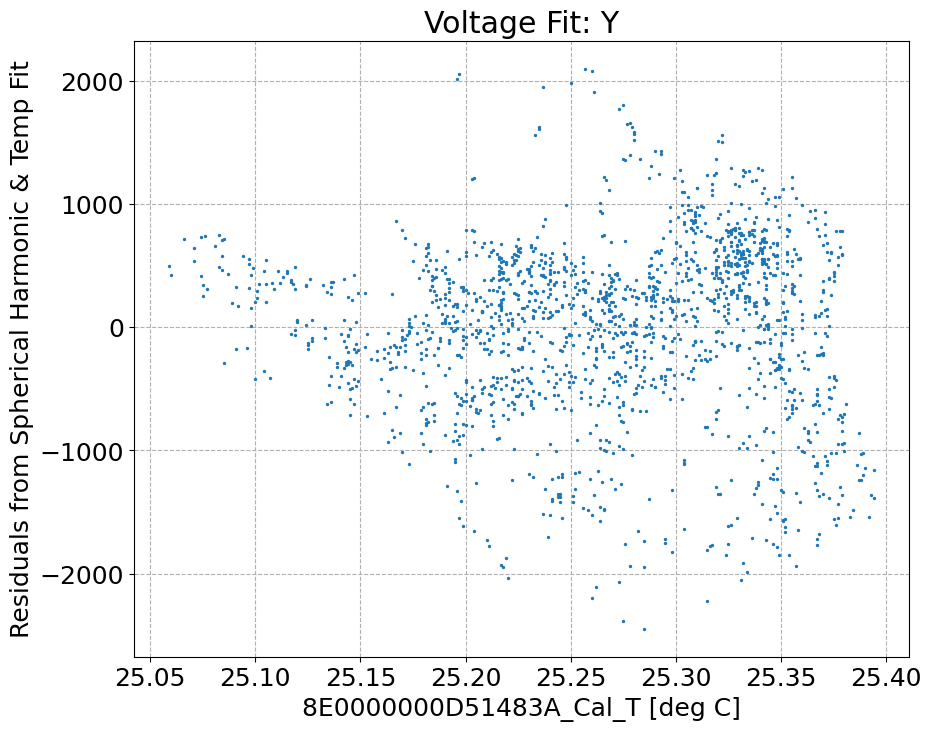

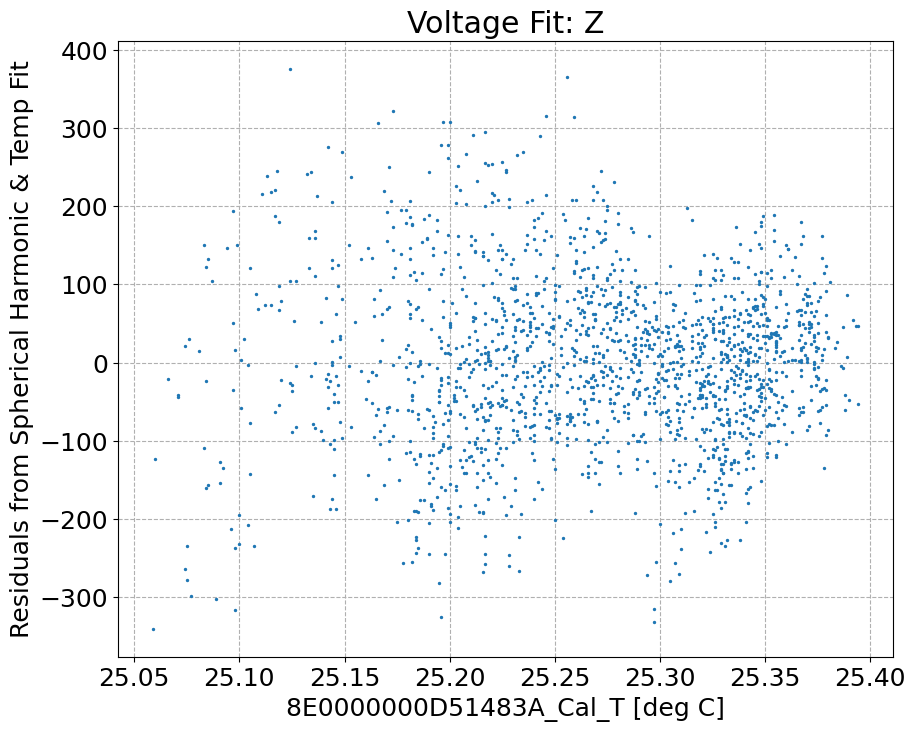

In [2393]:
for comp in comps:
    fig, ax = plt.subplots()

    ax.scatter(df_1[f'{probe}_Cal_T'], df_1[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], s=2)

    ax.set_xlabel(f'{probe}_Cal_T [deg C]')
    ax.set_ylabel('Residuals from Spherical Harmonic & Temp Fit');
    ax.set_title(f"Voltage Fit: {comp}");

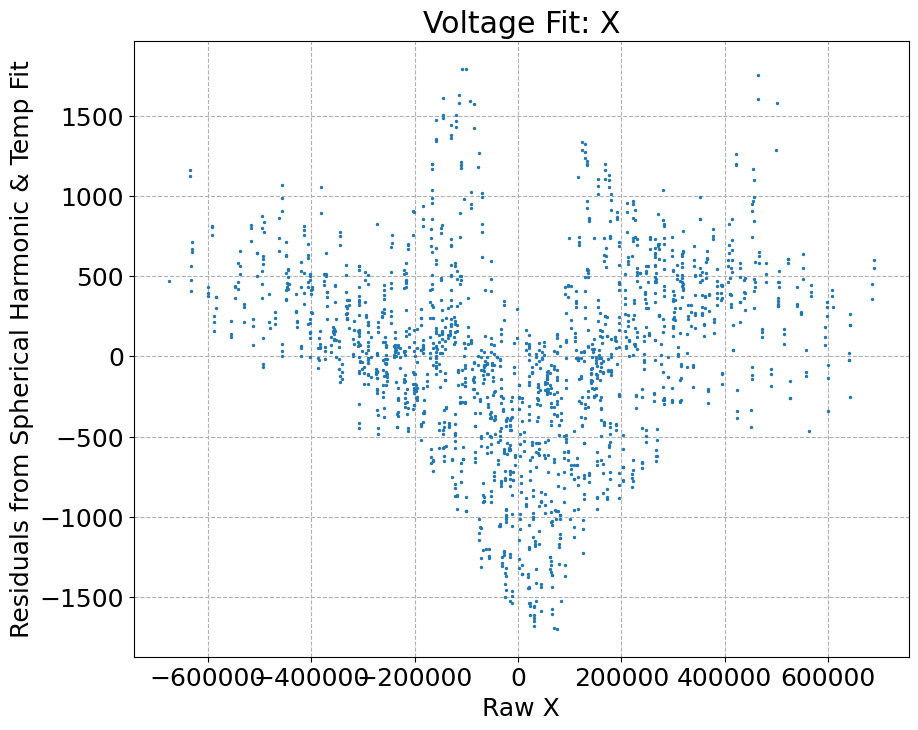

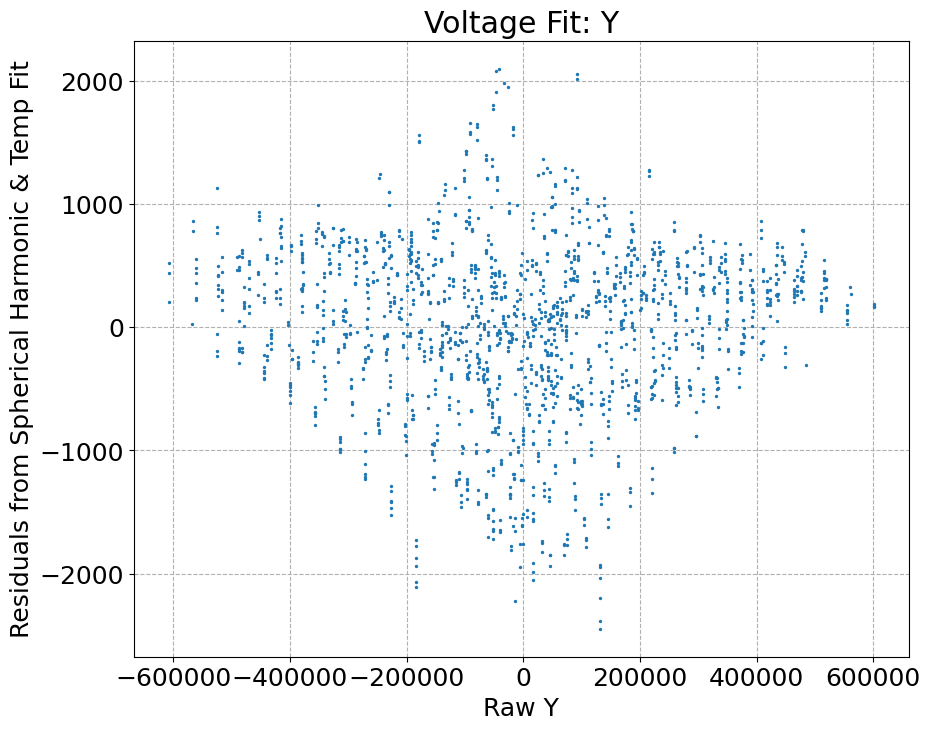

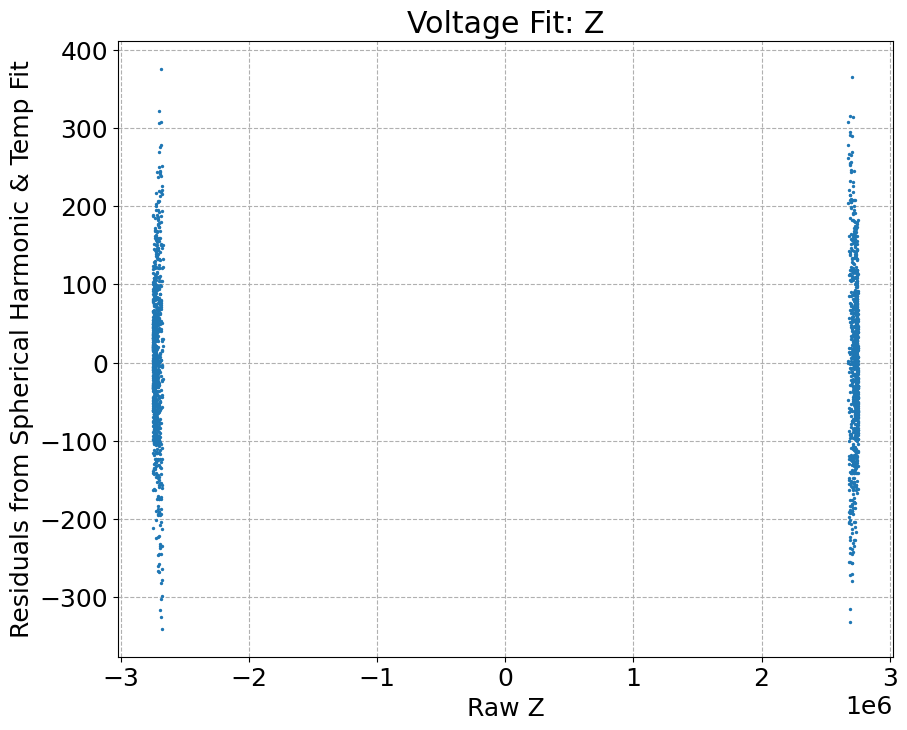

In [2394]:
for comp in comps:
    fig, ax = plt.subplots()

    ax.scatter(df_1[f'{probe}_Raw_{comp}'], df_1[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], s=2)

    ax.set_xlabel(f'Raw {comp}')
    ax.set_ylabel('Residuals from Spherical Harmonic & Temp Fit');
    ax.set_title(f"Voltage Fit: {comp}");

### TMP

In [2395]:
comps = ['X', 'Y', 'Z']
result_dict_B = dict()

# define a regular dict of limited parameters first for getting the model function
params_dict = {}
# plots in slack 06/04/25 6:18pm
# kmax = 3
# nmax = 2
# lmax = 4
# mmax = 4
### match my FMS 81 presentation (01-24-23)
# kmax = 1
# nmax = 2
# lmax = 3
# mmax = 2
### fit 1 temp, many |B|
kmax = 5
nmax = 1
#lmax = 3
#mmax = 2
lmax = 5
mmax = 5
###
# kmax = 5
# nmax = 3
# lmax = 4
# mmax = 4
###
#kmax = 5
#nmax = 2
#lmax = 7
#mmax = 7
# lmax = 3
# mmax = 2

for comp in comps:
    print(f'Fitting {comp}')
    # construct model func
    for k in ['kmax', 'nmax', 'lmax', 'mmax']:
        exec(f'params_dict["{k}"] = {k}')
    for k in ['alpha', 'beta', 'gamma']:
        params_dict[k] = result_dict[comp].params[k].value
    
    simultaneous_fit_rot_temp_B_modfunc = get_simultaneous_fit_rot_temp_B_abg_fixed(
        theta=df_['theta_B_true'].values,phi=df_['phi_B_true'].values,
        B_rescaled=df_['B_corr_rescaled'].values,
        temp_rescaled=df_[f'{probe}_Cal_T_rescaled'].values,
        **params_dict
    )
    # rescale data?
    ###data = deepcopy(df_[f'{probe}_Raw_{comp}'].values)
    data = deepcopy(df_[f'Raw_{comp}'].values)
    # data = data / np.max(np.abs(data))
    tempdata = df_[f'{probe}_Cal_T_rescaled'].values
    Bdata = df_['B_corr_rescaled'].values
    ###
    # uncertainty
    sigma_est = 100 # 100 / 3e-6 ~ 3e-5
    # sigma_est = 3e-5
    ###
    model = lm.Model(simultaneous_fit_rot_temp_B_modfunc, independent_vars=['theta', 'phi', 'temp_rescaled', 'B_rescaled'])
    params = lm.Parameters()

    #params.add('kmax', value=1, vary=False)
    #params.add('nmax', value=2, vary=False)

    #params.add('kmax', value=5, vary=False)
    #params.add('nmax', value=3, vary=False)

    params.add('kmax', value=kmax, vary=False)
    params.add('nmax', value=nmax, vary=False)

    params.add('lmax', value=lmax, vary=False)
    params.add('mmax', value=mmax, vary=False)

    # var_rot = True # takes a long time...not sure if fit will converge.
    var_rot = False

    params.add('alpha', value=result_dict[comp].params['alpha'].value, vary=var_rot, min=-np.pi, max=np.pi)
    params.add('beta', value=result_dict[comp].params['beta'].value, vary=var_rot, min=-np.pi, max=np.pi)
    params.add('gamma', value=result_dict[comp].params['gamma'].value, vary=var_rot, min=-np.pi, max=np.pi)

    # params.add('alpha', value=0., vary=var_rot, min=-np.pi, max=np.pi)
    # params.add('beta', value=0., vary=var_rot, min=-np.pi, max=np.pi)
    # params.add('gamma', value=0., vary=var_rot, min=-np.pi, max=np.pi)

    # spherical
    # min_ = 0. # use 0 min?
    min_ = None # or allow negative?
    # max_ = 1.0
    max_ = None

    for k in range(params['kmax'] + 1):
        for n in range(params['nmax'] + 1):
            for l in range(params['lmax']+1):
                for m in range(0, min(l, params['mmax']) + 1):
                    params.add(f'C_{k}_{n}_{l}_{m}', value=0.5, vary=True, min=min_, max=max_)

    # for k in range(params['kmax'] + 1):
    #     for n in range(params['nmax'] + 1):
    #         params.add(f'C{k}{n}00', value=0.5, vary=True, min=min_, max=max_)
    #         params.add(f'C{k}{n}10', value=0.5, vary=True, min=min_, max=max_)
    # #         params.add(f'C{k}{n}10', value=Vm, vary=True, min=min_, max=max_)
    #         params.add(f'C{k}{n}20', value=0.5, vary=True, min=min_, max=max_)
    #         params.add(f'C{k}{n}22', value=0.5, vary=True, min=min_, max=max_) # PHE
    #         params.add(f'C{k}{n}30', value=0.5, vary=True, min=min_, max=max_)
    #         params.add(f'C{k}{n}32', value=0.5, vary=True, min=min_, max=max_) # 3D Hall effect
    #     #     params.add(f'C{n}32', value=0.0, vary=False, min=min_, max=max_) # 3D Hall effect

    result_simul_rot_temp_B = model.fit(data, theta=df_['theta_B_true'].values, phi=df_['phi_B_true'].values, 
                                        temp_rescaled=tempdata, B_rescaled=Bdata, params=params,
                                        weights=1/(sigma_est*np.ones_like(df_[f'{probe}_Raw_{comp}'].values)), scale_covar=False)
    # subtract off cos(theta)
    df_.loc[:, f'simul_rot_temp_B_fit'] = result_simul_rot_temp_B.best_fit
    df_.loc[:, f'{probe}_Raw_{comp}_min_simul_rot_temp_B'] = data - result_simul_rot_temp_B.best_fit
    result_dict_B[comp] = result_simul_rot_temp_B

Fitting X
Fitting Y
Fitting Z


In [2396]:
print('Done!')

Done!


In [2397]:
result_dict_B['X']

In [2398]:
result_dict_B['Y']

In [2399]:
result_dict_B['Z']

In [2400]:
z_dict = {k: result_dict_B['Z'].params[k].value for k in result_dict_B['Z'].params.keys() if k[0] == 'C'}

In [2401]:
z_dict

{'C_0_0_0_0': 6688637147.377963,
 'C_0_0_1_0': -8270343440.172085,
 'C_0_0_1_1': 208814669600.50027,
 'C_0_0_2_0': 5327444646.736368,
 'C_0_0_2_1': -234906759125.013,
 'C_0_0_2_2': -4693334901.059082,
 'C_0_0_3_0': -2089606702.4865055,
 'C_0_0_3_1': 132244498198.28366,
 'C_0_0_3_2': 4177273701.3906317,
 'C_0_0_3_3': 110501370.31400296,
 'C_0_0_4_0': 468164489.6026272,
 'C_0_0_4_1': -39199415184.32994,
 'C_0_0_4_2': -1661036889.6253645,
 'C_0_0_4_3': -67183427.04230548,
 'C_0_0_4_4': -2292310.951886651,
 'C_0_0_5_0': -45957295.498439275,
 'C_0_0_5_1': 4900523006.270627,
 'C_0_0_5_2': 258953740.90139675,
 'C_0_0_5_3': 13730727.78834988,
 'C_0_0_5_4': 703368.2028101186,
 'C_0_0_5_5': 103773.92717342281,
 'C_0_1_0_0': -475229706.27986574,
 'C_0_1_1_0': -3110103805.968282,
 'C_0_1_1_1': 831622453483.1902,
 'C_0_1_2_0': 6809809421.535104,
 'C_0_1_2_1': -935226494927.062,
 'C_0_1_2_2': -17835878110.32233,
 'C_0_1_3_0': -5554700862.388125,
 'C_0_1_3_1': 526239000642.3405,
 'C_0_1_3_2': 1586973

In [2402]:
sorted_values_z_dict = sorted(z_dict.items(), key=lambda x:abs(x[1]))

In [2403]:
sorted_values_z_dict

[('C_4_0_5_5', 2835.366463146804),
 ('C_4_1_5_5', -3778.473120651477),
 ('C_1_0_5_5', 33827.644874554564),
 ('C_5_0_5_5', 35461.57031435011),
 ('C_3_0_5_5', -49671.96142776455),
 ('C_5_1_5_5', -60435.6804227572),
 ('C_2_0_5_5', -95968.59478424212),
 ('C_0_0_5_5', 103773.92717342281),
 ('C_1_1_5_5', 108786.91175262551),
 ('C_3_1_5_5', -248024.29162918238),
 ('C_1_0_5_4', -266979.8716861204),
 ('C_0_1_5_5', 312757.0496371677),
 ('C_4_0_5_4', -363884.03404208337),
 ('C_1_1_5_4', 420971.5775447452),
 ('C_2_1_5_5', -448971.4063550156),
 ('C_5_1_5_4', 635904.6708415892),
 ('C_0_0_5_4', 703368.2028101186),
 ('C_4_0_5_3', 803111.2475265451),
 ('C_1_0_4_4', 877603.3508990868),
 ('C_5_0_5_4', 918352.0503024252),
 ('C_4_0_4_4', 1173179.7119398052),
 ('C_1_1_4_4', -1305338.0932821117),
 ('C_3_0_5_4', -1354845.6476789757),
 ('C_4_1_5_4', 1668869.0094719245),
 ('C_2_0_5_4', -1916836.666923594),
 ('C_5_1_4_4', -2066855.4192679028),
 ('C_0_0_4_4', -2292310.951886651),
 ('C_2_1_5_4', -2614557.705867691

In [2404]:
# re-add previous results
# for comp in comps:
#     data = deepcopy(df_[f'{probe}_Raw_{comp}'].values)
#     df_.loc[:, f'{probe}_Raw_{comp}_min_simul_rot_temp'] = data - result_dict[comp].best_fit

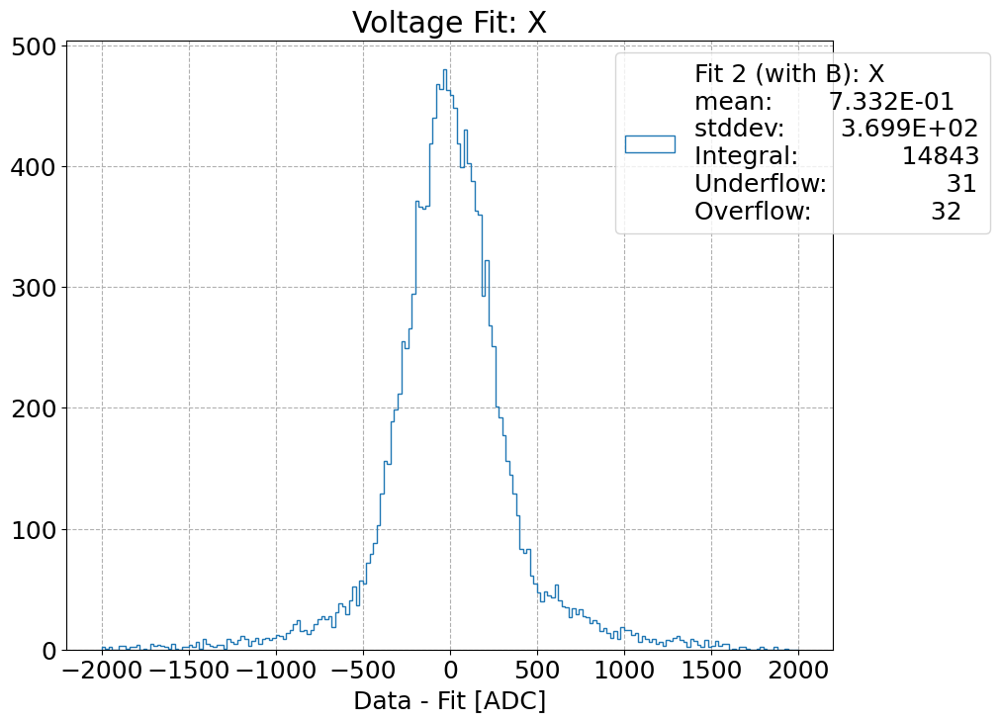

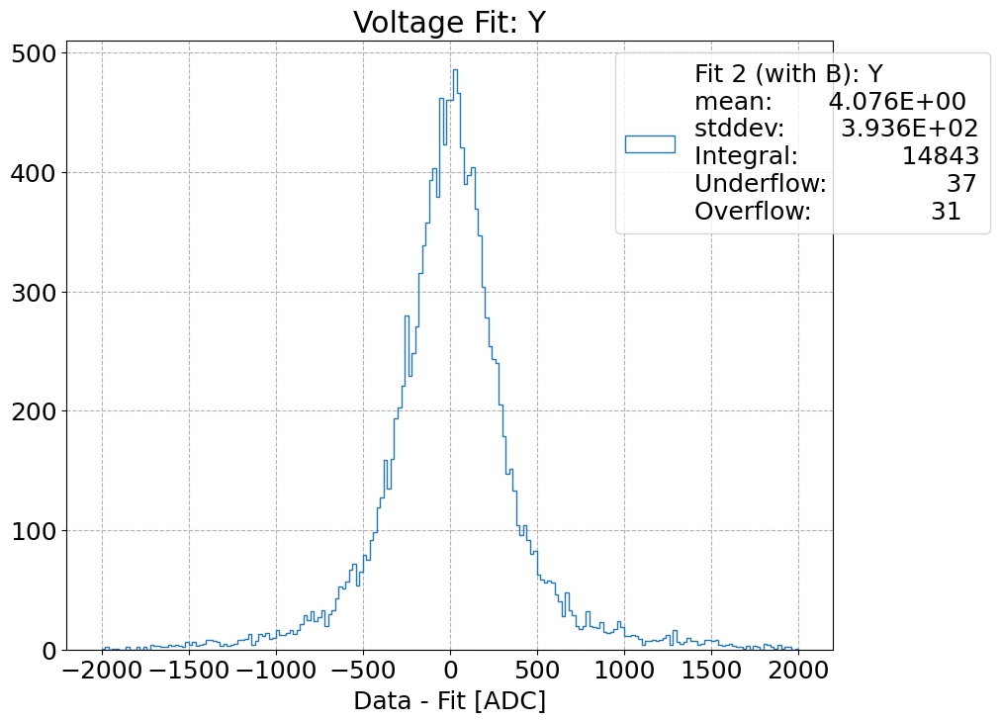

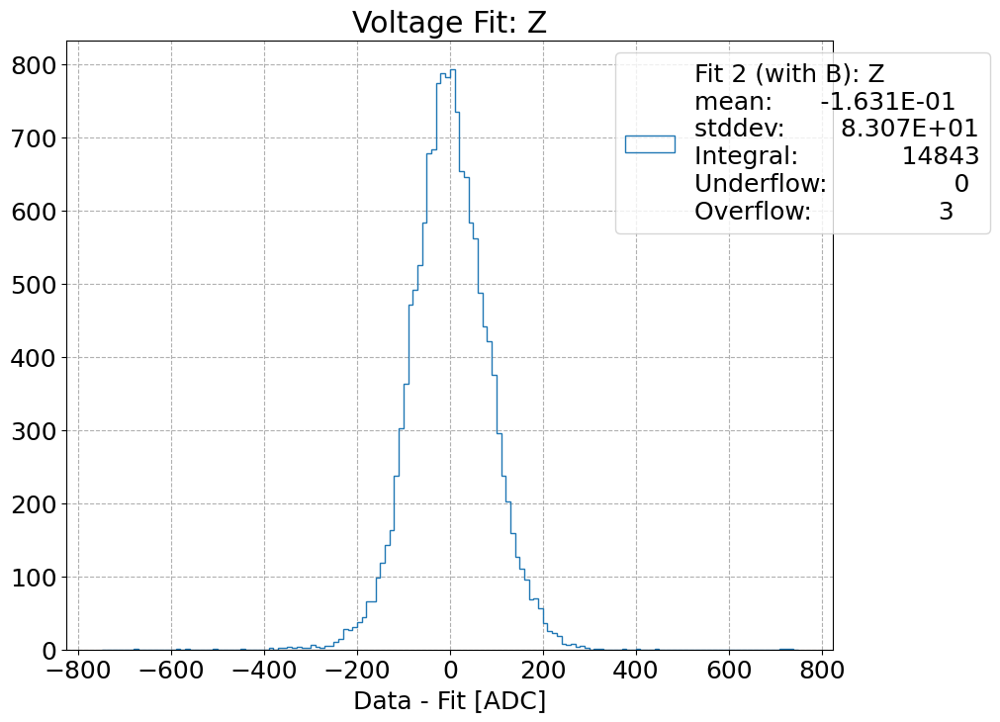

In [2405]:
for comp in comps:
    fig, ax = plt.subplots()

    if comp == 'X':
        #bins = np.arange(-4000, 4000, 20)
        bins=np.arange(-2000, 2020, 20)
    elif comp == 'Y':
        bins=np.arange(-2000, 2020, 20)
    else:
        bins=np.arange(-750, 760, 10)
    # bins=np.arange(-500, 510, 10)
    #bins=np.arange(-750, 760, 10)
    #bins=np.arange(-1200, 1210, 10)
    ###bins=np.arange(-1500, 1510, 10)
    # bins=np.arange(-2000, 2020, 20)
    ###bins=np.arange(-15000, 15000, 100)
    # bins=np.arange(-1000, 1050, 50)

    #ax.hist(df_[f'{probe}_Raw_{comp}_min_simul_rot_temp'], bins=bins, histtype='step', label=f'Fit 1 (no B): {comp}\n'+get_label(df_[f'{probe}_Raw_{comp}_min_simul_rot_temp'], bins))
    ax.hist(df_[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], bins=bins, histtype='step', label=f'Fit 2 (with B): {comp}\n'+get_label(df_[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], bins))

    #ax.set_xlabel('Residuals from Spherical Harmonics & Temp Fit, (Data - Fit) [ADC]');
    ax.set_xlabel('Data - Fit [ADC]')
    ax.set_title(f"Voltage Fit: {comp}")
    ax.legend(loc='upper left', bbox_to_anchor=(0.7, 1.0));

In [1425]:
350/100*3e-5

0.000105

In [1424]:
270/100*3e-5

8.1e-05

In [1369]:
429/100*3e-5

0.0001287

In [1370]:
90.9/100*3e-5

2.727e-05

In [1948]:
2500. / 100. * 3e-5

0.00075

In [ ]:
np.arctan

In [854]:
986/100*3e-5

0.0002958

In [660]:
1.350e2 / 100 * 3e-5

4.05e-05

In [449]:
2.33e2 / 100 * 3e-5

6.99e-05

In [454]:
3e3 / 100 * 3e-5

0.0009

In [586]:
1.484e3 / 100 * 3e-5

0.00044520000000000003

In [587]:
2.453e3 / 100 * 3e-5

0.0007359

In [588]:
1.689e2 / 100 * 3e-5

5.067e-05

In [614]:
%load_ext line_profiler

In [600]:
%timeit simultaneous_fit_rot_temp_B_modfunc(theta=df_1['theta_B_true'].values,phi=df_1['phi_B_true'].values,\
                                            B_rescaled=df_1['B_corr_rescaled'].values,\
                                            temp_rescaled=df_1[f'{probe}_Cal_T_rescaled'].values,\
                                            **result_dict_B['Z'].params)

437 μs ± 6.84 μs per loop (mean ± std. dev. of 7 runs, 1,000 loops each)


In [615]:
437. * 1e-4

0.0437

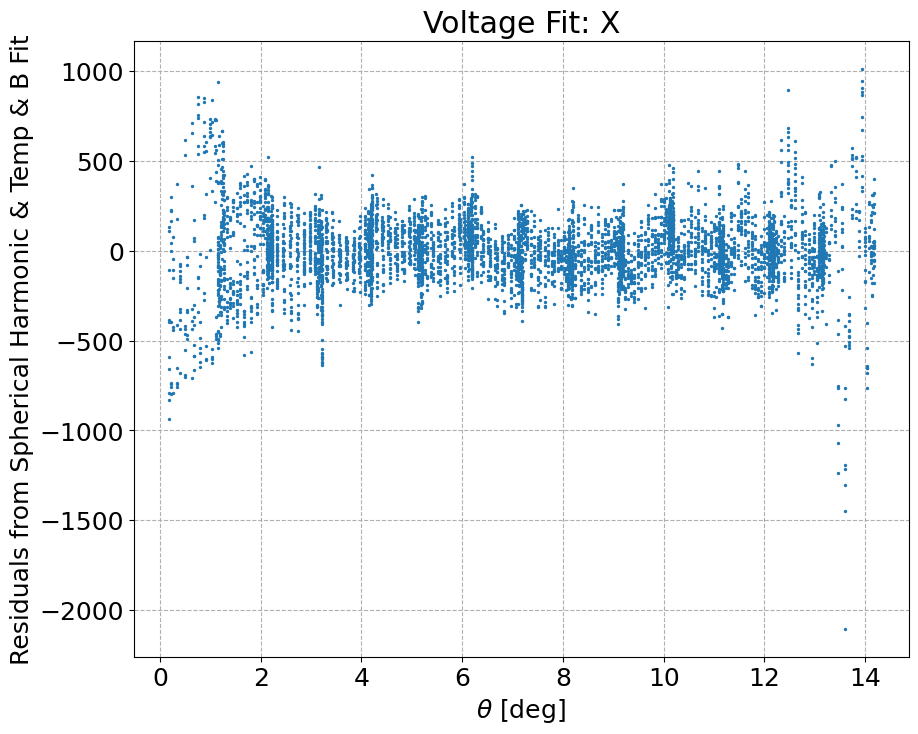

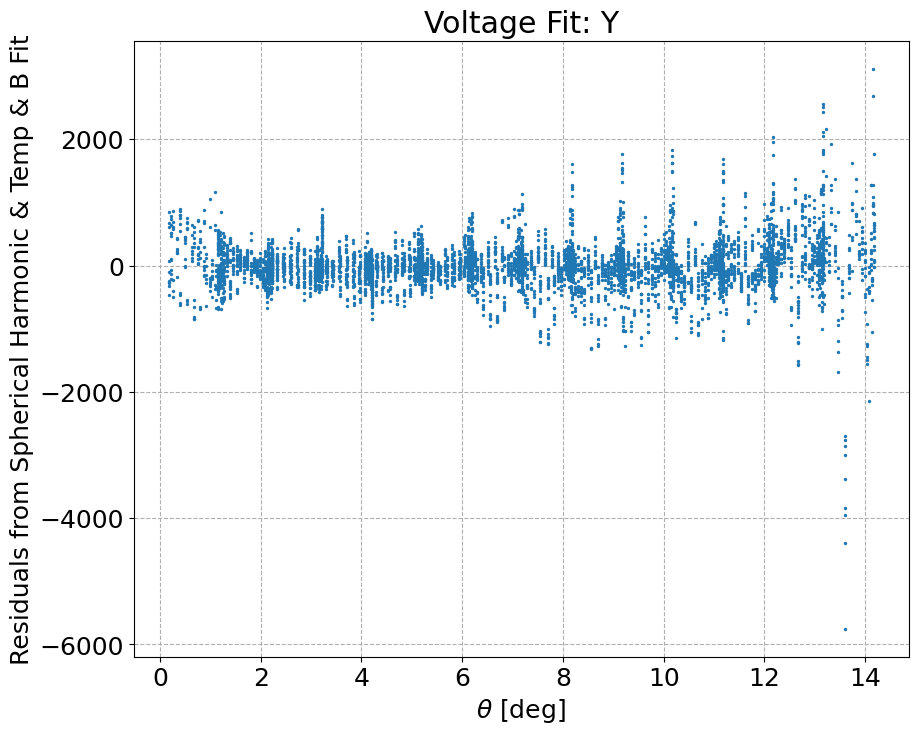

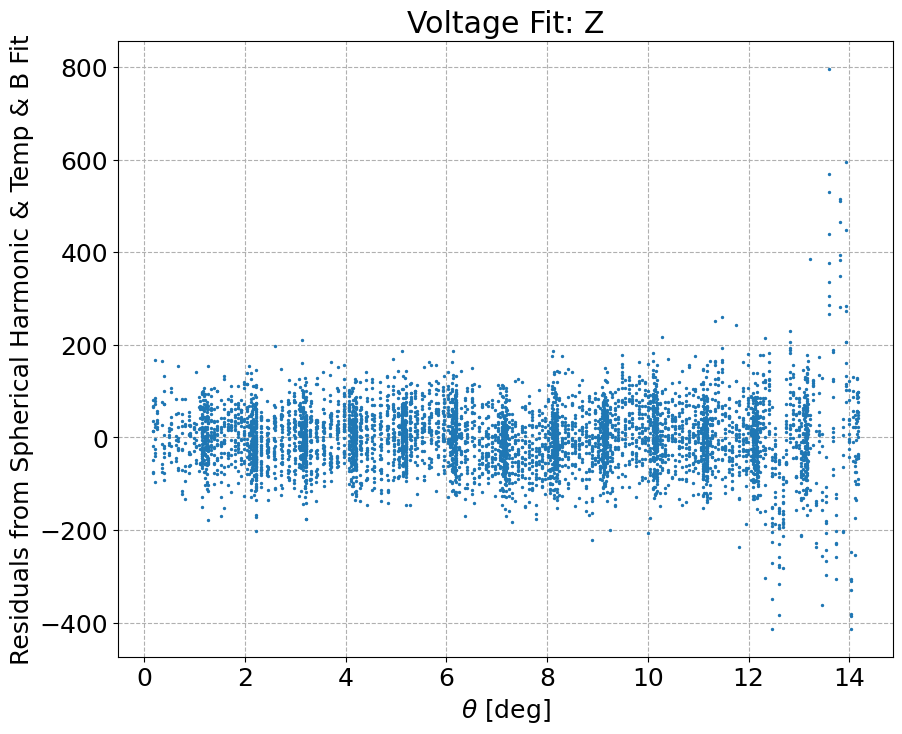

In [1697]:
for comp in comps:
    fig, ax = plt.subplots()

    ax.scatter(df_.theta_B_true_deg, df_[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], s=2)

    ax.set_xlabel(r'$\theta$ [deg]')
    ax.set_ylabel('Residuals from Spherical Harmonic & Temp & B Fit')
    ax.set_title(f"Voltage Fit: {comp}");

In [639]:
comp = 'Z'
df_inv = df_.query(f'`{probe}_Raw_{comp}_min_simul_rot_temp_B` < -500.')

In [640]:
len(df_inv), len(df_)

(221, 43806)

In [641]:
df_inv

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,theta_B_true,phi_B_true,theta_B_true_deg,phi_B_true_deg,8E0000000D51483A_Cal_T_rescaled,B_corr_rescaled,simul_rot_temp_B_fit,8E0000000D51483A_Raw_X_min_simul_rot_temp_B,8E0000000D51483A_Raw_Y_min_simul_rot_temp_B,8E0000000D51483A_Raw_Z_min_simul_rot_temp_B
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-04-29 19:00:29,4/29/2025 7:00:29 PM,-281.681118,-36.922398,1.309401,0.0,911608.0,109976.0,-3622485.0,17095.0,1.276337,...,0.223932,-1.460560,12.830350,-83.683948,-0.874501,0.999995,-3.621517e+06,-2122.720741,3278.145085,-967.659659
2025-04-29 19:00:30,4/29/2025 7:00:30 PM,-281.681116,-36.922373,1.309401,0.0,911806.0,109912.0,-3622524.0,17090.0,1.276347,...,0.223932,-1.460560,12.830354,-83.683942,-0.875013,0.999995,-3.621526e+06,-1925.845356,3221.630292,-997.796481
2025-04-29 19:00:32,4/29/2025 7:00:32 PM,-281.681111,-36.922324,1.309401,0.0,911984.0,109911.0,-3622401.0,17094.0,1.276307,...,0.223932,-1.460560,12.830354,-83.683944,-0.874604,0.999995,-3.621519e+06,-1747.147417,3214.581213,-881.859466
2025-04-29 19:00:37,4/29/2025 7:00:37 PM,-281.681098,-36.922201,1.309402,0.0,914570.0,-93987.0,-3618584.0,17086.0,1.275620,...,0.226108,-1.717143,12.955032,-98.385048,-0.875422,0.999995,-3.618053e+06,-422.098403,3128.908956,-531.086487
2025-04-29 19:03:20,4/29/2025 7:03:20 PM,-281.680697,-36.918185,1.309403,0.0,-638213.0,-295357.0,-3591090.0,16926.0,1.272939,...,0.237588,2.019815,13.612798,115.726883,-0.891787,0.999998,-3.589884e+06,11721.605376,7755.998349,-1206.070611
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-15 19:29:56,5/15/2025 7:29:56 PM,-80.033280,-9.208383,0.000000,0.0,342765.0,-32270.0,-1249730.0,16352.0,0.448806,...,0.243560,-1.716191,13.954941,-98.330498,-0.950496,-0.702265,-1.249185e+06,-1454.266519,372.979710,-544.818878
2025-05-15 22:29:48,5/15/2025 10:29:48 PM,-80.033280,-9.220035,0.000000,0.0,341035.0,47130.0,-1248663.0,20636.0,0.448932,...,0.241382,-1.459210,13.830180,-83.606593,-0.512325,-0.702427,-1.248073e+06,-1757.903191,983.481882,-590.048774
2025-05-15 22:29:51,5/15/2025 10:29:51 PM,-80.033280,-9.220035,0.000000,0.0,341188.0,47044.0,-1248715.0,20637.0,0.448951,...,0.241382,-1.459210,13.830179,-83.606585,-0.512223,-0.702367,-1.248154e+06,-1627.028548,894.352565,-561.168293


In [646]:
np.unique([i.date() for i in df_inv.index])

array([datetime.date(2025, 4, 29), datetime.date(2025, 4, 30),
       datetime.date(2025, 5, 1), datetime.date(2025, 5, 2),
       datetime.date(2025, 5, 3), datetime.date(2025, 5, 5),
       datetime.date(2025, 5, 6), datetime.date(2025, 5, 7),
       datetime.date(2025, 5, 14), datetime.date(2025, 5, 15),
       datetime.date(2025, 5, 16)], dtype=object)

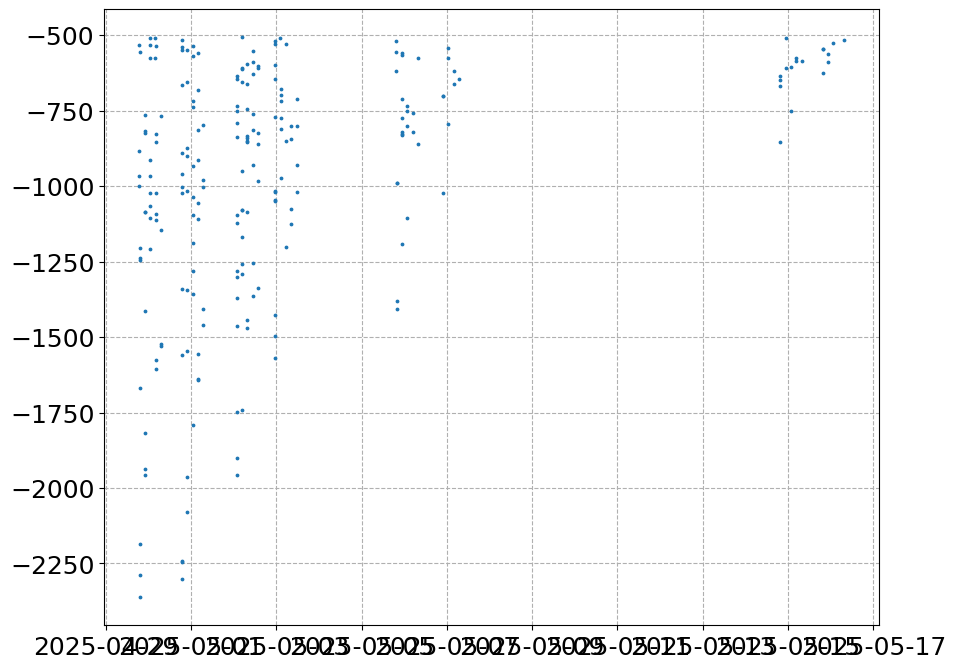

In [643]:
fig, ax = plt.subplots()

ax.scatter(df_inv.index, df_inv[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], s=3)

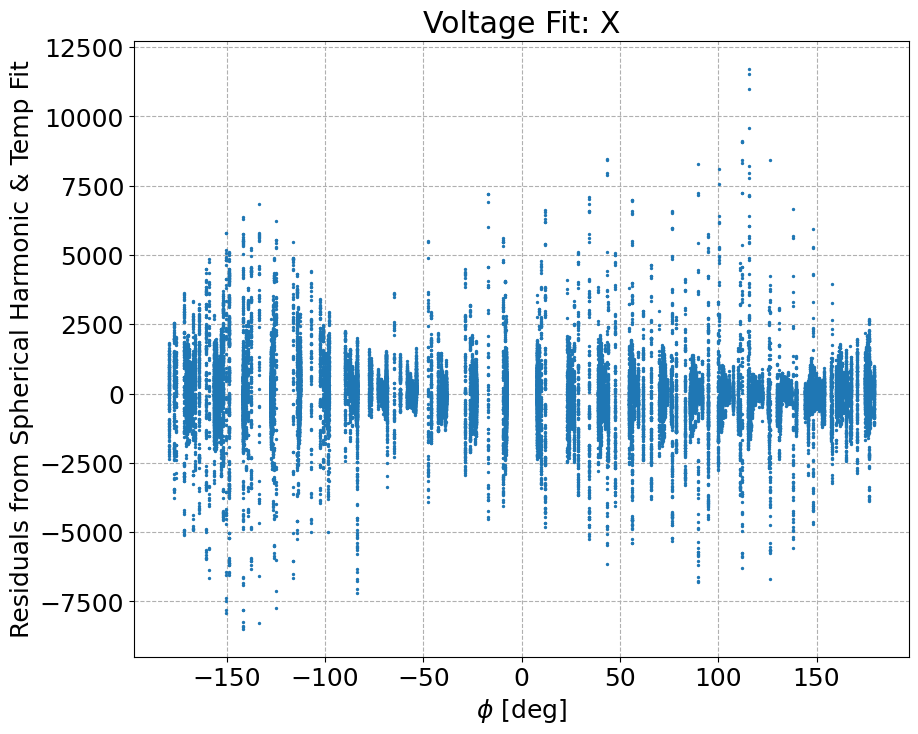

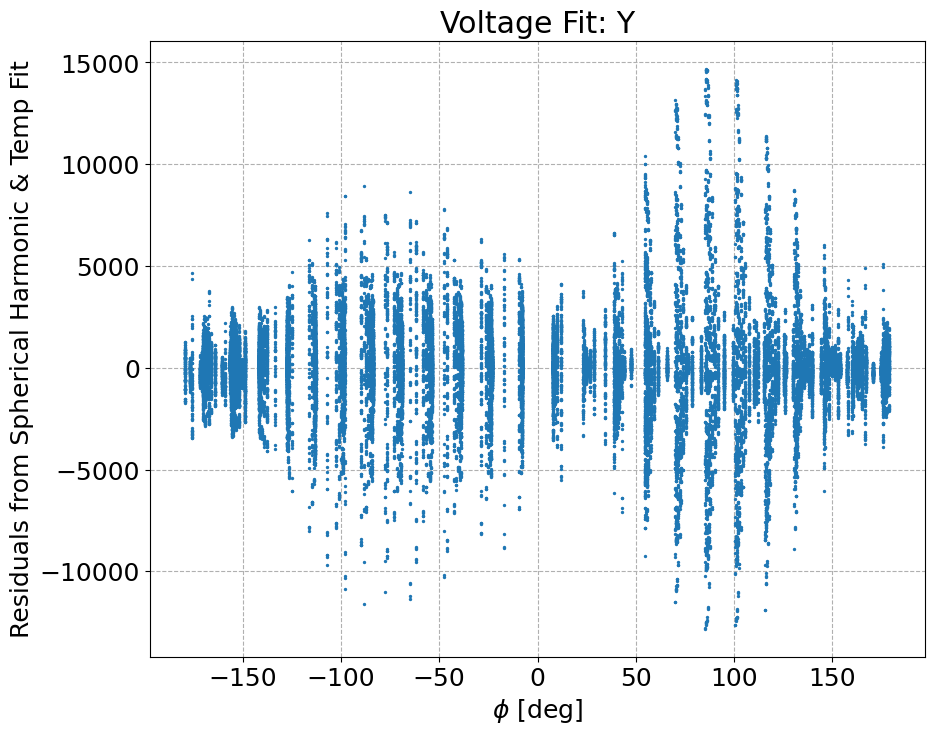

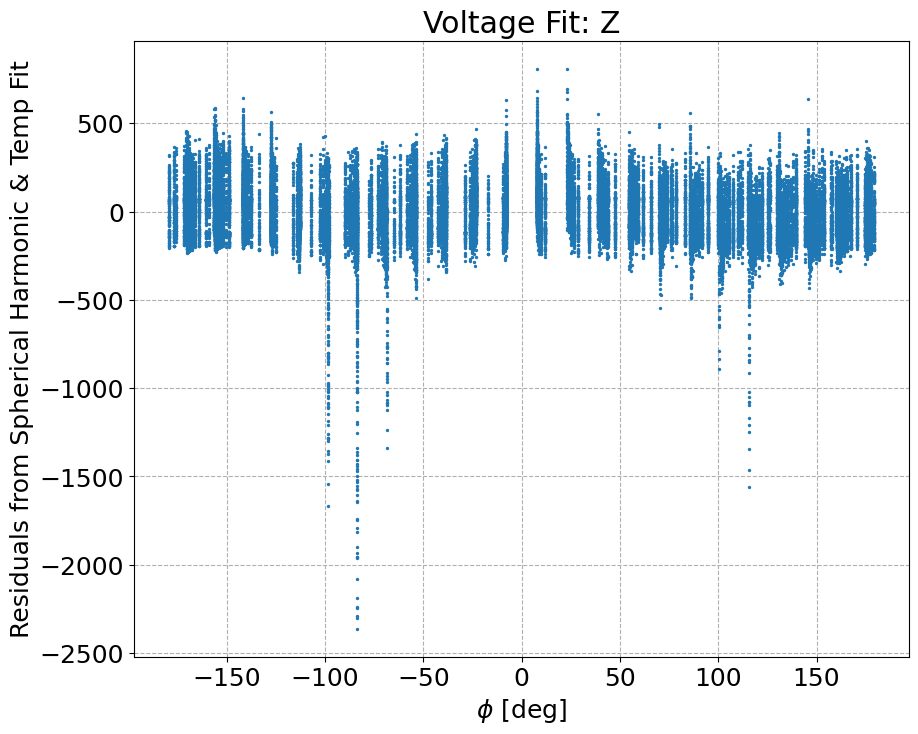

In [634]:
for comp in comps:
    fig, ax = plt.subplots()

    ax.scatter(df_.phi_B_true_deg, df_[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], s=2)

    ax.set_xlabel(r'$\phi$ [deg]')
    ax.set_ylabel('Residuals from Spherical Harmonic & Temp Fit');
    ax.set_title(f"Voltage Fit: {comp}");

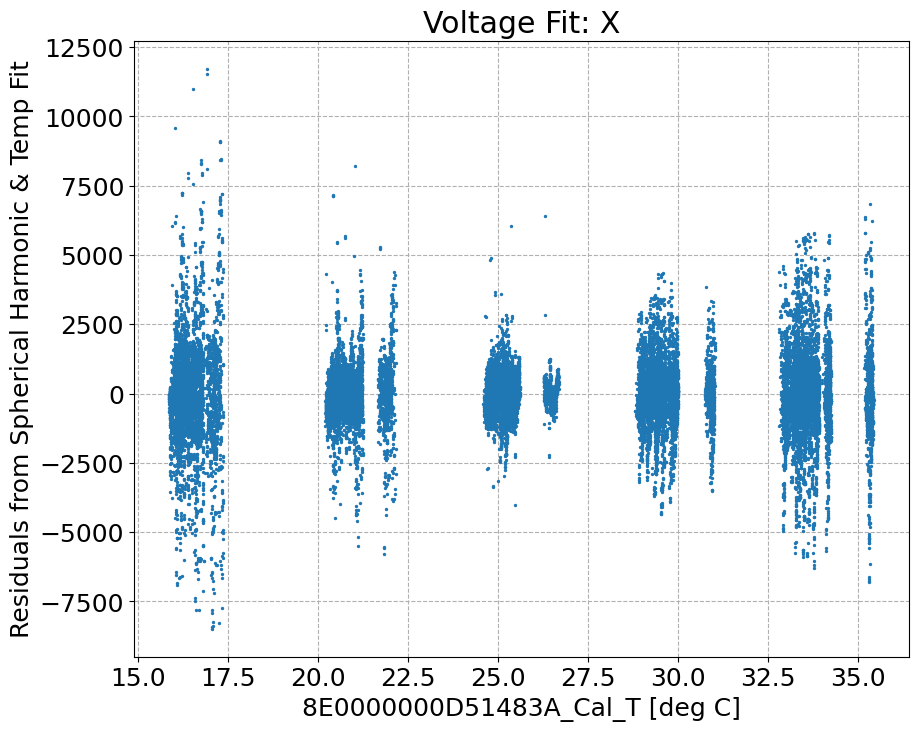

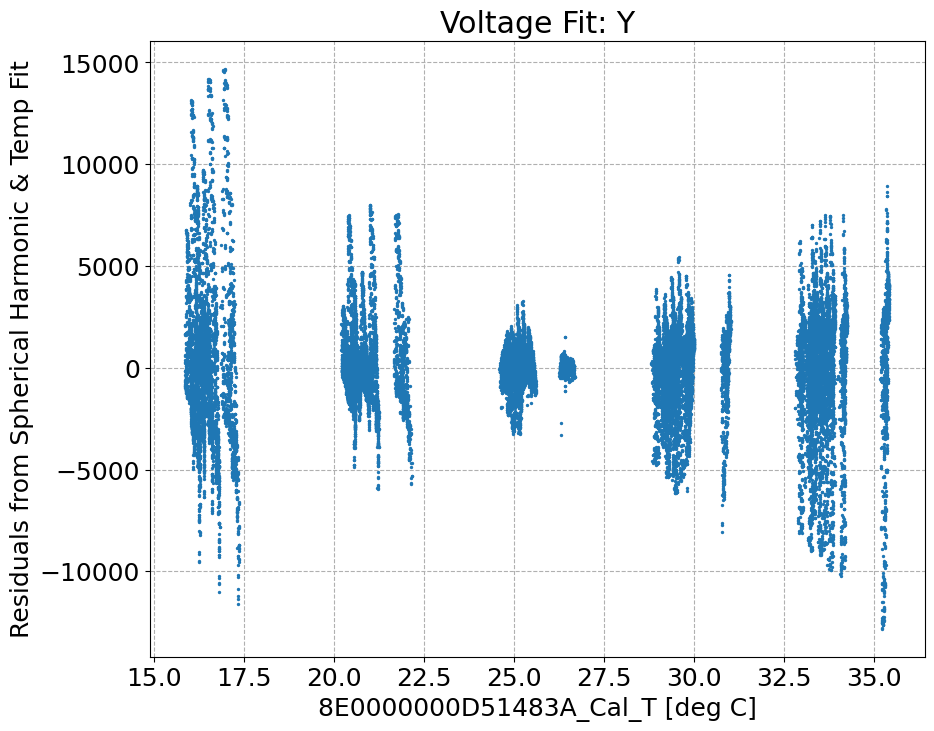

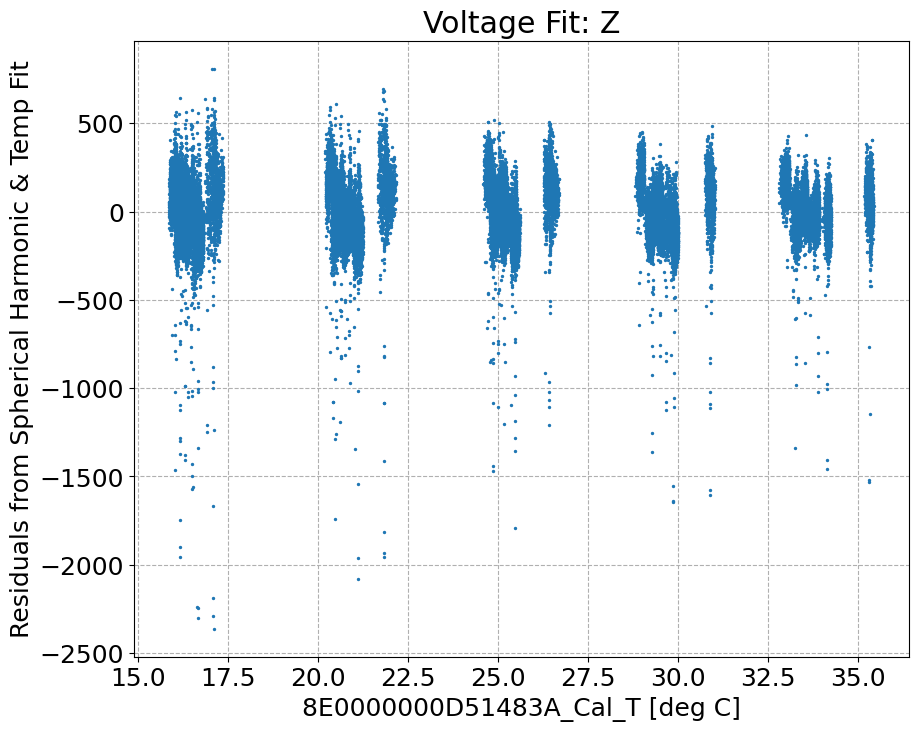

In [635]:
for comp in comps:
    fig, ax = plt.subplots()

    ax.scatter(df_[f'{probe}_Cal_T'], df_[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], s=2)

    ax.set_xlabel(f'{probe}_Cal_T [deg C]')
    ax.set_ylabel('Residuals from Spherical Harmonic & Temp Fit');
    ax.set_title(f"Voltage Fit: {comp}");

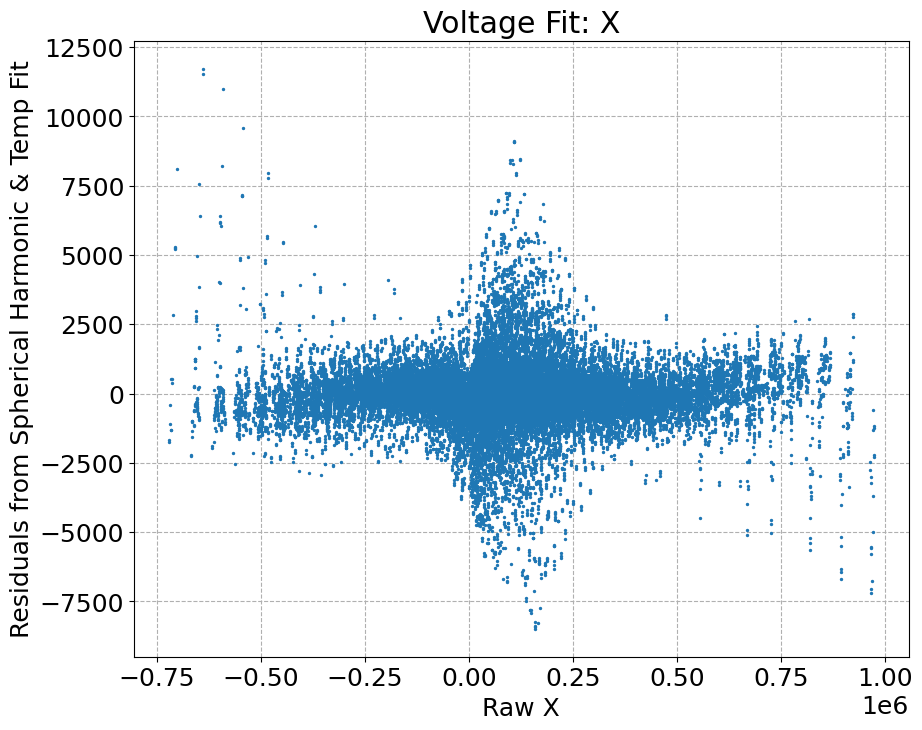

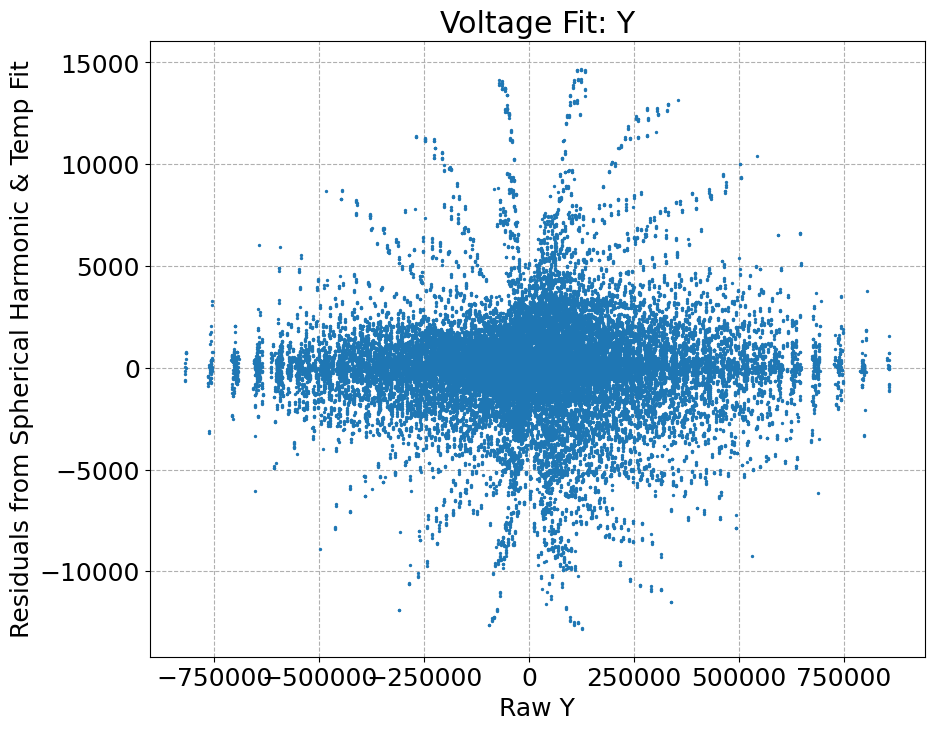

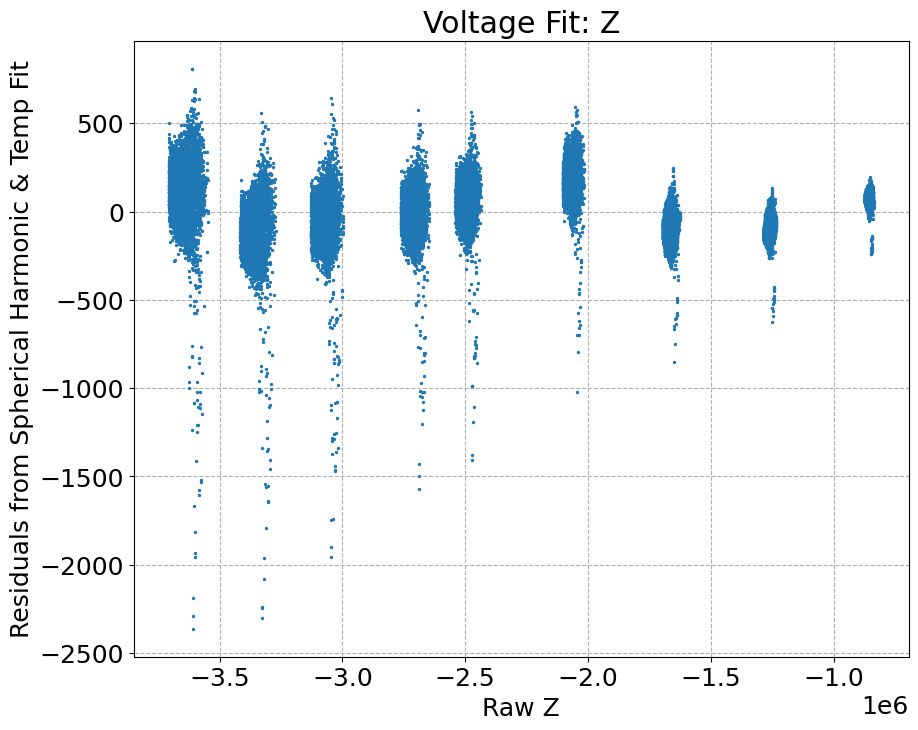

In [636]:
for comp in comps:
    fig, ax = plt.subplots()

    ax.scatter(df_[f'{probe}_Raw_{comp}'], df_[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], s=2)

    ax.set_xlabel(f'Raw {comp}')
    ax.set_ylabel('Residuals from Spherical Harmonic & Temp Fit');
    ax.set_title(f"Voltage Fit: {comp}");

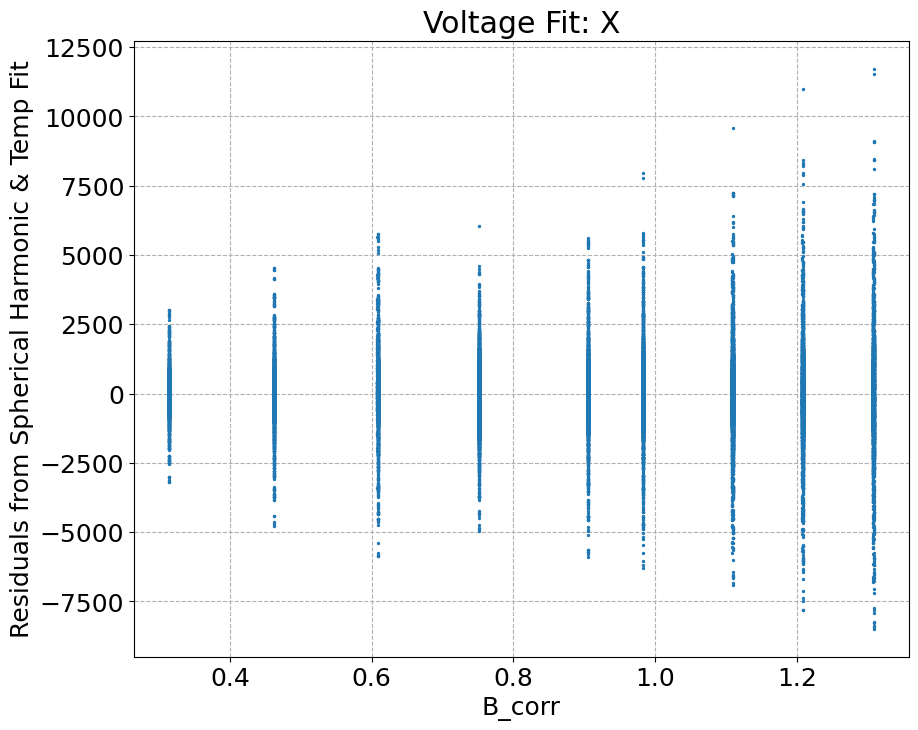

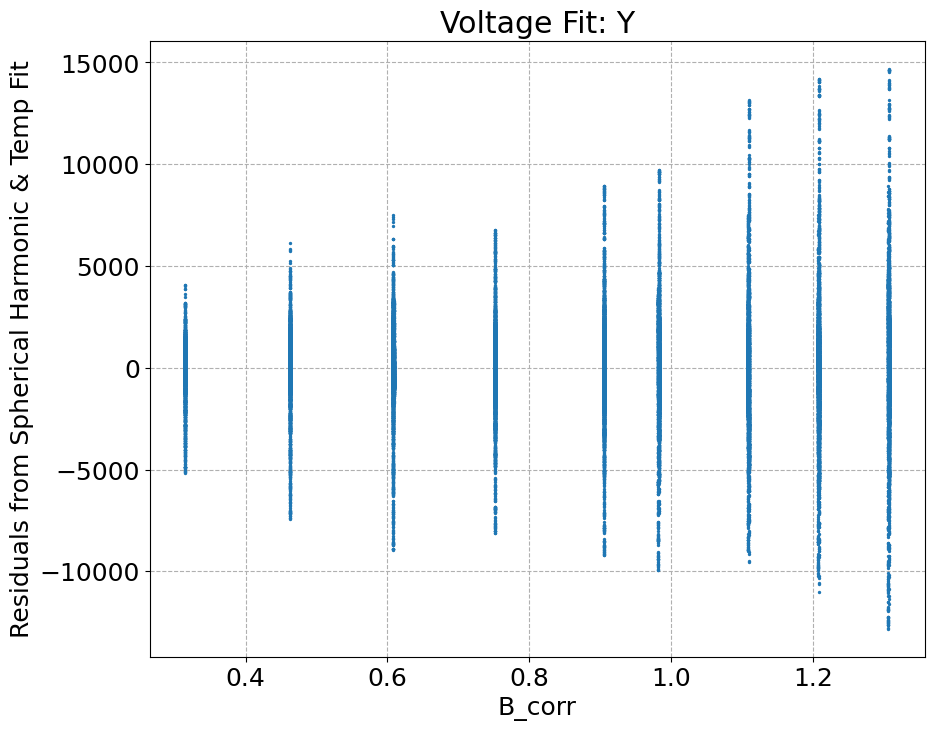

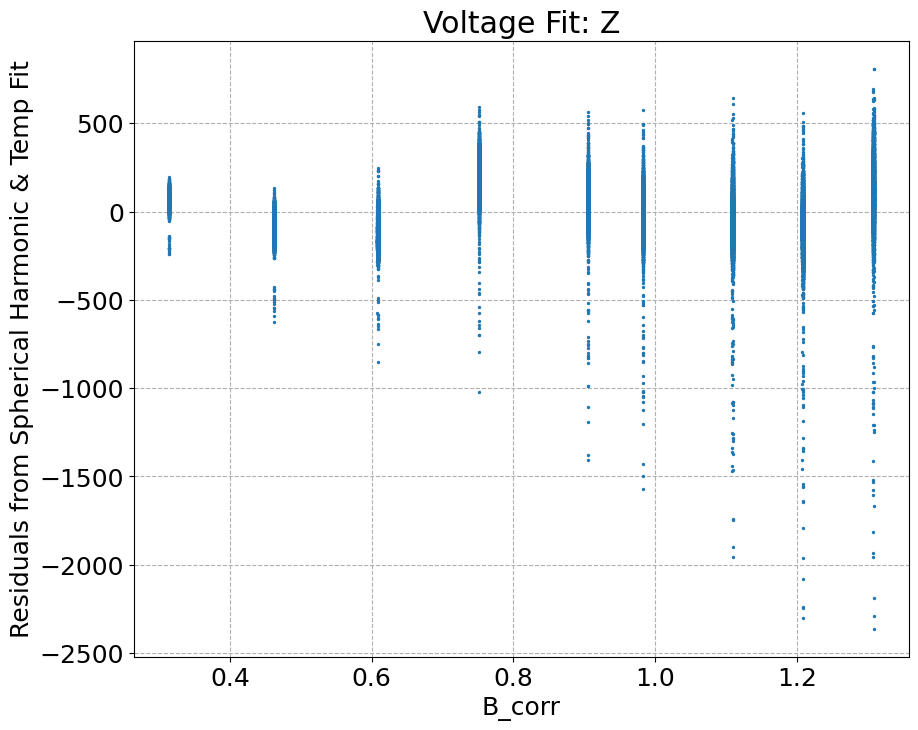

In [637]:
for comp in comps:
    fig, ax = plt.subplots()

    ax.scatter(df_[f'B_corr'], df_[f'{probe}_Raw_{comp}_min_simul_rot_temp_B'], s=2)

    ax.set_xlabel(f'B_corr')
    ax.set_ylabel('Residuals from Spherical Harmonic & Temp Fit');
    ax.set_title(f"Voltage Fit: {comp}");

In [303]:
dB

array([0.00054198, 0.00054765, 0.00057098, ..., 0.00039729, 0.00011639,
       0.00014605])

In [299]:
Bvec_fit

array([[-0.02205774, -0.01751713,  1.30778417],
       [-0.02205713, -0.01751665,  1.30774878],
       [-0.02205788, -0.01751726,  1.30779493],
       ...,
       [-0.06059754, -0.04752962,  0.30475921],
       [-0.07057108, -0.03093426,  0.30475546],
       [-0.07057209, -0.03093471,  0.30475979]])

In [300]:
Bvec_meas

array([[-0.02151575, -0.01405711,  1.30783496],
       [-0.02150948, -0.01402964,  1.30779996],
       [-0.02148691, -0.01404464,  1.30784634],
       ...,
       [-0.06020025, -0.0483752 ,  0.30470489],
       [-0.07045469, -0.03186907,  0.30468606],
       [-0.07042604, -0.03188724,  0.3046954 ]])

### INVERT

In [2348]:
######## final step -- invert

In [2408]:
from scipy.optimize import fsolve
from scipy.optimize import root

In [2516]:
# get the 3 functions, using result_dict_B
#Vx_forward = get_simultaneous_fit_rot_temp_B_abg_fixed(
#Vx_forward = get_simultaneous_fit_rot_temp_B_abg_float(
Vx_forward = get_simultaneous_fit_rot_temp_B_v2(
        theta=df_['theta_B_true'].values,phi=df_['phi_B_true'].values,
        B_rescaled=df_['B_corr_rescaled'].values,
        temp_rescaled=df_[f'{probe}_Cal_T_rescaled'].values,
        **result_dict_B['X'].params
)
# Vy_forward = get_simultaneous_fit_rot_temp_B_abg_fixed(
#Vy_forward = get_simultaneous_fit_rot_temp_B_abg_float(
Vy_forward = get_simultaneous_fit_rot_temp_B_v2(
        theta=df_['theta_B_true'].values,phi=df_['phi_B_true'].values,
        B_rescaled=df_['B_corr_rescaled'].values,
        temp_rescaled=df_[f'{probe}_Cal_T_rescaled'].values,
        **result_dict_B['Y'].params
)
#Vz_forward = get_simultaneous_fit_rot_temp_B_abg_fixed(
#Vz_forward = get_simultaneous_fit_rot_temp_B_abg_float(
Vz_forward = get_simultaneous_fit_rot_temp_B_v2(
        theta=df_['theta_B_true'].values,phi=df_['phi_B_true'].values,
        B_rescaled=df_['B_corr_rescaled'].values,
        temp_rescaled=df_[f'{probe}_Cal_T_rescaled'].values,
        **result_dict_B['Z'].params
)

In [2517]:
def V_forward(B, theta, phi, T, params1, params2, params3):
    V1 = Vx_forward(theta, phi, T, B, **params1)
    V2 = Vy_forward(theta, phi, T, B, **params2)
    V3 = Vz_forward(theta, phi, T, B, **params3)
    return np.array([V1, V2, V3])

In [2518]:
params1, params2, params3 = result_dict_B['X'].params, result_dict_B['Y'].params, result_dict_B['Z'].params

In [2522]:
Vs = V_forward(df_.B_corr_rescaled.values, df_.theta_B_true.values,
               df_.phi_B_true.values, df_[f'{probe}_Cal_T_rescaled'].values,
               result_dict_B['X'].params, result_dict_B['Y'].params, result_dict_B['Z'].params)

In [2520]:
Vs = V_forward(df_.B_corr_rescaled.values[0], df_.theta_B_true.values[0],
               df_.phi_B_true.values[0], df_[f'{probe}_Cal_T_rescaled'].values[0],
               result_dict_B['X'].params, result_dict_B['Y'].params, result_dict_B['Z'].params)

In [2481]:
Vx_forward(df_.B_corr_rescaled.values[0], df_.theta_B_true.values[0],
           df_.phi_B_true.values[0], df_[f'{probe}_Cal_T_rescaled'].values[0],
           **result_dict_B['X'].params)

ValueError: non-broadcastable output operand with shape () doesn't match the broadcast shape (1,)

In [2521]:
Vs.shape

(3, 1)

In [2468]:
Vs

array([[    6472.61566764,     8745.51259762,     4525.55846543, ...,
           30306.96481505,    30311.71344328,   -19106.61375585],
       [   81007.4374496 ,    68484.42374103,    56335.2530731 , ...,
         -218883.86449589,  -218890.54431863,  -220102.8748531 ],
       [-2090751.48209093, -2090557.17822223, -2090528.64578854, ...,
          849402.1618431 ,   849422.97660586,   848609.82305546]])

In [2549]:
def residual(x, V_meas, T, params1, params2, params3):
    B, theta, phi = x
    V_pred = V_forward(B, theta, phi, T, params1, params2, params3)
    return (V_pred - V_meas)[:,0].astype(float)

In [2524]:
Vmag = ((df_['Raw_X']**2 + df_['Raw_Y']**2 + df_['Raw_Z']**2)**(1/2)).values

In [2525]:
Vmag

array([2091987.45382304, 2091536.8629919 , 2091091.50133369, ...,
        877520.16315752,  877538.66609113,  876693.46002237])

In [2526]:
slope_guess = 2.86e6 # ADC/T

In [2527]:
B_guess = Vmag / slope_guess

In [2528]:
B_guess.max()

1.3008939488309352

In [2529]:
# which data point
i = 0

In [2595]:
meas = df_.iloc[i]
#sign_I_bool = meas['Magnet Current [A]'] < 0
#sign_I = sign_I_bool.astype(float)*2. - 1.
V_meas = meas[['Raw_X', 'Raw_Y', 'Raw_Z']].values.reshape((3,1))
T_meas = meas[f'{probe}_Cal_T_rescaled']
#B_true = sign_I * meas[['Bx_true', 'By_true', 'Bz_true']].values
# NEED TO RESCALE B
B_true = meas['B_corr_rescaled']

In [2596]:
V_meas, T_meas

(array([[3889.0],
        [75914.0],
        [-2090606.0]], dtype=object),
 -1.0)

In [2597]:
B_true

-0.5745420338934418

In [2598]:
residual(x0, V_meas, T_meas, params1, params2, params3)

array([   2248.63569409,   28679.60249463, -657580.99979831])

In [2591]:
x0 = [-np.linalg.norm(B_true), meas['theta_B_true'], meas['phi_B_true']]
residual(x0, V_meas, T_meas, params1, params2, params3)

array([ -12700.45102985,   81297.91738499, -604705.02229094])

In [2592]:
V_meas

array([[3889.0],
       [75914.0],
       [-2090606.0]], dtype=object)

In [2593]:
V_forward(-np.linalg.norm(B_true), meas['theta_B_true'], meas['phi_B_true'], T_meas, params1, params2, params3)

array([[   -8811.45102985],
       [  157211.91738499],
       [-2695311.02229094]])

In [2594]:
Vx_forward( meas['theta_B_true'], meas['phi_B_true'], T_meas, -np.linalg.norm(B_true), **params1)

array([2.88970557e+15])

In [2608]:
# solve!
#x0 = [B_guess[i], 0., 0.]
#x0 = [B_guess[i], meas['theta_B_true'], meas['phi_B_true']]
###x0 = [-np.linalg.norm(B_true), meas['theta_B_true'], meas['phi_B_true']]
x0 = [B_true, meas['theta_B_true'], meas['phi_B_true']]
sol = root(
    residual, x0,
    args=(V_meas, T_meas, params1, params2, params3)
)

In [2609]:
B_est, theta_est, phi_est = sol.x

In [2610]:
B_est

-0.5744889858634922

In [2611]:
theta_est, phi_est

(0.019605787825469078, -2.7429067968407423)

In [2612]:
###np.linalg.norm(B_true)
B_true

-0.5745420338934418

In [2613]:
meas['theta_B_true'], meas['phi_B_true']

(0.021738740686779848, -2.653462156764493)

In [2607]:
B_guess[i]

0.7314641446933702

- Seems like we might need least-squares.

In [ ]:
data, theta=df_['theta_B_true'].values, phi=df_['phi_B_true'].values, 
                                        temp_rescaled=tempdata, B_rescaled=Bdata, params=params,
                                        weights=1/(sigma_est*np.ones_like(df_[f'{probe}_Raw_{comp}'].values)), scale_covar=False)

In [ ]:
def inv_B(B, T, theta, phi, V1, V2, V3, params):
    return [()]

In [ ]:
def inv_B_v2(B, V, T, params):
    return [(V_forward(B, T, **params) - V)[0]]

In [ ]:
inv_B(np.array([1.]), np.array([2.795882852e6]), np.array([20.]), result.params)

In [ ]:
fsolve(func=inv_B_v2, x0=[1.125], args=(-2.2289e6, 20., result.params))

In [ ]:
#######

In [344]:
df_['SmarAct_Meas_Angle_1_Centered'].describe()

count    1197.000000
mean        6.518797
std         4.602132
min        -1.000005
25%         2.999997
50%         6.999996
75%        10.999995
max        14.000003
Name: SmarAct_Meas_Angle_1_Centered, dtype: float64

In [345]:
df_['SmarAct_Meas_Angle_2_Centered'].describe()

count    1197.000000
mean       -0.601502
std       102.168654
min      -180.000000
25%       -89.999996
50%        -0.000002
75%        89.999999
max       180.000000
Name: SmarAct_Meas_Angle_2_Centered, dtype: float64

In [346]:
B0

1.109290785301546

In [347]:
df_.B_corr.describe()

count    1197.000000
mean        1.109291
std         0.000018
min         1.109261
25%         1.109275
50%         1.109289
75%         1.109306
max         1.109324
Name: B_corr, dtype: float64

In [348]:
np.isnan(1/(sigma_est*B0*np.ones_like(Bs_meas))).sum()

0

In [306]:
B0

0.8518493368371125

In [336]:
df_[f'{probe_ID}_Cal_T'].describe()

count    1197.000000
mean       20.865734
std         0.067593
min        20.717000
25%        20.804000
50%        20.881000
75%        20.919000
max        20.983000
Name: 8E0000000D51483A_Cal_T, dtype: float64

## Calibration

## Plots

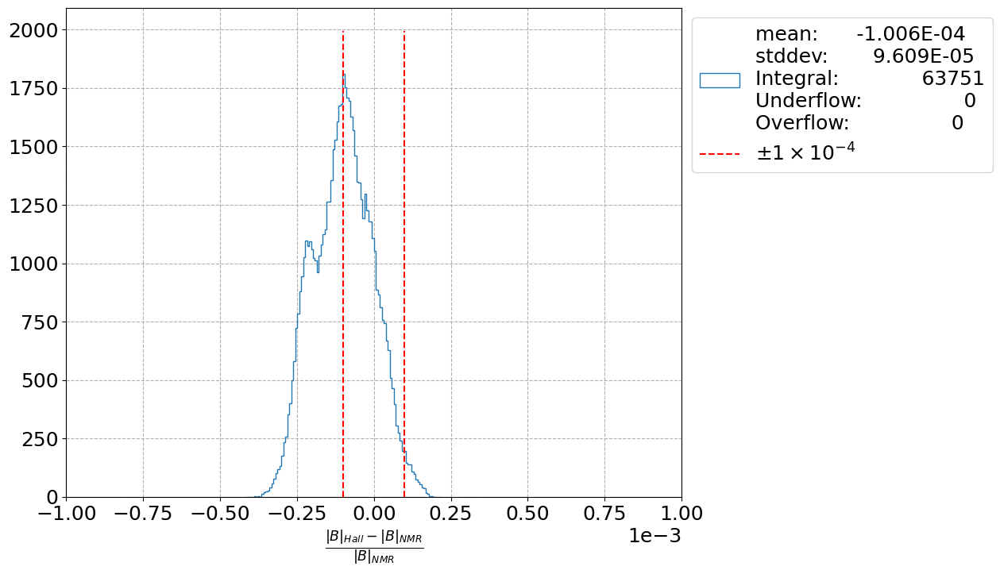

In [281]:
# |B|_Bergsma vs. |B|_true
#df_ = df.copy()
df_ = df.query('has_nmr > 0.999').copy()
fig, ax = plt.subplots()

x = (df_[f'{probe_ID}_Cal_Bmag']-df_['B_corr'])/df_['B_corr']
xmi = np.min(x)
xma = np.max(x)
xra = xma-xmi
bins = np.linspace(xmi-0.05*xra, xma+0.05*xra, 100)

n, _, _ = ax.hist(x, histtype='step', bins=bins, label=get_label(x, bins=bins));

nm = np.max(n)
ax.plot([-1e-4, -1e-4], [0, nm*1.1], 'r--', label=r'$\pm 1 \times 10^{-4}$')
ax.plot([1e-4, 1e-4], [0, nm*1.1], 'r--')#, label=r'$\pm 1 \times 10^{-4}$')

ax.ticklabel_format(axis='x', style='sci', scilimits=(0,0))

ax.set_xlim([-1e-3, 1e-3])

ax.set_xlabel(r'$\frac{|B|_{Hall} - |B|_{NMR}}{|B|_{NMR}}$');
ax.legend(loc='upper left', bbox_to_anchor=(1.0,1.0));

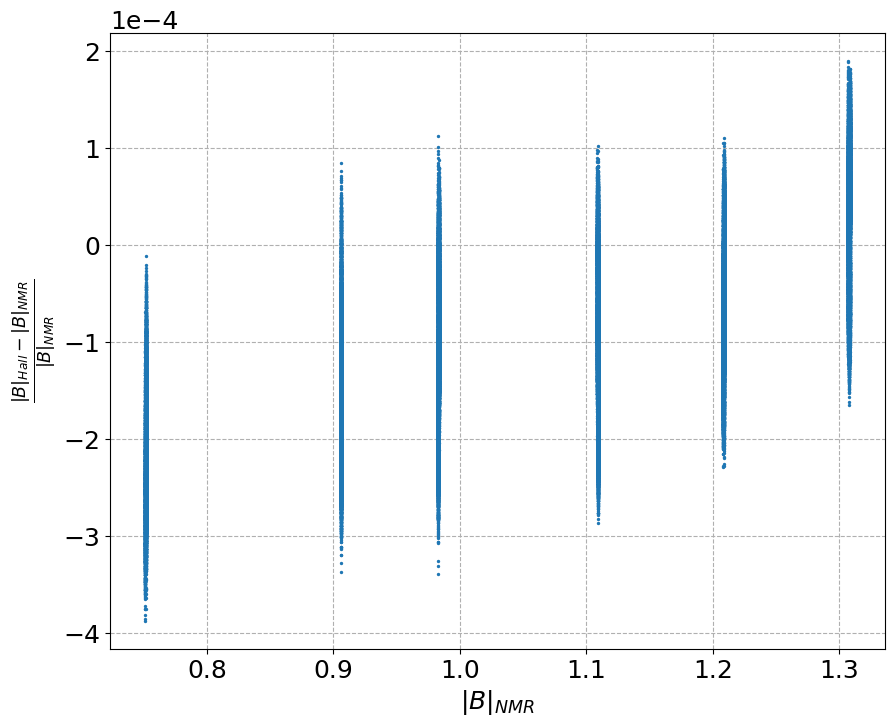

In [270]:
# |B|_Bergsma vs. |B|_true
##df_ = df.copy()
fig, ax = plt.subplots()

x = (df_[f'{probe_ID}_Cal_Bmag']-df_['B_corr'])/df_['B_corr']
xmi = np.min(x)
xma = np.max(x)
xra = xma-xmi
bins = np.linspace(xmi-0.05*xra, xma+0.05*xra, 100)

#ax.hist(x, histtype='step', bins=bins, label=get_label(x, bins=bins));

ax.scatter(df_['B_corr'], x, s=2);

ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))

ax.set_xlabel(r'$|B|_{NMR}$')
ax.set_ylabel(r'$\frac{|B|_{Hall} - |B|_{NMR}}{|B|_{NMR}}$');
#ax.legend(loc='upper left', bbox_to_anchor=(1.0,1.0));

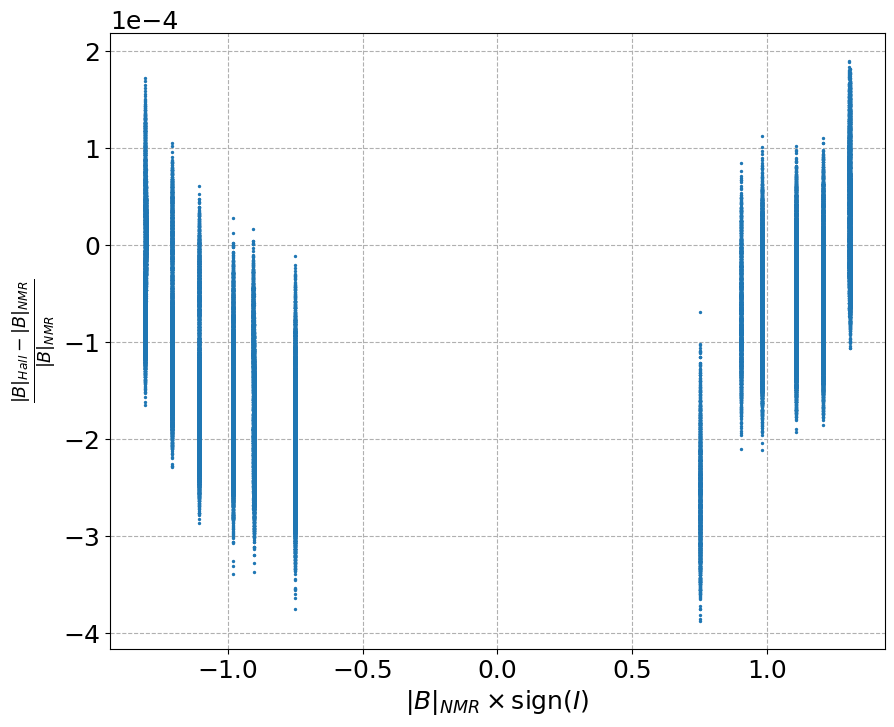

In [271]:
# field strength + dir
# |B|_Bergsma vs. |B|_true
##df_ = df.copy()
fig, ax = plt.subplots()

x = (df_[f'{probe_ID}_Cal_Bmag']-df_['B_corr'])/df_['B_corr']
xmi = np.min(x)
xma = np.max(x)
xra = xma-xmi
bins = np.linspace(xmi-0.05*xra, xma+0.05*xra, 100)

#ax.hist(x, histtype='step', bins=bins, label=get_label(x, bins=bins));

ax.scatter(df_['B_corr'] * np.sign(df_['Magnet Current [A]']), x, s=2);

ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))

ax.set_xlabel(r'$|B|_{NMR} \times \mathrm{sign}(I)$')
ax.set_ylabel(r'$\frac{|B|_{Hall} - |B|_{NMR}}{|B|_{NMR}}$');
#ax.legend(loc='upper left', bbox_to_anchor=(1.0,1.0));

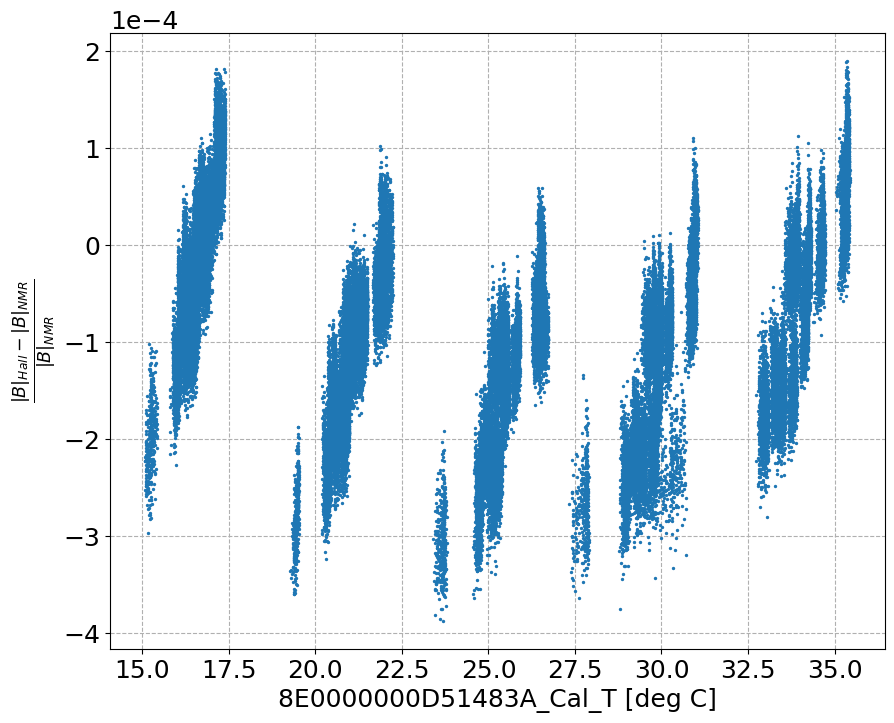

In [272]:
# TEMP
# |B|_Bergsma vs. |B|_true
##df_ = df.copy()
fig, ax = plt.subplots()

x = (df_[f'{probe_ID}_Cal_Bmag']-df_['B_corr'])/df_['B_corr']
xmi = np.min(x)
xma = np.max(x)
xra = xma-xmi
bins = np.linspace(xmi-0.05*xra, xma+0.05*xra, 100)

#ax.hist(x, histtype='step', bins=bins, label=get_label(x, bins=bins));

ax.scatter(df_[f'{probe_ID}_Cal_T'], x, s=2);

ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))

ax.set_xlabel(f'{probe_ID}_Cal_T [deg C]')
ax.set_ylabel(r'$\frac{|B|_{Hall} - |B|_{NMR}}{|B|_{NMR}}$');
#ax.legend(loc='upper left', bbox_to_anchor=(1.0,1.0));

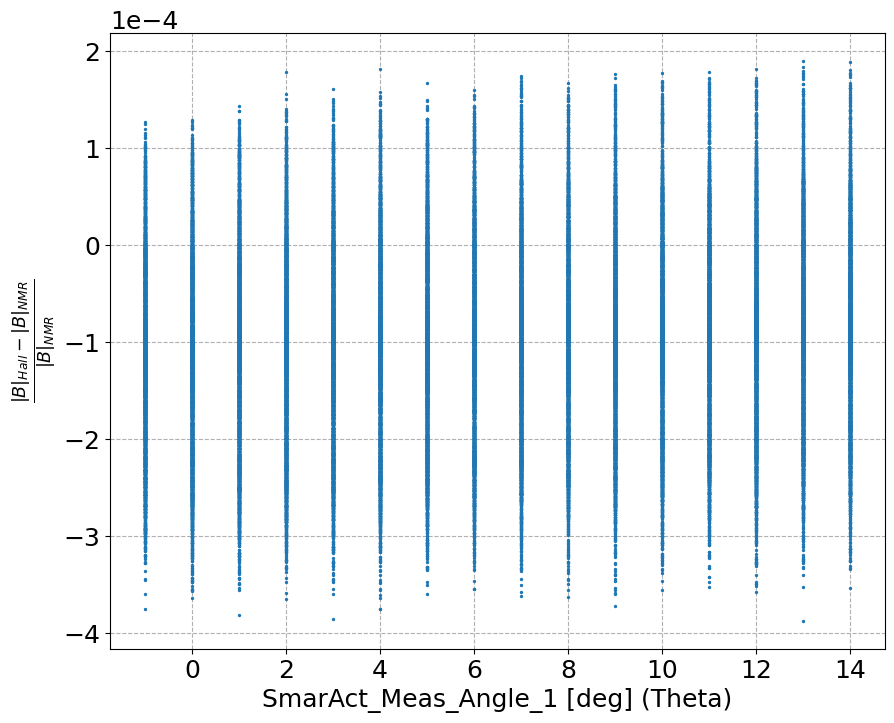

In [282]:
# ANGLE 1 (theta)
# |B|_Bergsma vs. |B|_true
##df_ = df.copy()
fig, ax = plt.subplots()

x = (df_[f'{probe_ID}_Cal_Bmag']-df_['B_corr'])/df_['B_corr']
xmi = np.min(x)
xma = np.max(x)
xra = xma-xmi
bins = np.linspace(xmi-0.05*xra, xma+0.05*xra, 100)

#ax.hist(x, histtype='step', bins=bins, label=get_label(x, bins=bins));

ax.scatter(df_['SmarAct_Meas_Angle_1'], x, s=2);

ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))

ax.set_xlabel(f'SmarAct_Meas_Angle_1 [deg] (Theta)')
ax.set_ylabel(r'$\frac{|B|_{Hall} - |B|_{NMR}}{|B|_{NMR}}$');
#ax.legend(loc='upper left', bbox_to_anchor=(1.0,1.0));

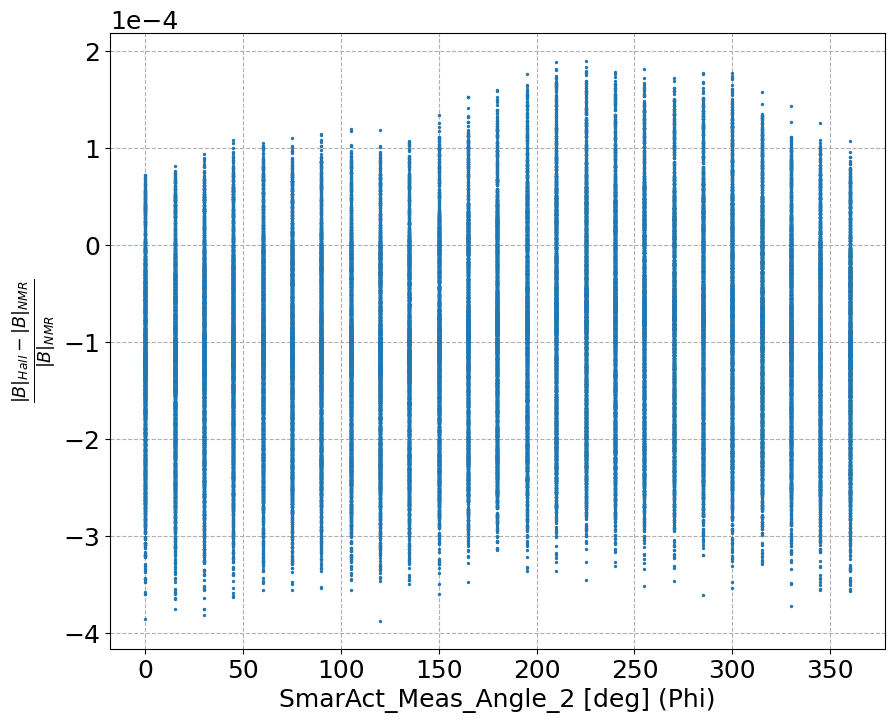

In [283]:
# ANGLE 2 (phi)
# |B|_Bergsma vs. |B|_true
##df_ = df.copy()
fig, ax = plt.subplots()

x = (df_[f'{probe_ID}_Cal_Bmag']-df_['B_corr'])/df_['B_corr']
xmi = np.min(x)
xma = np.max(x)
xra = xma-xmi
bins = np.linspace(xmi-0.05*xra, xma+0.05*xra, 100)

#ax.hist(x, histtype='step', bins=bins, label=get_label(x, bins=bins));

ax.scatter(df_['SmarAct_Meas_Angle_2'], x, s=2);

ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))

ax.set_xlabel(f'SmarAct_Meas_Angle_2 [deg] (Phi)')
ax.set_ylabel(r'$\frac{|B|_{Hall} - |B|_{NMR}}{|B|_{NMR}}$');
#ax.legend(loc='upper left', bbox_to_anchor=(1.0,1.0));

In [273]:
df_.query('"2025-05-13 10:00" <= Datetime <= "2025-05-14 10:00"')

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,has_nmr,B,B_corr,Cal_X,Cal_Y,Cal_Z,Cal_Bmag,Cal_Trans,Cal_Theta,Cal_Phi
Datetime,,,,,,,,,,,,,,,,,,,,,


In [274]:
x.describe()

count    63751.000000
mean        -0.000101
std          0.000096
min         -0.000387
25%         -0.000172
50%         -0.000099
75%         -0.000031
max          0.000190
dtype: float64

In [275]:
df_.B_corr.describe()

count    63751.000000
mean         1.071725
std          0.178172
min          0.751134
25%          0.982307
50%          1.108766
75%          1.208429
max          1.308120
Name: B_corr, dtype: float64

In [276]:
df_.query("B_corr < 0")

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,has_nmr,B,B_corr,Cal_X,Cal_Y,Cal_Z,Cal_Bmag,Cal_Trans,Cal_Theta,Cal_Phi
Datetime,,,,,,,,,,,,,,,,,,,,,


In [277]:
df_.query("B_corr < 0").B_corr

Series([], Name: B_corr, dtype: float64)

In [278]:
df_.query("B_corr < 0").B

Series([], Name: B, dtype: float64)

In [279]:
df_.query("B_corr < 0").Cal_Bmag

Series([], Name: Cal_Bmag, dtype: float64)

In [280]:
myBEst.B(I=np.array([-53.1]))

AttributeError: 'NoneType' object has no attribute 'B'

## Validation

# Asides

## Which element is which

- Goal is to make any basic transformations (e.g. sign flip) to nicely match the basic coord
- I also want to check how I redefined Bergsma calibration and see that this is consistent as well
- Question: Do I want to reorient to make "X (global)" --> "Y (global)"? This would align SmarAct with Hall coordinates more nicely.

![orientation fit](pics/orientation_coords_v1.png)

![hall probe](pics/HP_zoom.JPG)

### Negative Polarity (map to 2yr old results)

- I believe in this polarity the field will point from the back of the probe through to the front
    - This is the polarity we need for BP

**Prescription:**
- in = Raw Z --> out = - Raw Z
- in = Raw Y --> out = + Raw X
- in = Raw X --> out = - Raw Y

**Calibration reorder:**
- in = Cal X --> out = Cal Z
- in = Cal Y --> out = Cal X
- in = Cal Z --> out = Cal Y

Looks correct

In [963]:
ddir_proc = '/home/ckampa/data/hallprobecalib_extras/datafiles/Thesis_Calibration/'

In [962]:
probe_ID = '8E0000000D51483A'

In [964]:
# load
myHPC_deb = myHPC.from_pickle(ddir_proc+f'{probe_ID}_HPC_analysis_class.pkl')

In [972]:
df_d = myHPC_deb.df_clean.query(' (run_type == "prod") & (`Magnet Current [A]` < 0)').copy()

In [973]:
df_d

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,EvapCoil (NWC),Barrel/Reservoir (FNAL),Return PS (FNAL),Return Magnet (NWC-R),Chiller Exhaust (NW),Supply Magnet (NWC-S),Supply PS (FNAL),has_nmr,B,B_corr
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-04-29 17:52:56,4/29/2025 5:52:56 PM,-281.679280,-36.923061,1.309363,0.0,112030.0,104294.0,-3705698.0,16888.0,1.307876,...,22.669810,20.180733,34.033322,14.543276,29.762731,3.123713,27.597622,1.0,1.309363,1.308052
2025-04-29 17:52:57,4/29/2025 5:52:57 PM,-281.679273,-36.922995,1.309363,0.0,112013.0,104281.0,-3705748.0,16895.0,1.307897,...,22.674915,20.180763,34.033365,14.541729,29.760422,3.125232,27.597696,1.0,1.309363,1.308052
2025-04-29 17:52:59,4/29/2025 5:52:59 PM,-281.679260,-36.922863,1.309363,0.0,112105.0,104351.0,-3705755.0,16900.0,1.307902,...,22.685124,20.180823,34.033450,14.538636,29.755803,3.128269,27.597844,1.0,1.309363,1.308053
2025-04-29 17:53:01,4/29/2025 5:53:01 PM,-281.679247,-36.922732,1.309363,0.0,112210.0,104437.0,-3705633.0,16923.0,1.307872,...,22.695334,20.180882,34.033536,14.535543,29.751185,3.131307,27.597993,1.0,1.309363,1.308053
2025-04-29 17:53:03,4/29/2025 5:53:03 PM,-281.679233,-36.922600,1.309363,0.0,112249.0,104414.0,-3705581.0,16907.0,1.307846,...,22.705544,20.180942,34.033622,14.532450,29.746566,3.134344,27.598141,1.0,1.309363,1.308053
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-17 07:23:26,5/17/2025 7:23:26 AM,-54.423891,-6.248866,0.000000,0.0,159292.0,-154731.0,-839713.0,33184.0,0.304683,...,24.778301,22.152089,32.873679,19.545909,26.187655,18.977705,28.397092,0.0,0.314316,0.314316
2025-05-17 07:23:28,5/17/2025 7:23:28 AM,-54.423892,-6.248890,0.000000,0.0,159229.0,-154803.0,-839775.0,33178.0,0.304705,...,24.769011,22.152010,32.873488,19.552342,26.186401,18.985644,28.396759,0.0,0.314339,0.314339
2025-05-17 07:23:33,5/17/2025 7:23:33 AM,-54.423895,-6.248952,0.000000,0.0,113599.0,-181839.0,-838988.0,33198.0,0.304686,...,24.745785,22.151813,32.873010,19.568426,26.183266,19.005492,28.395924,0.0,0.314346,0.314346


In [992]:
# more intuitive labels, based on a Mu2e-like coordinate system
df_d.loc[:, 'Cal_X'] = df_d.loc[:, f'{probe_ID}_Cal_Y']
df_d.loc[:, 'Cal_Y'] = df_d.loc[:, f'{probe_ID}_Cal_Z']
df_d.loc[:, 'Cal_Z'] = df_d.loc[:, f'{probe_ID}_Cal_X']
df_d.loc[:, 'Cal_Bmag'] = df_d.loc[:, f'{probe_ID}_Cal_Bmag']
# field angles
df_d.loc[:, 'Cal_Trans'] = (df_d.loc[:, 'Cal_X']**2 + df_d.loc[:, 'Cal_Y']**2)**(1/2)
df_d.loc[:, 'Cal_Theta'] = np.arctan2(df_d.loc[:, 'Cal_Trans'], df_d.loc[:, 'Cal_Bmag'])
df_d.loc[:, 'Cal_Phi'] = np.arctan2(df_d.loc[:, 'Cal_Y'], df_d.loc[:, 'Cal_X'])

In [993]:
df_d_ = df_d.query(f'(0.97 <= B_corr <= 1.0) & (18.5 <= `{probe}_Cal_T` <= 21.5) ')

In [995]:
df_d_

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,has_nmr,B,B_corr,Cal_X,Cal_Y,Cal_Z,Cal_Bmag,Cal_Trans,Cal_Theta,Cal_Phi
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-05-03 01:15:35,5/3/2025 1:15:35 AM,-176.057780,-20.997869,0.983204,0.0,103698.0,80592.0,-2754991.0,20719.0,0.982464,...,1.0,0.983204,0.982854,0.015463,-0.005604,0.982464,0.982601,0.016447,0.016737,-0.347670
2025-05-03 01:15:37,5/3/2025 1:15:37 AM,-176.057780,-20.997871,0.983204,0.0,103676.0,80580.0,-2755024.0,20717.0,0.982475,...,1.0,0.983204,0.982854,0.015458,-0.005595,0.982475,0.982612,0.016440,0.016729,-0.347288
2025-05-03 01:15:39,5/3/2025 1:15:39 AM,-176.057780,-20.997873,0.983204,0.0,103524.0,80520.0,-2755000.0,20720.0,0.982468,...,1.0,0.983204,0.982854,0.015435,-0.005541,0.982468,0.982605,0.016400,0.016688,-0.344644
2025-05-03 01:15:44,5/3/2025 1:15:44 AM,-176.057780,-20.997879,0.983204,0.0,120371.0,77272.0,-2755104.0,20736.0,0.982453,...,1.0,0.983204,0.982854,0.014387,-0.011620,0.982453,0.982627,0.018493,0.018818,-0.679403
2025-05-03 01:15:45,5/3/2025 1:15:45 AM,-176.057780,-20.997880,0.983204,0.0,120404.0,77220.0,-2755082.0,20736.0,0.982445,...,1.0,0.983204,0.982854,0.014368,-0.011632,0.982445,0.982619,0.018487,0.018811,-0.680548
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-03 02:27:55,5/3/2025 2:27:55 AM,-176.058063,-21.004060,0.983161,0.0,492570.0,-491469.0,-2669550.0,20912.0,0.952980,...,1.0,0.983161,0.982811,-0.189281,-0.147247,0.952980,0.982690,0.239810,0.239356,-2.480458
2025-05-03 02:27:56,5/3/2025 2:27:56 AM,-176.058063,-21.004066,0.983161,0.0,492565.0,-491524.0,-2669504.0,20915.0,0.952965,...,1.0,0.983161,0.982811,-0.189301,-0.147246,0.952965,0.982679,0.239825,0.239373,-2.480513
2025-05-03 02:28:01,5/3/2025 2:28:01 AM,-176.058063,-21.004100,0.983161,0.0,348464.0,-573290.0,-2666979.0,20884.0,0.952924,...,1.0,0.983161,0.982811,-0.220145,-0.095411,0.952924,0.982665,0.239931,0.239478,-2.732627


In [1001]:
# probe Z
# field in +Z
df0 = df_d_.query(f'(-1. <= SmarAct_Meas_Angle_1_Centered <= 1.)')

In [1002]:
df0

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,has_nmr,B,B_corr,Cal_X,Cal_Y,Cal_Z,Cal_Bmag,Cal_Trans,Cal_Theta,Cal_Phi
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-05-03 01:15:37,5/3/2025 1:15:37 AM,-176.05778,-20.997871,0.983204,0.0,103676.0,80580.0,-2755024.0,20717.0,0.982475,...,1.0,0.983204,0.982854,0.015458,-0.005595,0.982475,0.982612,0.016440,0.016729,-0.347288
2025-05-03 01:15:52,5/3/2025 1:15:52 AM,-176.05778,-20.997888,0.983204,0.0,135740.0,69851.0,-2755027.0,20763.0,0.982398,...,1.0,0.983204,0.982854,0.011807,-0.017171,0.982398,0.982619,0.020839,0.021204,-0.968407
2025-05-03 01:15:55,5/3/2025 1:15:55 AM,-176.05778,-20.997891,0.983204,0.0,135770.0,69886.0,-2755014.0,20782.0,0.982401,...,1.0,0.983204,0.982854,0.011820,-0.017182,0.982401,0.982622,0.020855,0.021221,-0.968225
2025-05-03 01:16:02,5/3/2025 1:16:02 AM,-176.05778,-20.997899,0.983204,0.0,148790.0,58644.0,-2754919.0,20801.0,0.982356,...,1.0,0.983204,0.982854,0.007830,-0.021888,0.982356,0.982631,0.023247,0.023653,-1.227233
2025-05-03 01:16:04,5/3/2025 1:16:04 AM,-176.05778,-20.997901,0.983204,0.0,148812.0,58537.0,-2754987.0,20806.0,0.982382,...,1.0,0.983204,0.982854,0.007791,-0.021895,0.982382,0.982657,0.023240,0.023646,-1.228930
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-03 01:27:47,5/3/2025 1:27:47 AM,-176.05778,-21.000004,0.983196,0.0,131113.0,5894.0,-2754389.0,20979.0,0.982472,...,1.0,0.983196,0.982846,-0.011525,-0.015555,0.982472,0.982662,0.019360,0.019699,-2.208463
2025-05-03 01:27:52,5/3/2025 1:27:52 AM,-176.05778,-21.000027,0.983196,0.0,127572.0,-1576.0,-2754237.0,20933.0,0.982437,...,1.0,0.983196,0.982846,-0.014272,-0.014283,0.982437,0.982644,0.020191,0.020545,-2.355781
2025-05-03 01:27:53,5/3/2025 1:27:53 AM,-176.05778,-21.000032,0.983196,0.0,127571.0,-1550.0,-2754238.0,20924.0,0.982434,...,1.0,0.983196,0.982846,-0.014262,-0.014283,0.982434,0.982641,0.020184,0.020538,-2.355458


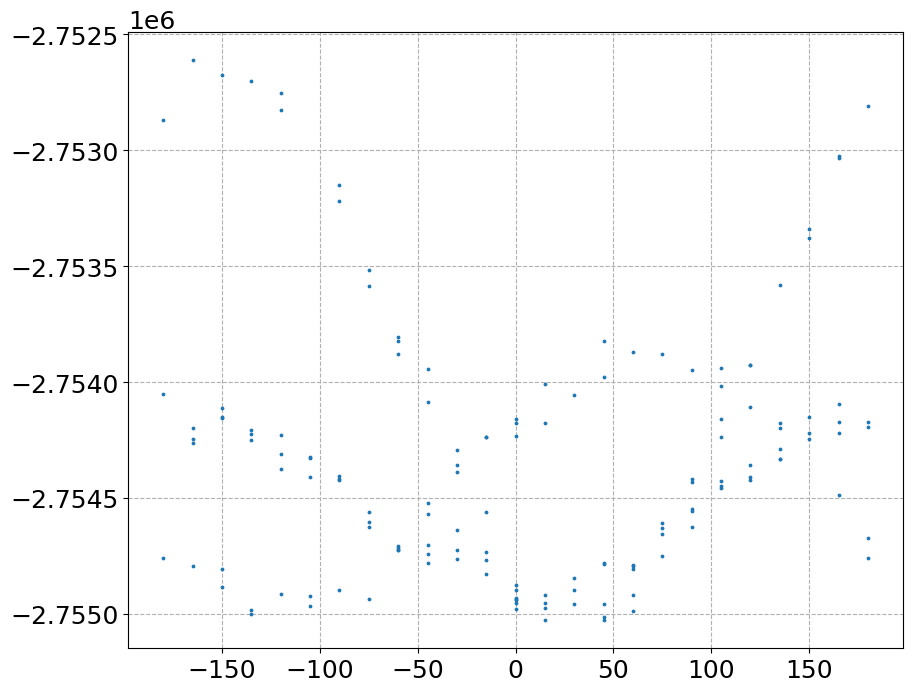

In [1003]:
fig, ax = plt.subplots()

ax.scatter(df0['SmarAct_Meas_Angle_2_Centered'], df0[f'{probe}_Raw_Z'], s=3)

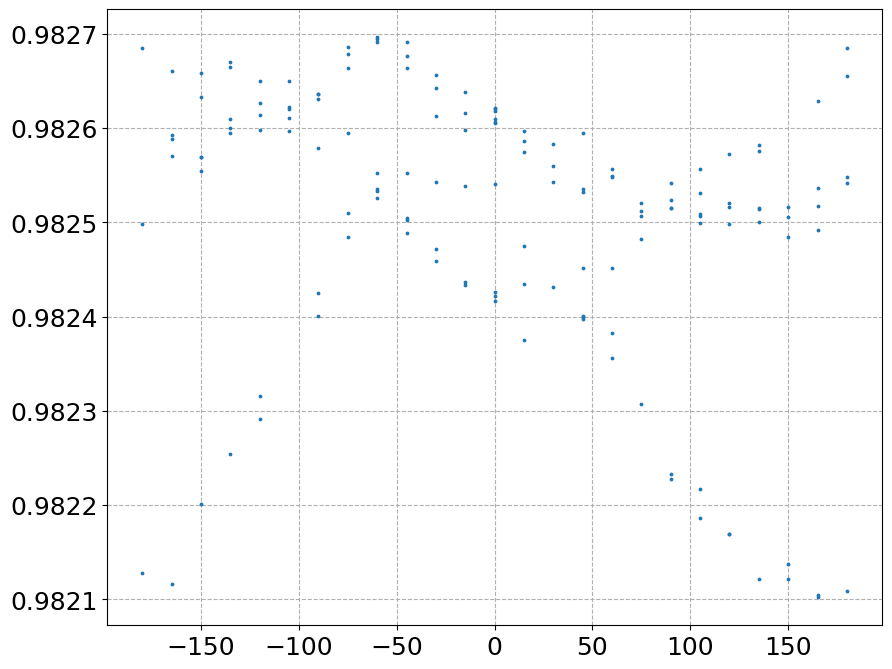

In [1004]:
fig, ax = plt.subplots()

ax.scatter(df0['SmarAct_Meas_Angle_2_Centered'], df0[f'Cal_Z'], s=3)

In [1013]:
# probe Y (x coord)
# field in -X at ~33 deg (SA2), +X at ~ -147 deg (SA2)
df0 = df_d_.query(f'(13. <= SmarAct_Meas_Angle_1_Centered)')

In [1014]:
df0

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,has_nmr,B,B_corr,Cal_X,Cal_Y,Cal_Z,Cal_Bmag,Cal_Trans,Cal_Theta,Cal_Phi
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-05-03 02:20:13,5/3/2025 2:20:13 AM,-176.058107,-21.001721,0.983164,0.0,181937.0,-569260.0,-2677084.0,20754.0,0.957053,...,1.0,0.983164,0.982814,-0.220037,-0.035233,0.957053,0.982654,0.222840,0.223002,-2.982817
2025-05-03 02:20:15,5/3/2025 2:20:15 AM,-176.058106,-21.001727,0.983164,0.0,181919.0,-569234.0,-2677076.0,20748.0,0.957048,...,1.0,0.983164,0.982814,-0.220027,-0.035227,0.957048,0.982646,0.222829,0.222993,-2.982839
2025-05-03 02:20:25,5/3/2025 2:20:25 AM,-176.058105,-21.001761,0.983164,0.0,26643.0,-568236.0,-2676013.0,20744.0,0.957290,...,1.0,0.983164,0.982814,-0.220903,0.020774,0.957290,0.982666,0.221878,0.222068,3.047828
2025-05-03 02:20:30,5/3/2025 2:20:30 AM,-176.058104,-21.001778,0.983164,0.0,-123524.0,-527111.0,-2675783.0,20743.0,0.957666,...,1.0,0.983164,0.982814,-0.207168,0.074979,0.957666,0.982682,0.220319,0.220554,2.794338
2025-05-03 02:20:33,5/3/2025 2:20:33 AM,-176.058103,-21.001788,0.983164,0.0,-123500.0,-527067.0,-2675648.0,20745.0,0.957619,...,1.0,0.983164,0.982814,-0.207152,0.074968,0.957619,0.982633,0.220300,0.220547,2.794355
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-03 02:27:55,5/3/2025 2:27:55 AM,-176.058063,-21.004060,0.983161,0.0,492570.0,-491469.0,-2669550.0,20912.0,0.952980,...,1.0,0.983161,0.982811,-0.189281,-0.147247,0.952980,0.982690,0.239810,0.239356,-2.480458
2025-05-03 02:27:56,5/3/2025 2:27:56 AM,-176.058063,-21.004066,0.983161,0.0,492565.0,-491524.0,-2669504.0,20915.0,0.952965,...,1.0,0.983161,0.982811,-0.189301,-0.147246,0.952965,0.982679,0.239825,0.239373,-2.480513
2025-05-03 02:28:01,5/3/2025 2:28:01 AM,-176.058063,-21.004100,0.983161,0.0,348464.0,-573290.0,-2666979.0,20884.0,0.952924,...,1.0,0.983161,0.982811,-0.220145,-0.095411,0.952924,0.982665,0.239931,0.239478,-2.732627


In [1016]:
#Yma = df0[f'{probe}_Raw_X'].abs().max()
Yma = df0[f'{probe}_Raw_Y'].abs().max()
Yma

646323.0

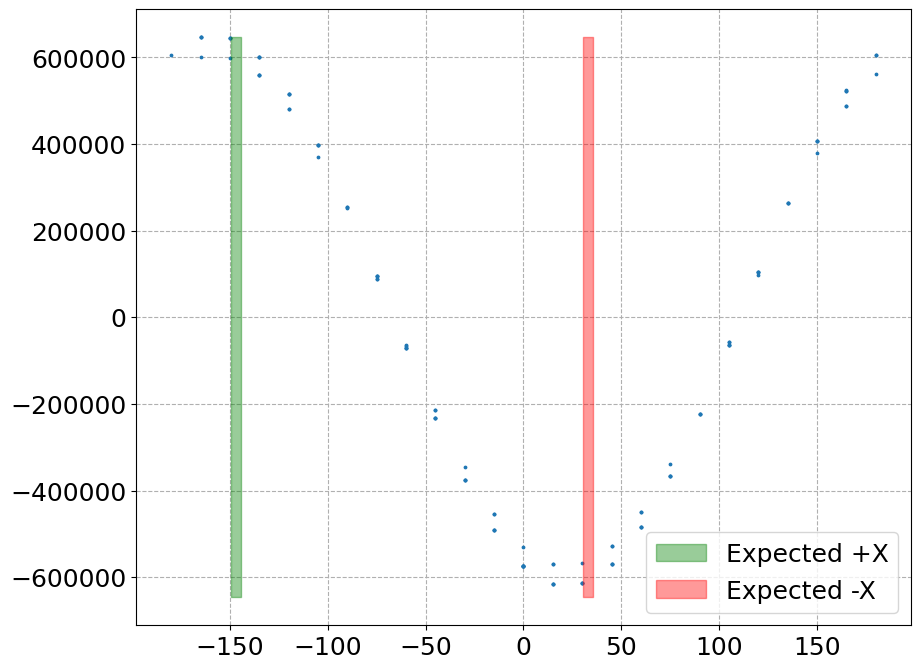

In [1020]:
fig, ax = plt.subplots()

ax.scatter(df0['SmarAct_Meas_Angle_2_Centered'], df0[f'{probe}_Raw_Y'], s=3)


ax.fill_between([-147-2.5, -147+2.5], y1=-Yma, y2=Yma, color='green', alpha=0.4, label='Expected +X')
ax.fill_between([33-2.5, 33+2.5], y1=-Yma, y2=Yma, color='red', alpha=0.4, label='Expected -X')

ax.legend()

In [1024]:
#Yma = df0[f'{probe}_Raw_X'].abs().max()
Ymac = df0['Cal_X'].abs().max()
Ymac

0.237288116

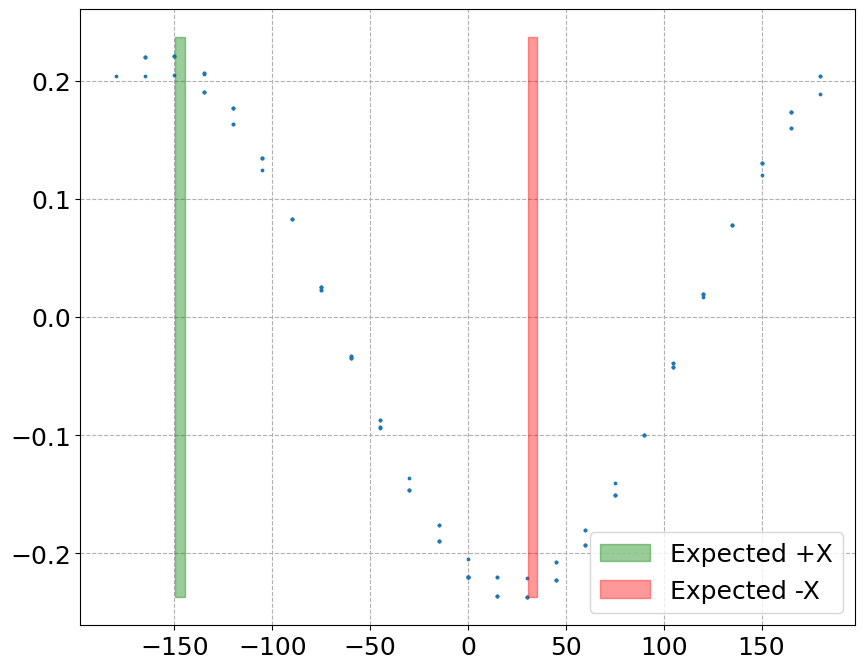

In [1025]:
fig, ax = plt.subplots()

ax.scatter(df0['SmarAct_Meas_Angle_2_Centered'], df0[f'Cal_X'], s=3)

ax.fill_between([-147-2.5, -147+2.5], y1=-Ymac, y2=Ymac, color='green', alpha=0.4, label='Expected +X')
ax.fill_between([33-2.5, 33+2.5], y1=-Ymac, y2=Ymac, color='red', alpha=0.4, label='Expected -X')

ax.legend()

In [1026]:
# probe X (y coord)
# field in +Y at 90 + 33 deg = 123 (SA2), -Y at 270 + 33 deg = 303 deg = -57 deg (SA2)
df0 = df_d_.query(f'(13. <= SmarAct_Meas_Angle_1_Centered)')

In [1027]:
df0

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,has_nmr,B,B_corr,Cal_X,Cal_Y,Cal_Z,Cal_Bmag,Cal_Trans,Cal_Theta,Cal_Phi
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-05-03 02:20:13,5/3/2025 2:20:13 AM,-176.058107,-21.001721,0.983164,0.0,181937.0,-569260.0,-2677084.0,20754.0,0.957053,...,1.0,0.983164,0.982814,-0.220037,-0.035233,0.957053,0.982654,0.222840,0.223002,-2.982817
2025-05-03 02:20:15,5/3/2025 2:20:15 AM,-176.058106,-21.001727,0.983164,0.0,181919.0,-569234.0,-2677076.0,20748.0,0.957048,...,1.0,0.983164,0.982814,-0.220027,-0.035227,0.957048,0.982646,0.222829,0.222993,-2.982839
2025-05-03 02:20:25,5/3/2025 2:20:25 AM,-176.058105,-21.001761,0.983164,0.0,26643.0,-568236.0,-2676013.0,20744.0,0.957290,...,1.0,0.983164,0.982814,-0.220903,0.020774,0.957290,0.982666,0.221878,0.222068,3.047828
2025-05-03 02:20:30,5/3/2025 2:20:30 AM,-176.058104,-21.001778,0.983164,0.0,-123524.0,-527111.0,-2675783.0,20743.0,0.957666,...,1.0,0.983164,0.982814,-0.207168,0.074979,0.957666,0.982682,0.220319,0.220554,2.794338
2025-05-03 02:20:33,5/3/2025 2:20:33 AM,-176.058103,-21.001788,0.983164,0.0,-123500.0,-527067.0,-2675648.0,20745.0,0.957619,...,1.0,0.983164,0.982814,-0.207152,0.074968,0.957619,0.982633,0.220300,0.220547,2.794355
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-03 02:27:55,5/3/2025 2:27:55 AM,-176.058063,-21.004060,0.983161,0.0,492570.0,-491469.0,-2669550.0,20912.0,0.952980,...,1.0,0.983161,0.982811,-0.189281,-0.147247,0.952980,0.982690,0.239810,0.239356,-2.480458
2025-05-03 02:27:56,5/3/2025 2:27:56 AM,-176.058063,-21.004066,0.983161,0.0,492565.0,-491524.0,-2669504.0,20915.0,0.952965,...,1.0,0.983161,0.982811,-0.189301,-0.147246,0.952965,0.982679,0.239825,0.239373,-2.480513
2025-05-03 02:28:01,5/3/2025 2:28:01 AM,-176.058063,-21.004100,0.983161,0.0,348464.0,-573290.0,-2666979.0,20884.0,0.952924,...,1.0,0.983161,0.982811,-0.220145,-0.095411,0.952924,0.982665,0.239931,0.239478,-2.732627


In [1028]:
Yma = df0[f'{probe}_Raw_X'].abs().max()
# Yma = df0[f'{probe}_Raw_Y'].abs().max()
Yma

729848.0

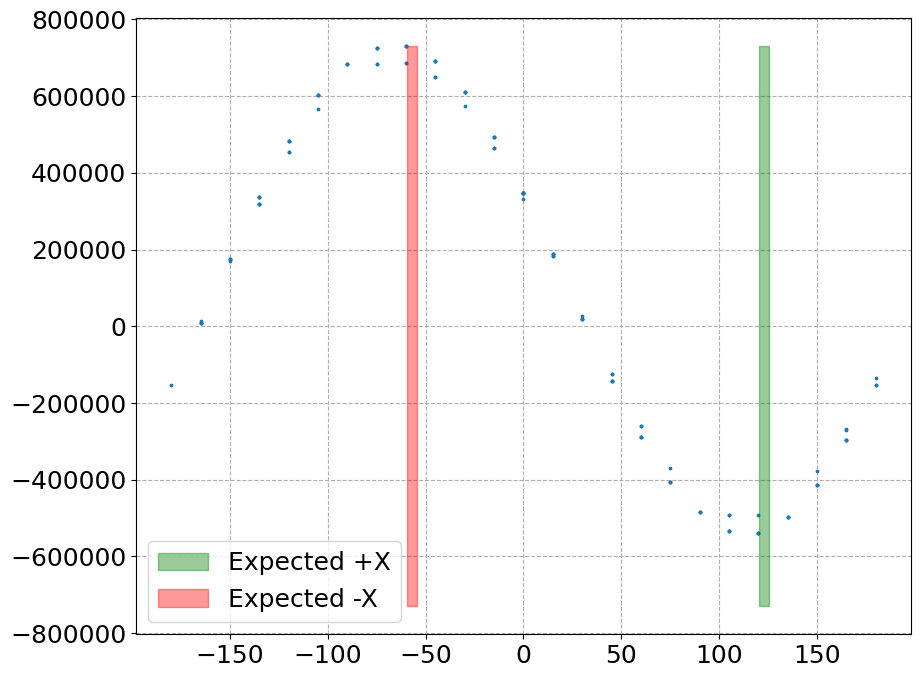

In [1030]:
fig, ax = plt.subplots()

ax.scatter(df0['SmarAct_Meas_Angle_2_Centered'], df0[f'{probe}_Raw_X'], s=3)


ax.fill_between([123.-2.5, 123.+2.5], y1=-Yma, y2=Yma, color='green', alpha=0.4, label='Expected +X')
ax.fill_between([-57.-2.5, -57.+2.5], y1=-Yma, y2=Yma, color='red', alpha=0.4, label='Expected -X')

ax.legend()

In [1031]:
Ymac = df0['Cal_Y'].abs().max()
Ymac

0.232223697

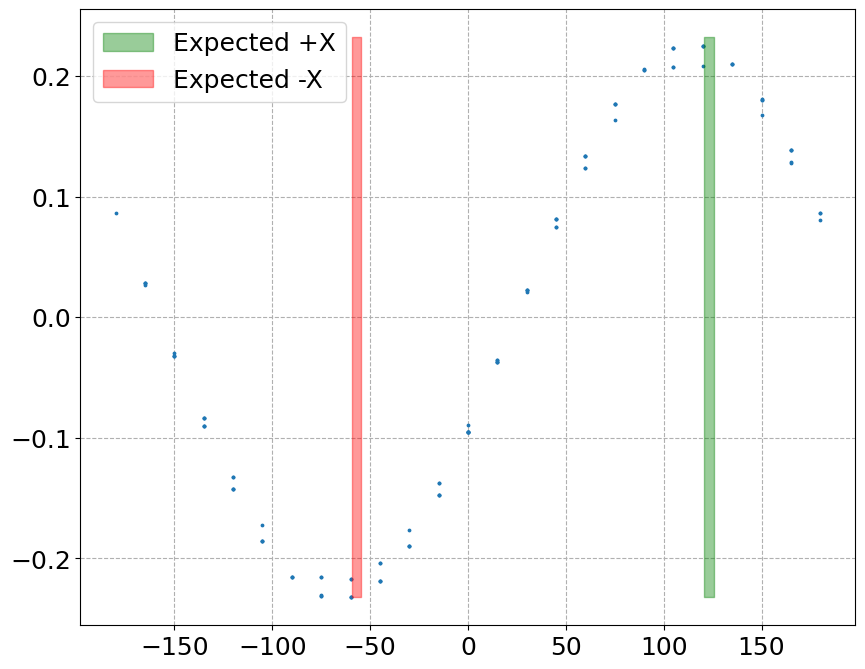

In [1032]:
fig, ax = plt.subplots()

ax.scatter(df0['SmarAct_Meas_Angle_2_Centered'], df0[f'Cal_Y'], s=3)

ax.fill_between([123.-2.5, 123.+2.5], y1=-Ymac, y2=Ymac, color='green', alpha=0.4, label='Expected +X')
ax.fill_between([-57.-2.5, -57.+2.5], y1=-Ymac, y2=Ymac, color='red', alpha=0.4, label='Expected -X')

ax.legend()

In [1011]:
np.sin(np.radians(14.)) * 0.98

0.23708345768767436

In [971]:
myHPC_deb.df_clean.query('`Magnet Current [A]` < 0')

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,EvapCoil (NWC),Barrel/Reservoir (FNAL),Return PS (FNAL),Return Magnet (NWC-R),Chiller Exhaust (NW),Supply Magnet (NWC-S),Supply PS (FNAL),has_nmr,B,B_corr
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-04-18 15:42:15,4/18/2025 3:42:15 PM,-2.864981,-3.434255,0.206128,0.0,164500.0,-52548.0,2084273.0,15052.0,-0.746921,...,21.995228,16.996518,34.684412,7.458685,28.060857,5.391895,26.121400,1.0,0.206128,0.206086
2025-04-18 15:42:27,4/18/2025 3:42:27 PM,-10.280887,-4.438477,0.175963,0.0,117240.0,-163726.0,2086616.0,15087.0,-0.747225,...,21.996434,16.997378,34.675646,7.462592,27.995313,5.387749,26.120468,1.0,0.175963,0.175921
2025-04-18 15:42:39,4/18/2025 3:42:39 PM,-17.696793,-5.442700,0.145798,0.0,19553.0,-235368.0,2088770.0,15109.0,-0.747374,...,21.997640,16.998238,34.666880,7.466499,27.929770,5.383602,26.119535,1.0,0.145798,0.145756
2025-04-18 15:42:51,4/18/2025 3:42:51 PM,-25.112699,-6.446923,0.115633,0.0,-135056.0,-334447.0,2831403.0,15131.0,-1.006007,...,21.998846,16.999098,34.658114,7.470406,27.864226,5.379456,26.118603,1.0,0.115633,0.115591
2025-04-18 15:43:03,4/18/2025 3:43:03 PM,-32.528605,-7.451146,0.085468,0.0,-377985.0,-357031.0,3767675.0,15138.0,-1.326319,...,22.000051,16.999957,34.649349,7.474313,27.798683,5.375310,26.117670,1.0,0.085468,0.085426
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-17 07:23:26,5/17/2025 7:23:26 AM,-54.423891,-6.248866,0.000000,0.0,159292.0,-154731.0,-839713.0,33184.0,0.304683,...,24.778301,22.152089,32.873679,19.545909,26.187655,18.977705,28.397092,0.0,0.314316,0.314316
2025-05-17 07:23:28,5/17/2025 7:23:28 AM,-54.423892,-6.248890,0.000000,0.0,159229.0,-154803.0,-839775.0,33178.0,0.304705,...,24.769011,22.152010,32.873488,19.552342,26.186401,18.985644,28.396759,0.0,0.314339,0.314339
2025-05-17 07:23:33,5/17/2025 7:23:33 AM,-54.423895,-6.248952,0.000000,0.0,113599.0,-181839.0,-838988.0,33198.0,0.304686,...,24.745785,22.151813,32.873010,19.568426,26.183266,19.005492,28.395924,0.0,0.314346,0.314346


In [968]:
myHPC_deb.df_clean.columns

Index(['Time', 'Magnet Current [A]', 'Magnet Voltage [V]', 'NMR [T]',
       'NMR [FFT]', '8E0000000D51483A_Raw_X', '8E0000000D51483A_Raw_Y',
       '8E0000000D51483A_Raw_Z', '8E0000000D51483A_Raw_T',
       '8E0000000D51483A_Cal_X', '8E0000000D51483A_Cal_Y',
       '8E0000000D51483A_Cal_Z', '8E0000000D51483A_Cal_T',
       'SmarAct_Pattern_Angle_1', 'SmarAct_Pattern_Angle_2',
       'SmarAct_Meas_Angle_1', 'SmarAct_Meas_Rotation_Angle_1',
       'SmarAct_Meas_Angle_2', 'SmarAct_Meas_Rotation_Angle_2',
       'seconds_delta', 'hours_delta', 'days_delta', 'run_type',
       'expected_field', 'polarity', 'chiller_temp_F',
       '8E0000000D51483A_Raw_Bmag', '8E0000000D51483A_Raw_Theta',
       '8E0000000D51483A_Raw_Phi', '8E0000000D51483A_Cal_Bmag',
       '8E0000000D51483A_Cal_Theta', '8E0000000D51483A_Cal_Phi',
       '8E0000000D51483A_Cal_Theta2', '8E0000000D51483A_Cal_Phi2',
       'Magnet Resistance [Ohm]', 'Coil Resistance [Ohm]', 'Magnet Power [W]',
       'SmarAct_Meas_Angle_1_Ce

## Sign of the motors

- Based on my geometric picture, I think we need to flip axis 2 and leave axis 1

In [1054]:
# probe Z
# field in +Z
df0 = df_d_.query(f'(-1. <= SmarAct_Meas_Angle_1_Centered <= 1.)')

In [1055]:
df0

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,has_nmr,B,B_corr,Cal_X,Cal_Y,Cal_Z,Cal_Bmag,Cal_Trans,Cal_Theta,Cal_Phi
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-05-03 01:15:37,5/3/2025 1:15:37 AM,-176.05778,-20.997871,0.983204,0.0,103676.0,80580.0,-2755024.0,20717.0,0.982475,...,1.0,0.983204,0.982854,0.015458,-0.005595,0.982475,0.982612,0.016440,0.016729,-0.347288
2025-05-03 01:15:52,5/3/2025 1:15:52 AM,-176.05778,-20.997888,0.983204,0.0,135740.0,69851.0,-2755027.0,20763.0,0.982398,...,1.0,0.983204,0.982854,0.011807,-0.017171,0.982398,0.982619,0.020839,0.021204,-0.968407
2025-05-03 01:15:55,5/3/2025 1:15:55 AM,-176.05778,-20.997891,0.983204,0.0,135770.0,69886.0,-2755014.0,20782.0,0.982401,...,1.0,0.983204,0.982854,0.011820,-0.017182,0.982401,0.982622,0.020855,0.021221,-0.968225
2025-05-03 01:16:02,5/3/2025 1:16:02 AM,-176.05778,-20.997899,0.983204,0.0,148790.0,58644.0,-2754919.0,20801.0,0.982356,...,1.0,0.983204,0.982854,0.007830,-0.021888,0.982356,0.982631,0.023247,0.023653,-1.227233
2025-05-03 01:16:04,5/3/2025 1:16:04 AM,-176.05778,-20.997901,0.983204,0.0,148812.0,58537.0,-2754987.0,20806.0,0.982382,...,1.0,0.983204,0.982854,0.007791,-0.021895,0.982382,0.982657,0.023240,0.023646,-1.228930
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-03 01:27:47,5/3/2025 1:27:47 AM,-176.05778,-21.000004,0.983196,0.0,131113.0,5894.0,-2754389.0,20979.0,0.982472,...,1.0,0.983196,0.982846,-0.011525,-0.015555,0.982472,0.982662,0.019360,0.019699,-2.208463
2025-05-03 01:27:52,5/3/2025 1:27:52 AM,-176.05778,-21.000027,0.983196,0.0,127572.0,-1576.0,-2754237.0,20933.0,0.982437,...,1.0,0.983196,0.982846,-0.014272,-0.014283,0.982437,0.982644,0.020191,0.020545,-2.355781
2025-05-03 01:27:53,5/3/2025 1:27:53 AM,-176.05778,-21.000032,0.983196,0.0,127571.0,-1550.0,-2754238.0,20924.0,0.982434,...,1.0,0.983196,0.982846,-0.014262,-0.014283,0.982434,0.982641,0.020184,0.020538,-2.355458


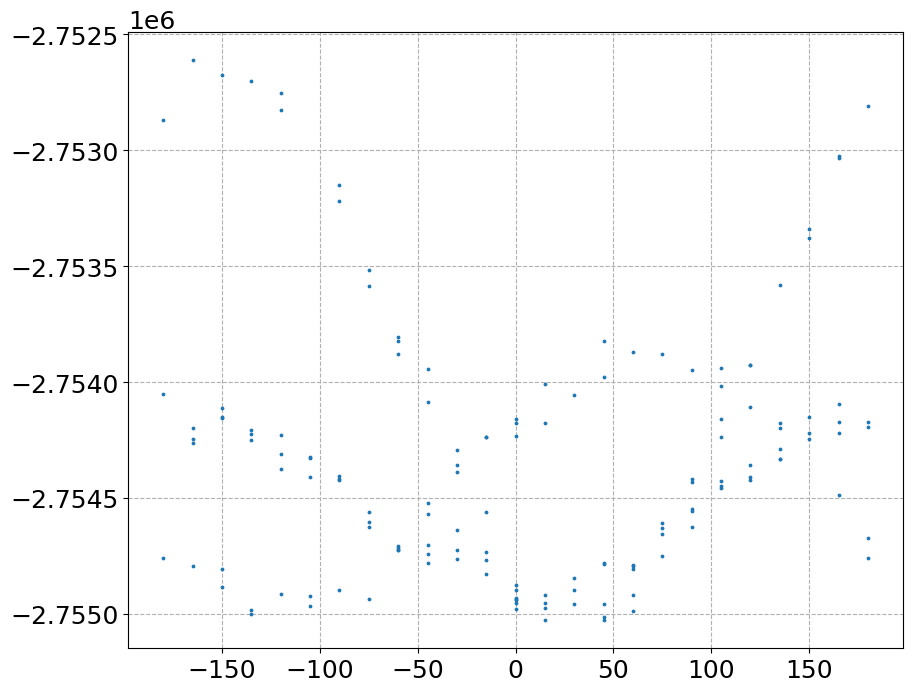

In [1003]:
fig, ax = plt.subplots()

ax.scatter(df0['SmarAct_Meas_Angle_2_Centered'], df0[f'{probe}_Raw_Z'], s=3)

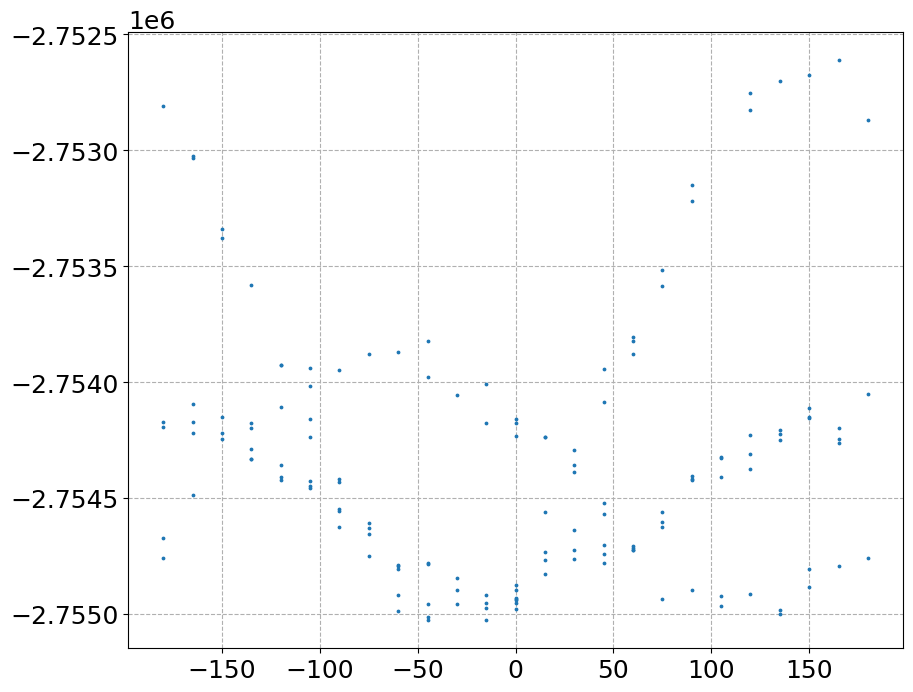

In [1057]:
fig, ax = plt.subplots()

ax.scatter(-df0['SmarAct_Meas_Angle_2_Centered'], df0[f'{probe}_Raw_Z'], s=3)

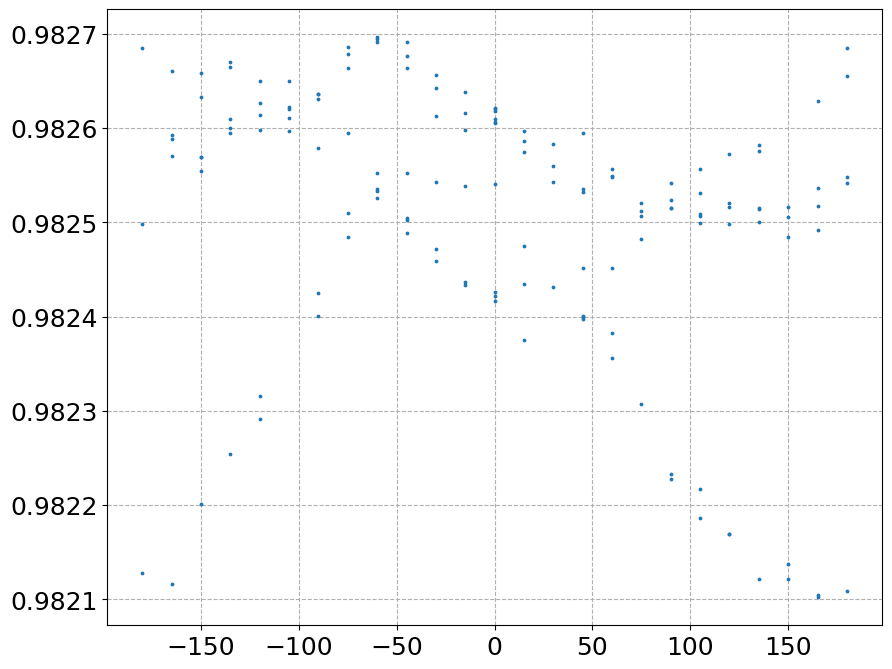

In [1004]:
fig, ax = plt.subplots()

ax.scatter(df0['SmarAct_Meas_Angle_2_Centered'], df0[f'Cal_Z'], s=3)

In [1058]:
# probe Y (x coord)
# field in -X at ~33 deg (SA2), +X at ~ -147 deg (SA2)
df0 = df_d_.query(f'(13. <= SmarAct_Meas_Angle_1_Centered)')

In [1059]:
df0

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,has_nmr,B,B_corr,Cal_X,Cal_Y,Cal_Z,Cal_Bmag,Cal_Trans,Cal_Theta,Cal_Phi
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-05-03 02:20:13,5/3/2025 2:20:13 AM,-176.058107,-21.001721,0.983164,0.0,181937.0,-569260.0,-2677084.0,20754.0,0.957053,...,1.0,0.983164,0.982814,-0.220037,-0.035233,0.957053,0.982654,0.222840,0.223002,-2.982817
2025-05-03 02:20:15,5/3/2025 2:20:15 AM,-176.058106,-21.001727,0.983164,0.0,181919.0,-569234.0,-2677076.0,20748.0,0.957048,...,1.0,0.983164,0.982814,-0.220027,-0.035227,0.957048,0.982646,0.222829,0.222993,-2.982839
2025-05-03 02:20:25,5/3/2025 2:20:25 AM,-176.058105,-21.001761,0.983164,0.0,26643.0,-568236.0,-2676013.0,20744.0,0.957290,...,1.0,0.983164,0.982814,-0.220903,0.020774,0.957290,0.982666,0.221878,0.222068,3.047828
2025-05-03 02:20:30,5/3/2025 2:20:30 AM,-176.058104,-21.001778,0.983164,0.0,-123524.0,-527111.0,-2675783.0,20743.0,0.957666,...,1.0,0.983164,0.982814,-0.207168,0.074979,0.957666,0.982682,0.220319,0.220554,2.794338
2025-05-03 02:20:33,5/3/2025 2:20:33 AM,-176.058103,-21.001788,0.983164,0.0,-123500.0,-527067.0,-2675648.0,20745.0,0.957619,...,1.0,0.983164,0.982814,-0.207152,0.074968,0.957619,0.982633,0.220300,0.220547,2.794355
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-03 02:27:55,5/3/2025 2:27:55 AM,-176.058063,-21.004060,0.983161,0.0,492570.0,-491469.0,-2669550.0,20912.0,0.952980,...,1.0,0.983161,0.982811,-0.189281,-0.147247,0.952980,0.982690,0.239810,0.239356,-2.480458
2025-05-03 02:27:56,5/3/2025 2:27:56 AM,-176.058063,-21.004066,0.983161,0.0,492565.0,-491524.0,-2669504.0,20915.0,0.952965,...,1.0,0.983161,0.982811,-0.189301,-0.147246,0.952965,0.982679,0.239825,0.239373,-2.480513
2025-05-03 02:28:01,5/3/2025 2:28:01 AM,-176.058063,-21.004100,0.983161,0.0,348464.0,-573290.0,-2666979.0,20884.0,0.952924,...,1.0,0.983161,0.982811,-0.220145,-0.095411,0.952924,0.982665,0.239931,0.239478,-2.732627


In [1060]:
#Yma = df0[f'{probe}_Raw_X'].abs().max()
Yma = df0[f'{probe}_Raw_Y'].abs().max()
Yma

646323.0

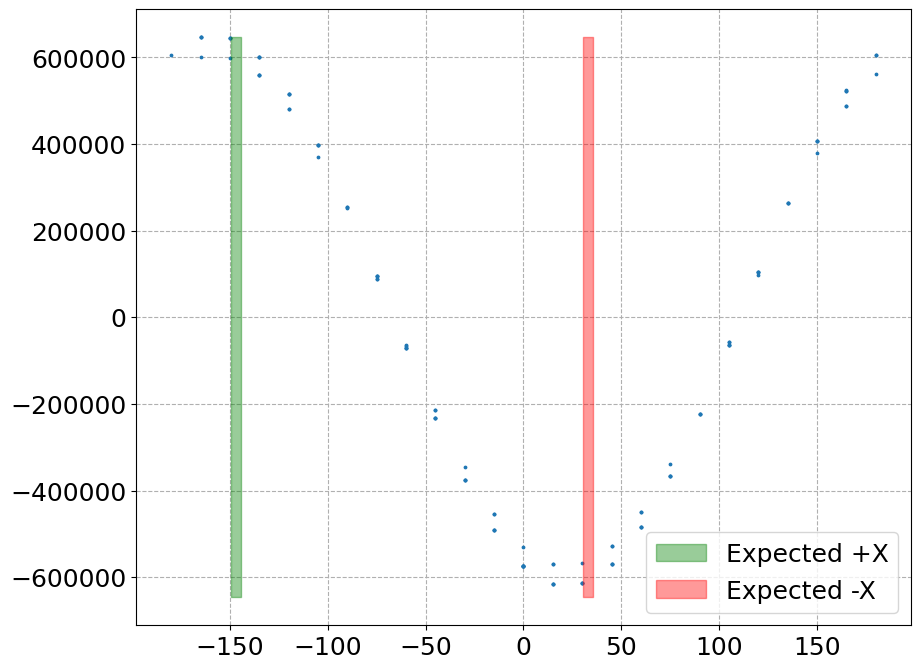

In [1061]:
fig, ax = plt.subplots()

ax.scatter(df0['SmarAct_Meas_Angle_2_Centered'], df0[f'{probe}_Raw_Y'], s=3)


ax.fill_between([-147-2.5, -147+2.5], y1=-Yma, y2=Yma, color='green', alpha=0.4, label='Expected +X')
ax.fill_between([33-2.5, 33+2.5], y1=-Yma, y2=Yma, color='red', alpha=0.4, label='Expected -X')

ax.legend()

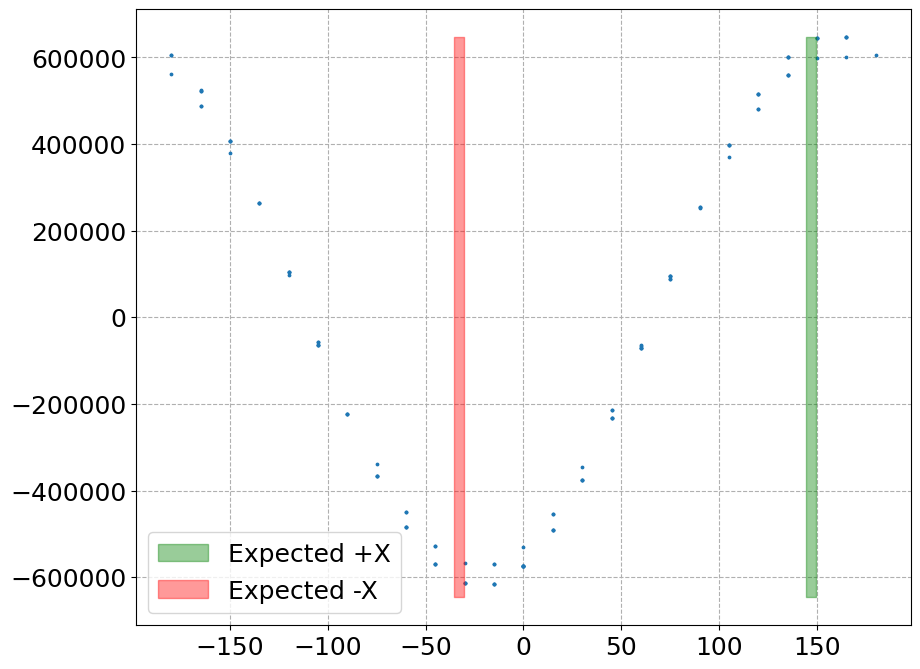

In [1062]:
fig, ax = plt.subplots()

ax.scatter(-df0['SmarAct_Meas_Angle_2_Centered'], df0[f'{probe}_Raw_Y'], s=3)


ax.fill_between([147-2.5, 147+2.5], y1=-Yma, y2=Yma, color='green', alpha=0.4, label='Expected +X')
ax.fill_between([-33-2.5, -33+2.5], y1=-Yma, y2=Yma, color='red', alpha=0.4, label='Expected -X')

ax.legend()

In [1063]:
#Yma = df0[f'{probe}_Raw_X'].abs().max()
Ymac = df0['Cal_X'].abs().max()
Ymac

0.237288116

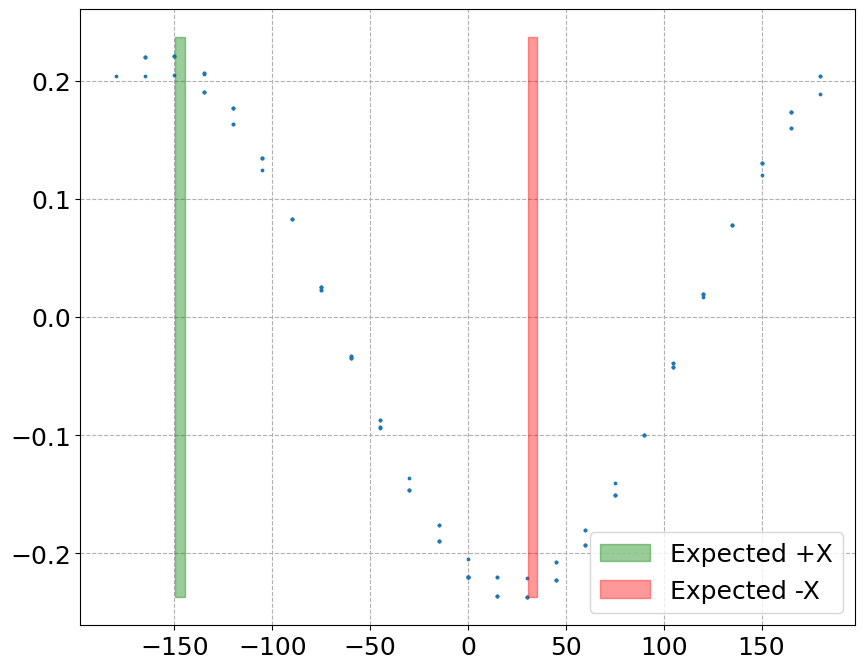

In [1064]:
fig, ax = plt.subplots()

ax.scatter(df0['SmarAct_Meas_Angle_2_Centered'], df0[f'Cal_X'], s=3)

ax.fill_between([-147-2.5, -147+2.5], y1=-Ymac, y2=Ymac, color='green', alpha=0.4, label='Expected +X')
ax.fill_between([33-2.5, 33+2.5], y1=-Ymac, y2=Ymac, color='red', alpha=0.4, label='Expected -X')

ax.legend()

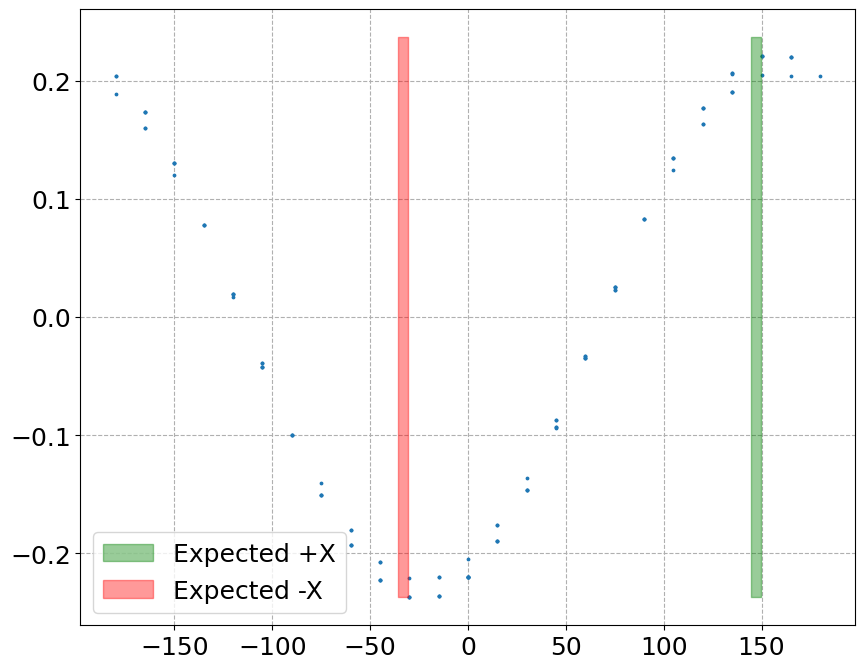

In [1065]:
fig, ax = plt.subplots()

ax.scatter(-df0['SmarAct_Meas_Angle_2_Centered'], df0[f'Cal_X'], s=3)

ax.fill_between([147-2.5, 147+2.5], y1=-Ymac, y2=Ymac, color='green', alpha=0.4, label='Expected +X')
ax.fill_between([-33-2.5, -33+2.5], y1=-Ymac, y2=Ymac, color='red', alpha=0.4, label='Expected -X')

ax.legend()

In [1066]:
# probe X (y coord)
# field in +Y at 90 + 33 deg = 123 (SA2), -Y at 270 + 33 deg = 303 deg = -57 deg (SA2)
df0 = df_d_.query(f'(13. <= SmarAct_Meas_Angle_1_Centered)')

In [1067]:
df0

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],8E0000000D51483A_Raw_X,8E0000000D51483A_Raw_Y,8E0000000D51483A_Raw_Z,8E0000000D51483A_Raw_T,8E0000000D51483A_Cal_X,...,has_nmr,B,B_corr,Cal_X,Cal_Y,Cal_Z,Cal_Bmag,Cal_Trans,Cal_Theta,Cal_Phi
Datetime,,,,,,,,,,,,,,,,,,,,,
2025-05-03 02:20:13,5/3/2025 2:20:13 AM,-176.058107,-21.001721,0.983164,0.0,181937.0,-569260.0,-2677084.0,20754.0,0.957053,...,1.0,0.983164,0.982814,-0.220037,-0.035233,0.957053,0.982654,0.222840,0.223002,-2.982817
2025-05-03 02:20:15,5/3/2025 2:20:15 AM,-176.058106,-21.001727,0.983164,0.0,181919.0,-569234.0,-2677076.0,20748.0,0.957048,...,1.0,0.983164,0.982814,-0.220027,-0.035227,0.957048,0.982646,0.222829,0.222993,-2.982839
2025-05-03 02:20:25,5/3/2025 2:20:25 AM,-176.058105,-21.001761,0.983164,0.0,26643.0,-568236.0,-2676013.0,20744.0,0.957290,...,1.0,0.983164,0.982814,-0.220903,0.020774,0.957290,0.982666,0.221878,0.222068,3.047828
2025-05-03 02:20:30,5/3/2025 2:20:30 AM,-176.058104,-21.001778,0.983164,0.0,-123524.0,-527111.0,-2675783.0,20743.0,0.957666,...,1.0,0.983164,0.982814,-0.207168,0.074979,0.957666,0.982682,0.220319,0.220554,2.794338
2025-05-03 02:20:33,5/3/2025 2:20:33 AM,-176.058103,-21.001788,0.983164,0.0,-123500.0,-527067.0,-2675648.0,20745.0,0.957619,...,1.0,0.983164,0.982814,-0.207152,0.074968,0.957619,0.982633,0.220300,0.220547,2.794355
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-03 02:27:55,5/3/2025 2:27:55 AM,-176.058063,-21.004060,0.983161,0.0,492570.0,-491469.0,-2669550.0,20912.0,0.952980,...,1.0,0.983161,0.982811,-0.189281,-0.147247,0.952980,0.982690,0.239810,0.239356,-2.480458
2025-05-03 02:27:56,5/3/2025 2:27:56 AM,-176.058063,-21.004066,0.983161,0.0,492565.0,-491524.0,-2669504.0,20915.0,0.952965,...,1.0,0.983161,0.982811,-0.189301,-0.147246,0.952965,0.982679,0.239825,0.239373,-2.480513
2025-05-03 02:28:01,5/3/2025 2:28:01 AM,-176.058063,-21.004100,0.983161,0.0,348464.0,-573290.0,-2666979.0,20884.0,0.952924,...,1.0,0.983161,0.982811,-0.220145,-0.095411,0.952924,0.982665,0.239931,0.239478,-2.732627


In [1068]:
Yma = df0[f'{probe}_Raw_X'].abs().max()
# Yma = df0[f'{probe}_Raw_Y'].abs().max()
Yma

729848.0

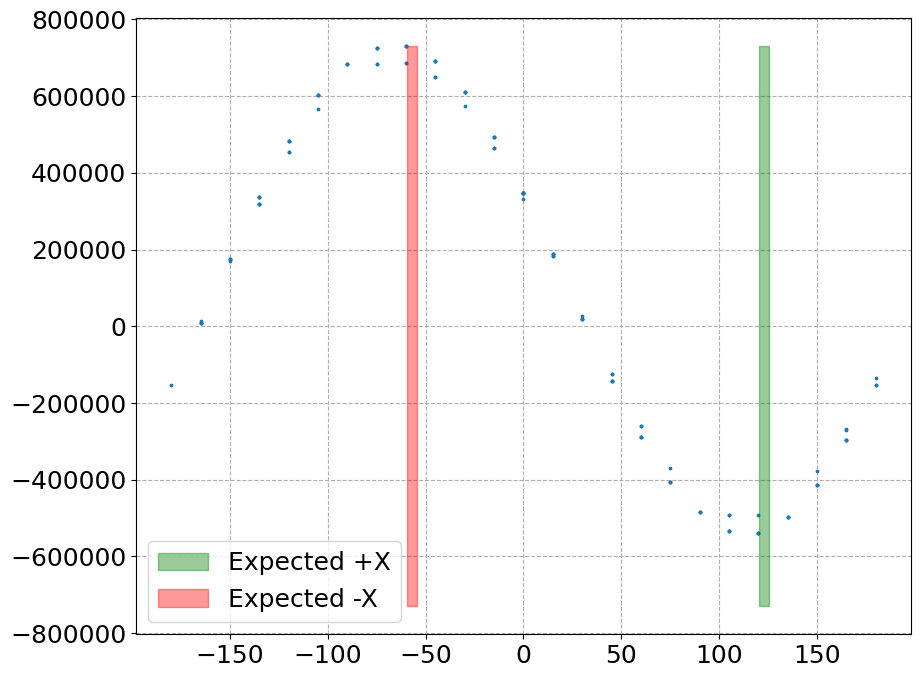

In [1069]:
fig, ax = plt.subplots()

ax.scatter(df0['SmarAct_Meas_Angle_2_Centered'], df0[f'{probe}_Raw_X'], s=3)


ax.fill_between([123.-2.5, 123.+2.5], y1=-Yma, y2=Yma, color='green', alpha=0.4, label='Expected +X')
ax.fill_between([-57.-2.5, -57.+2.5], y1=-Yma, y2=Yma, color='red', alpha=0.4, label='Expected -X')

ax.legend()

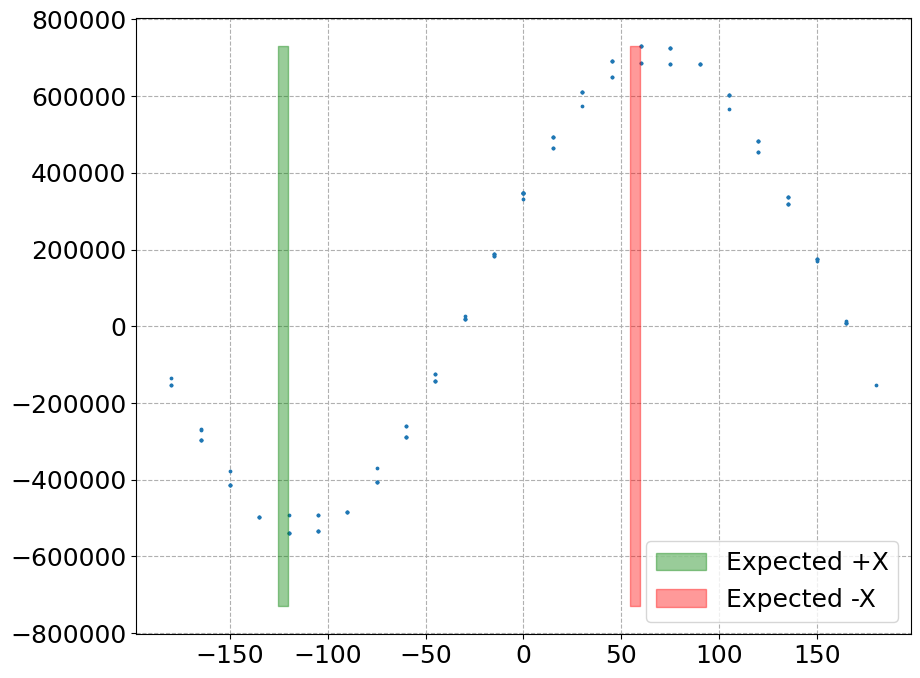

In [1070]:
fig, ax = plt.subplots()

ax.scatter(-df0['SmarAct_Meas_Angle_2_Centered'], df0[f'{probe}_Raw_X'], s=3)


ax.fill_between([-123.-2.5, -123.+2.5], y1=-Yma, y2=Yma, color='green', alpha=0.4, label='Expected +X')
ax.fill_between([57.-2.5, 57.+2.5], y1=-Yma, y2=Yma, color='red', alpha=0.4, label='Expected -X')

ax.legend()

In [1071]:
Ymac = df0['Cal_Y'].abs().max()
Ymac

0.232223697

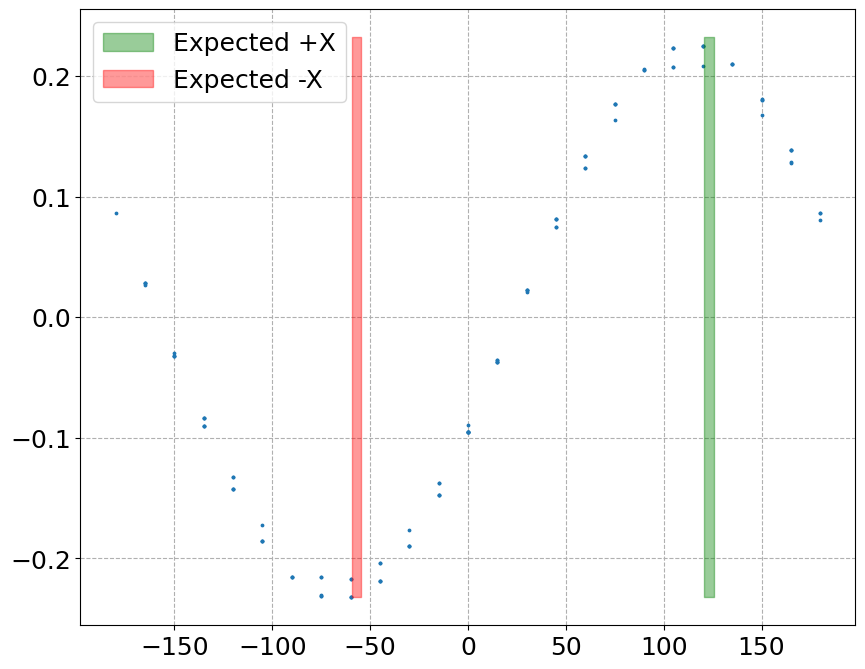

In [1072]:
fig, ax = plt.subplots()

ax.scatter(df0['SmarAct_Meas_Angle_2_Centered'], df0[f'Cal_Y'], s=3)

ax.fill_between([123.-2.5, 123.+2.5], y1=-Ymac, y2=Ymac, color='green', alpha=0.4, label='Expected +X')
ax.fill_between([-57.-2.5, -57.+2.5], y1=-Ymac, y2=Ymac, color='red', alpha=0.4, label='Expected -X')

ax.legend()

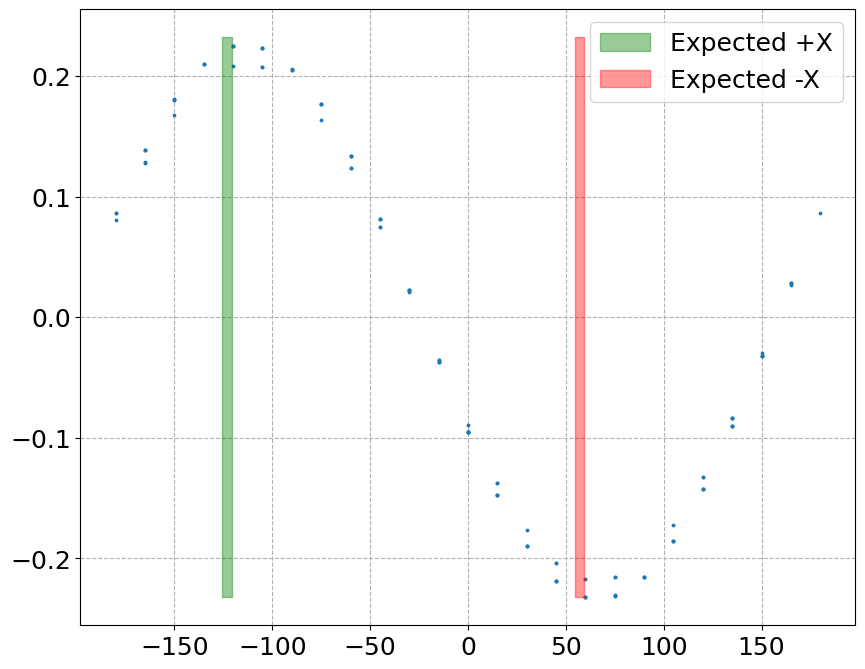

In [1073]:
fig, ax = plt.subplots()

ax.scatter(-df0['SmarAct_Meas_Angle_2_Centered'], df0[f'Cal_Y'], s=3)

ax.fill_between([-123.-2.5, -123.+2.5], y1=-Ymac, y2=Ymac, color='green', alpha=0.4, label='Expected +X')
ax.fill_between([57.-2.5, 57.+2.5], y1=-Ymac, y2=Ymac, color='red', alpha=0.4, label='Expected -X')

ax.legend()